# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [01:13, 2.48MB/s]                              
SVHN Testing Set: 64.3MB [04:12, 254KB/s]                                


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

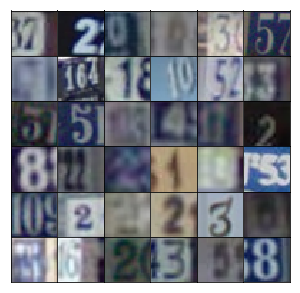

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4 * 4 * 512)
        # project and reshape
        x1 = tf.reshape(x1, (-1,4,4,512))
        x1 = tf.layers.batch_normalization(x1, training = training)
        x1 = tf.maximum(x1 * alpha, x1)
        # now 4x4x512
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides = 2, padding = 'same')
        x2 = tf.layers.batch_normalization(x2, training = training)
        x2 = tf.maximum(x2 * alpha, x2)
        # now 8x8x256
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides = 2, padding = 'same')
        x3 = tf.layers.batch_normalization(x3, training = training)
        x3 = tf.maximum(x3 * alpha, x3)
        # now 16x16x128
        
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides = 2, padding = 'same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        # no batch norm on first layer
        x1 = tf.layers.conv2d(x, 64, 5, strides = 2, padding = 'same')
        x1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(x1, 128, 5, strides = 2, padding = 'same')
        x2 = tf.layers.batch_normalization(x2, training = False)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(x2, 256, 5, strides = 2, padding = 'same')
        x3 = tf.layers.batch_normalization(x3, training = False)
        x3 = tf.maximum(alpha * x3, x3)
        # 4x4x256
        
        # flatten
        flat = tf.reshape(x3, (-1, 4*4*256))
        logits = tf.layers.dense(flat,1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [18]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.2487... Generator Loss: 0.7154
Epoch 1/25... Discriminator Loss: 0.6123... Generator Loss: 1.6240
Epoch 1/25... Discriminator Loss: 0.8000... Generator Loss: 1.9028
Epoch 1/25... Discriminator Loss: 0.7773... Generator Loss: 1.5791
Epoch 1/25... Discriminator Loss: 0.4993... Generator Loss: 1.7064
Epoch 1/25... Discriminator Loss: 0.9840... Generator Loss: 1.1162
Epoch 1/25... Discriminator Loss: 1.5113... Generator Loss: 0.6938
Epoch 1/25... Discriminator Loss: 1.6298... Generator Loss: 0.5550
Epoch 1/25... Discriminator Loss: 1.3958... Generator Loss: 0.6495
Epoch 1/25... Discriminator Loss: 1.2387... Generator Loss: 0.7086


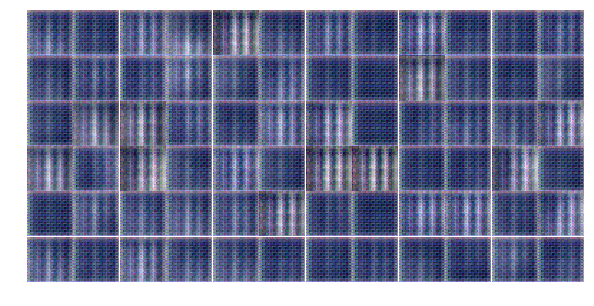

Epoch 1/25... Discriminator Loss: 1.3816... Generator Loss: 0.5641
Epoch 1/25... Discriminator Loss: 1.1329... Generator Loss: 0.7513
Epoch 1/25... Discriminator Loss: 1.3209... Generator Loss: 0.6962
Epoch 1/25... Discriminator Loss: 1.3231... Generator Loss: 0.8603
Epoch 1/25... Discriminator Loss: 1.4269... Generator Loss: 0.7284
Epoch 1/25... Discriminator Loss: 1.2144... Generator Loss: 0.8205
Epoch 1/25... Discriminator Loss: 1.4378... Generator Loss: 0.7297
Epoch 1/25... Discriminator Loss: 1.1480... Generator Loss: 0.8228
Epoch 1/25... Discriminator Loss: 1.3400... Generator Loss: 0.8239
Epoch 1/25... Discriminator Loss: 1.1864... Generator Loss: 0.8154


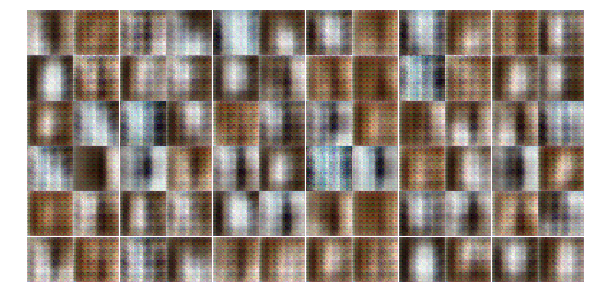

Epoch 1/25... Discriminator Loss: 1.3776... Generator Loss: 0.7599
Epoch 1/25... Discriminator Loss: 1.4516... Generator Loss: 0.6216
Epoch 1/25... Discriminator Loss: 1.4110... Generator Loss: 0.7745
Epoch 1/25... Discriminator Loss: 1.1298... Generator Loss: 0.8130
Epoch 1/25... Discriminator Loss: 1.2203... Generator Loss: 0.7995
Epoch 1/25... Discriminator Loss: 1.1782... Generator Loss: 0.8868
Epoch 1/25... Discriminator Loss: 1.4277... Generator Loss: 0.6514
Epoch 1/25... Discriminator Loss: 1.2596... Generator Loss: 0.8543
Epoch 1/25... Discriminator Loss: 1.3233... Generator Loss: 0.8160
Epoch 1/25... Discriminator Loss: 1.3380... Generator Loss: 0.7627


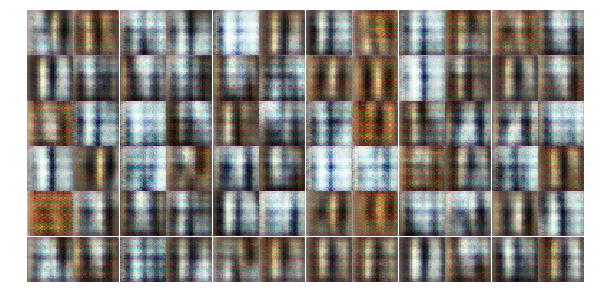

Epoch 1/25... Discriminator Loss: 1.2116... Generator Loss: 0.6884
Epoch 1/25... Discriminator Loss: 1.3057... Generator Loss: 0.8212
Epoch 1/25... Discriminator Loss: 1.3307... Generator Loss: 0.7714
Epoch 1/25... Discriminator Loss: 1.2602... Generator Loss: 0.7565
Epoch 1/25... Discriminator Loss: 1.2621... Generator Loss: 0.8436
Epoch 1/25... Discriminator Loss: 1.3925... Generator Loss: 0.7340
Epoch 1/25... Discriminator Loss: 1.3048... Generator Loss: 0.7460
Epoch 1/25... Discriminator Loss: 1.3748... Generator Loss: 0.7181
Epoch 1/25... Discriminator Loss: 1.2982... Generator Loss: 0.6719
Epoch 1/25... Discriminator Loss: 1.2350... Generator Loss: 0.8652


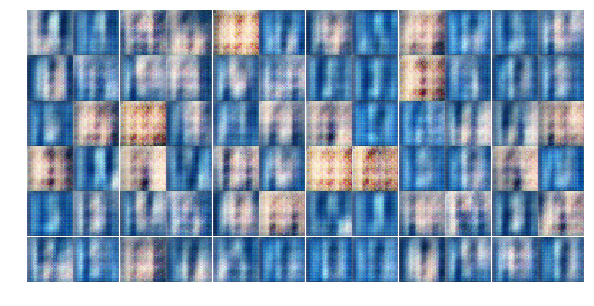

Epoch 1/25... Discriminator Loss: 1.3622... Generator Loss: 0.7385
Epoch 1/25... Discriminator Loss: 1.1384... Generator Loss: 0.7981
Epoch 1/25... Discriminator Loss: 1.3734... Generator Loss: 0.9231
Epoch 1/25... Discriminator Loss: 1.2604... Generator Loss: 0.7698
Epoch 1/25... Discriminator Loss: 1.3910... Generator Loss: 0.7077
Epoch 1/25... Discriminator Loss: 1.3737... Generator Loss: 0.6637
Epoch 1/25... Discriminator Loss: 1.4837... Generator Loss: 0.6837
Epoch 1/25... Discriminator Loss: 1.1742... Generator Loss: 0.8121
Epoch 1/25... Discriminator Loss: 1.3596... Generator Loss: 0.6866
Epoch 1/25... Discriminator Loss: 1.1180... Generator Loss: 0.9915


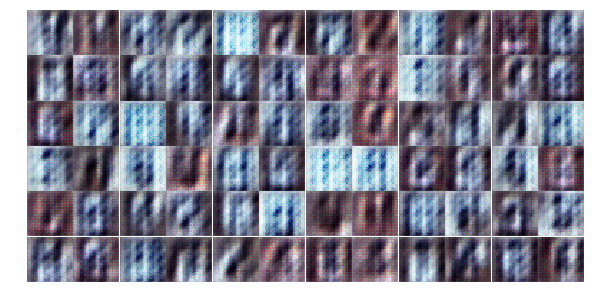

Epoch 1/25... Discriminator Loss: 1.3104... Generator Loss: 0.8052
Epoch 1/25... Discriminator Loss: 1.4125... Generator Loss: 0.7335
Epoch 1/25... Discriminator Loss: 1.2511... Generator Loss: 0.6860
Epoch 1/25... Discriminator Loss: 1.4110... Generator Loss: 0.7271
Epoch 1/25... Discriminator Loss: 1.2753... Generator Loss: 0.6982
Epoch 1/25... Discriminator Loss: 1.3222... Generator Loss: 0.7004
Epoch 1/25... Discriminator Loss: 1.4216... Generator Loss: 0.7643
Epoch 2/25... Discriminator Loss: 1.2769... Generator Loss: 0.7144
Epoch 2/25... Discriminator Loss: 1.2340... Generator Loss: 0.6692
Epoch 2/25... Discriminator Loss: 1.4157... Generator Loss: 0.8186


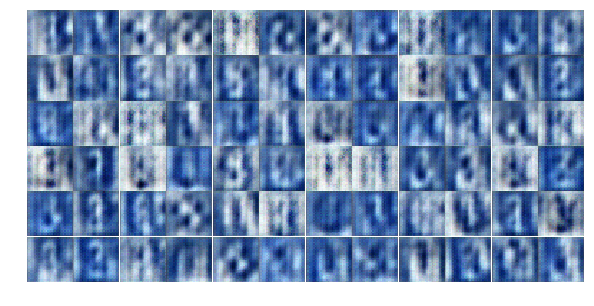

Epoch 2/25... Discriminator Loss: 1.2774... Generator Loss: 0.7146
Epoch 2/25... Discriminator Loss: 1.3680... Generator Loss: 0.6838
Epoch 2/25... Discriminator Loss: 1.2919... Generator Loss: 0.7741
Epoch 2/25... Discriminator Loss: 1.3243... Generator Loss: 0.8394
Epoch 2/25... Discriminator Loss: 1.3091... Generator Loss: 0.7450
Epoch 2/25... Discriminator Loss: 1.2977... Generator Loss: 0.6797
Epoch 2/25... Discriminator Loss: 1.3512... Generator Loss: 0.7546
Epoch 2/25... Discriminator Loss: 1.3427... Generator Loss: 0.7624
Epoch 2/25... Discriminator Loss: 1.2379... Generator Loss: 0.7276
Epoch 2/25... Discriminator Loss: 1.4606... Generator Loss: 0.7048


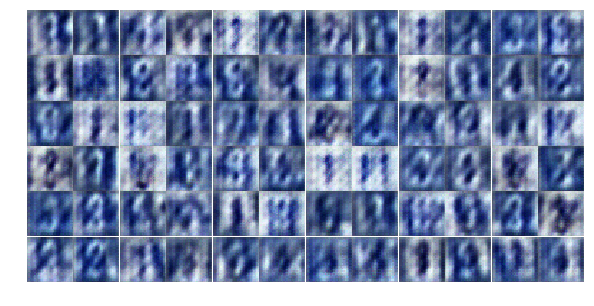

Epoch 2/25... Discriminator Loss: 1.2776... Generator Loss: 0.7562
Epoch 2/25... Discriminator Loss: 1.3137... Generator Loss: 0.7179
Epoch 2/25... Discriminator Loss: 1.4151... Generator Loss: 0.7708
Epoch 2/25... Discriminator Loss: 1.1902... Generator Loss: 0.8202
Epoch 2/25... Discriminator Loss: 1.2332... Generator Loss: 0.7960
Epoch 2/25... Discriminator Loss: 1.3847... Generator Loss: 0.7233
Epoch 2/25... Discriminator Loss: 1.3066... Generator Loss: 0.9323
Epoch 2/25... Discriminator Loss: 1.2991... Generator Loss: 0.8670
Epoch 2/25... Discriminator Loss: 1.4152... Generator Loss: 0.7142
Epoch 2/25... Discriminator Loss: 1.1403... Generator Loss: 0.7606


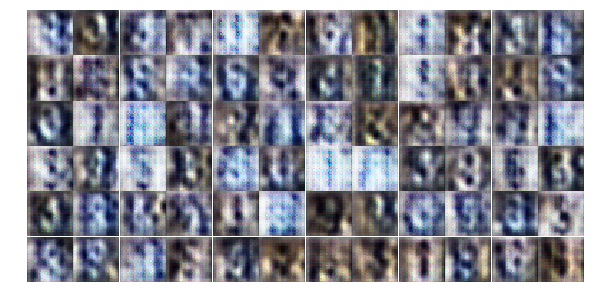

Epoch 2/25... Discriminator Loss: 1.0387... Generator Loss: 0.8496
Epoch 2/25... Discriminator Loss: 1.1990... Generator Loss: 0.7232
Epoch 2/25... Discriminator Loss: 1.1992... Generator Loss: 0.9048
Epoch 2/25... Discriminator Loss: 1.3374... Generator Loss: 0.6948
Epoch 2/25... Discriminator Loss: 1.1097... Generator Loss: 0.7883
Epoch 2/25... Discriminator Loss: 1.1523... Generator Loss: 0.9681
Epoch 2/25... Discriminator Loss: 1.4039... Generator Loss: 0.8842
Epoch 2/25... Discriminator Loss: 1.3515... Generator Loss: 0.7701
Epoch 2/25... Discriminator Loss: 1.3286... Generator Loss: 0.6769
Epoch 2/25... Discriminator Loss: 1.2317... Generator Loss: 0.6712


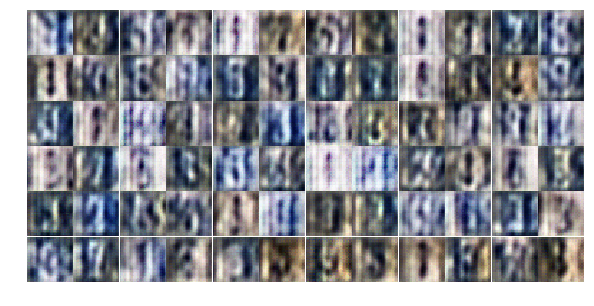

Epoch 2/25... Discriminator Loss: 1.1969... Generator Loss: 0.8422
Epoch 2/25... Discriminator Loss: 1.3213... Generator Loss: 0.7619
Epoch 2/25... Discriminator Loss: 1.0650... Generator Loss: 0.9350
Epoch 2/25... Discriminator Loss: 1.2467... Generator Loss: 0.7076
Epoch 2/25... Discriminator Loss: 0.9338... Generator Loss: 1.0032
Epoch 2/25... Discriminator Loss: 1.0023... Generator Loss: 0.8307
Epoch 2/25... Discriminator Loss: 1.3704... Generator Loss: 0.7739
Epoch 2/25... Discriminator Loss: 1.2202... Generator Loss: 0.6978
Epoch 2/25... Discriminator Loss: 1.2184... Generator Loss: 0.8568
Epoch 2/25... Discriminator Loss: 1.7027... Generator Loss: 0.5547


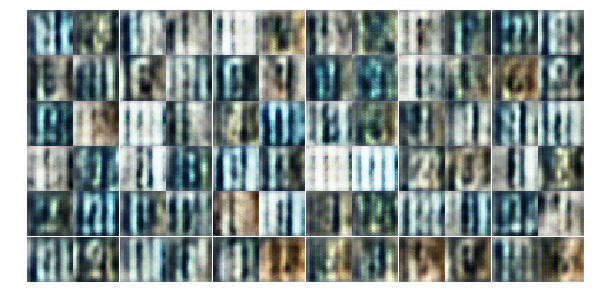

Epoch 2/25... Discriminator Loss: 1.2769... Generator Loss: 0.7444
Epoch 2/25... Discriminator Loss: 1.1621... Generator Loss: 0.7798
Epoch 2/25... Discriminator Loss: 1.1582... Generator Loss: 0.9387
Epoch 2/25... Discriminator Loss: 1.2568... Generator Loss: 0.8562
Epoch 2/25... Discriminator Loss: 1.3573... Generator Loss: 0.6339
Epoch 2/25... Discriminator Loss: 1.2259... Generator Loss: 0.8233
Epoch 2/25... Discriminator Loss: 1.3950... Generator Loss: 0.9181
Epoch 2/25... Discriminator Loss: 1.3216... Generator Loss: 0.8515
Epoch 2/25... Discriminator Loss: 1.3451... Generator Loss: 0.7214
Epoch 2/25... Discriminator Loss: 1.2639... Generator Loss: 0.7467


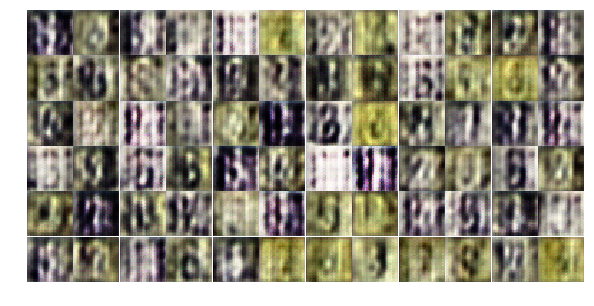

Epoch 2/25... Discriminator Loss: 1.4348... Generator Loss: 0.8627
Epoch 2/25... Discriminator Loss: 1.3509... Generator Loss: 0.7949
Epoch 2/25... Discriminator Loss: 1.3717... Generator Loss: 0.6453
Epoch 2/25... Discriminator Loss: 1.3305... Generator Loss: 0.8207
Epoch 3/25... Discriminator Loss: 1.3660... Generator Loss: 0.6925
Epoch 3/25... Discriminator Loss: 1.4113... Generator Loss: 0.7073
Epoch 3/25... Discriminator Loss: 1.3075... Generator Loss: 0.7833
Epoch 3/25... Discriminator Loss: 1.3556... Generator Loss: 0.7045
Epoch 3/25... Discriminator Loss: 1.3597... Generator Loss: 0.7158
Epoch 3/25... Discriminator Loss: 1.3667... Generator Loss: 0.7571


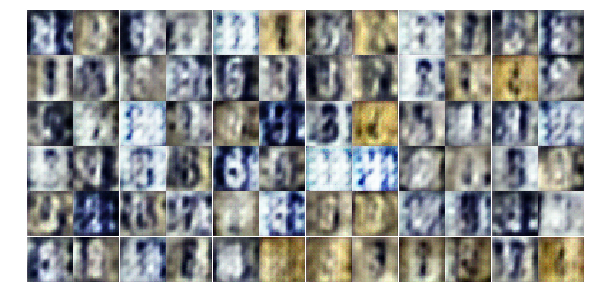

Epoch 3/25... Discriminator Loss: 1.3304... Generator Loss: 0.7933
Epoch 3/25... Discriminator Loss: 1.3773... Generator Loss: 0.7234
Epoch 3/25... Discriminator Loss: 1.3420... Generator Loss: 0.6818
Epoch 3/25... Discriminator Loss: 1.1629... Generator Loss: 0.8023
Epoch 3/25... Discriminator Loss: 1.4663... Generator Loss: 0.8117
Epoch 3/25... Discriminator Loss: 1.3473... Generator Loss: 0.7541
Epoch 3/25... Discriminator Loss: 1.3282... Generator Loss: 0.7244
Epoch 3/25... Discriminator Loss: 1.3510... Generator Loss: 0.7218
Epoch 3/25... Discriminator Loss: 1.5007... Generator Loss: 0.5739
Epoch 3/25... Discriminator Loss: 1.3096... Generator Loss: 0.7596


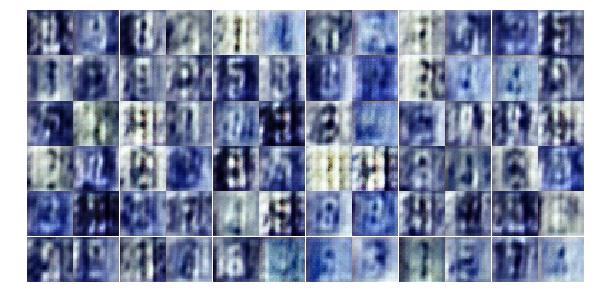

Epoch 3/25... Discriminator Loss: 1.4140... Generator Loss: 0.8188
Epoch 3/25... Discriminator Loss: 1.3576... Generator Loss: 0.7409
Epoch 3/25... Discriminator Loss: 1.2946... Generator Loss: 0.7185
Epoch 3/25... Discriminator Loss: 1.3601... Generator Loss: 0.6749
Epoch 3/25... Discriminator Loss: 1.3017... Generator Loss: 0.7424
Epoch 3/25... Discriminator Loss: 1.4067... Generator Loss: 0.7341
Epoch 3/25... Discriminator Loss: 1.3685... Generator Loss: 0.7645
Epoch 3/25... Discriminator Loss: 1.4044... Generator Loss: 0.7073
Epoch 3/25... Discriminator Loss: 1.3412... Generator Loss: 0.7257
Epoch 3/25... Discriminator Loss: 1.2327... Generator Loss: 0.8059


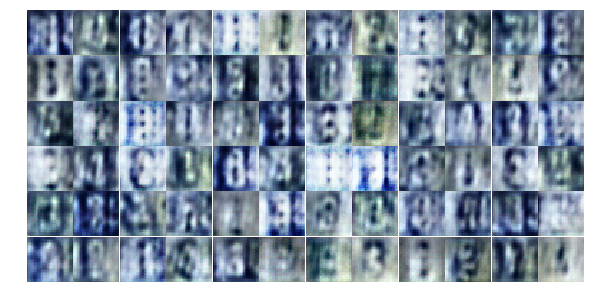

Epoch 3/25... Discriminator Loss: 1.4599... Generator Loss: 0.6423
Epoch 3/25... Discriminator Loss: 1.2753... Generator Loss: 0.7947
Epoch 3/25... Discriminator Loss: 1.3437... Generator Loss: 0.8320
Epoch 3/25... Discriminator Loss: 1.3235... Generator Loss: 0.6512
Epoch 3/25... Discriminator Loss: 1.2629... Generator Loss: 0.9246
Epoch 3/25... Discriminator Loss: 1.3233... Generator Loss: 0.7931
Epoch 3/25... Discriminator Loss: 1.2550... Generator Loss: 0.8264
Epoch 3/25... Discriminator Loss: 1.3180... Generator Loss: 0.8063
Epoch 3/25... Discriminator Loss: 1.4465... Generator Loss: 0.6543
Epoch 3/25... Discriminator Loss: 1.3438... Generator Loss: 0.7980


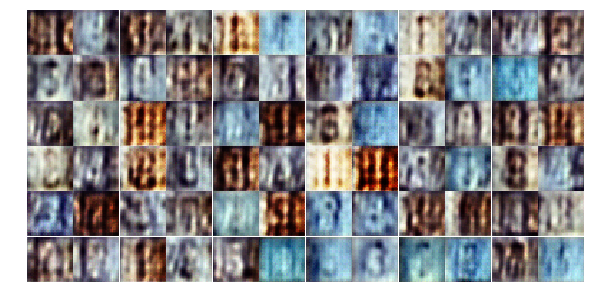

Epoch 3/25... Discriminator Loss: 1.3740... Generator Loss: 0.7100
Epoch 3/25... Discriminator Loss: 1.3543... Generator Loss: 0.7565
Epoch 3/25... Discriminator Loss: 1.3711... Generator Loss: 0.7244
Epoch 3/25... Discriminator Loss: 1.3889... Generator Loss: 0.6833
Epoch 3/25... Discriminator Loss: 1.3049... Generator Loss: 0.6983
Epoch 3/25... Discriminator Loss: 1.3360... Generator Loss: 0.6676
Epoch 3/25... Discriminator Loss: 1.3850... Generator Loss: 0.7271
Epoch 3/25... Discriminator Loss: 1.4380... Generator Loss: 0.6597
Epoch 3/25... Discriminator Loss: 1.1997... Generator Loss: 0.7216
Epoch 3/25... Discriminator Loss: 1.3679... Generator Loss: 0.7643


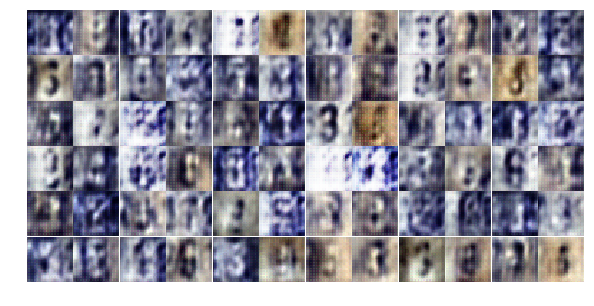

Epoch 3/25... Discriminator Loss: 1.2960... Generator Loss: 0.7846
Epoch 3/25... Discriminator Loss: 1.3134... Generator Loss: 0.7263
Epoch 3/25... Discriminator Loss: 1.3149... Generator Loss: 0.6469
Epoch 3/25... Discriminator Loss: 1.2465... Generator Loss: 0.7512
Epoch 3/25... Discriminator Loss: 1.3279... Generator Loss: 0.6793
Epoch 3/25... Discriminator Loss: 1.2808... Generator Loss: 0.7892
Epoch 3/25... Discriminator Loss: 1.3817... Generator Loss: 0.7214
Epoch 3/25... Discriminator Loss: 1.3639... Generator Loss: 0.7198
Epoch 3/25... Discriminator Loss: 1.3505... Generator Loss: 0.7135
Epoch 3/25... Discriminator Loss: 1.2728... Generator Loss: 0.7581


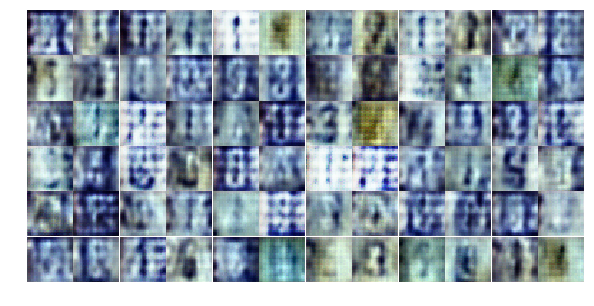

Epoch 3/25... Discriminator Loss: 1.4046... Generator Loss: 0.7190
Epoch 4/25... Discriminator Loss: 1.3284... Generator Loss: 0.7161
Epoch 4/25... Discriminator Loss: 1.3589... Generator Loss: 0.6452
Epoch 4/25... Discriminator Loss: 1.2924... Generator Loss: 0.7993
Epoch 4/25... Discriminator Loss: 1.3492... Generator Loss: 0.7300
Epoch 4/25... Discriminator Loss: 1.3990... Generator Loss: 0.8475
Epoch 4/25... Discriminator Loss: 1.2949... Generator Loss: 0.7758
Epoch 4/25... Discriminator Loss: 1.2300... Generator Loss: 0.7655
Epoch 4/25... Discriminator Loss: 1.2131... Generator Loss: 0.7797
Epoch 4/25... Discriminator Loss: 1.3796... Generator Loss: 0.7999


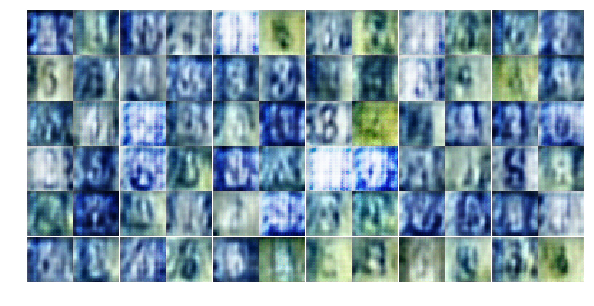

Epoch 4/25... Discriminator Loss: 1.4582... Generator Loss: 0.5857
Epoch 4/25... Discriminator Loss: 1.3175... Generator Loss: 0.7394
Epoch 4/25... Discriminator Loss: 1.4935... Generator Loss: 0.7457
Epoch 4/25... Discriminator Loss: 1.3191... Generator Loss: 0.7851
Epoch 4/25... Discriminator Loss: 1.4054... Generator Loss: 0.6815
Epoch 4/25... Discriminator Loss: 1.3332... Generator Loss: 0.7258
Epoch 4/25... Discriminator Loss: 1.3374... Generator Loss: 0.7628
Epoch 4/25... Discriminator Loss: 1.3320... Generator Loss: 0.7820
Epoch 4/25... Discriminator Loss: 1.3253... Generator Loss: 0.7299
Epoch 4/25... Discriminator Loss: 1.4446... Generator Loss: 0.4946


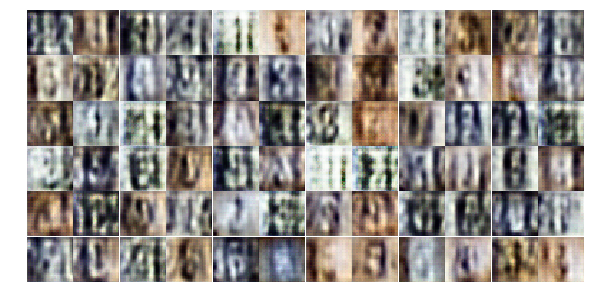

Epoch 4/25... Discriminator Loss: 1.4313... Generator Loss: 0.8060
Epoch 4/25... Discriminator Loss: 1.3717... Generator Loss: 0.7350
Epoch 4/25... Discriminator Loss: 1.3664... Generator Loss: 0.7577
Epoch 4/25... Discriminator Loss: 1.4077... Generator Loss: 0.6830
Epoch 4/25... Discriminator Loss: 1.3251... Generator Loss: 0.7394
Epoch 4/25... Discriminator Loss: 1.3731... Generator Loss: 0.7104
Epoch 4/25... Discriminator Loss: 1.3695... Generator Loss: 0.7472
Epoch 4/25... Discriminator Loss: 1.2588... Generator Loss: 0.7475
Epoch 4/25... Discriminator Loss: 1.3308... Generator Loss: 0.7170
Epoch 4/25... Discriminator Loss: 1.3682... Generator Loss: 0.7061


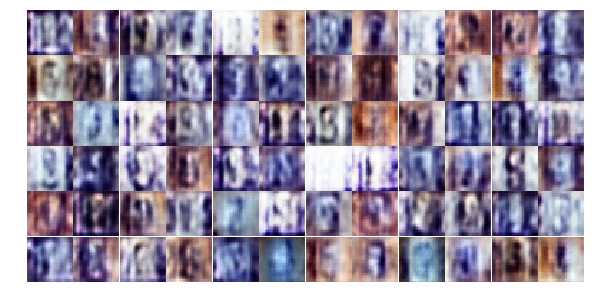

Epoch 4/25... Discriminator Loss: 1.2997... Generator Loss: 0.7100
Epoch 4/25... Discriminator Loss: 1.3510... Generator Loss: 0.6803
Epoch 4/25... Discriminator Loss: 1.3729... Generator Loss: 0.6632
Epoch 4/25... Discriminator Loss: 1.2614... Generator Loss: 0.8685
Epoch 4/25... Discriminator Loss: 1.2984... Generator Loss: 0.7903
Epoch 4/25... Discriminator Loss: 1.2147... Generator Loss: 0.7866
Epoch 4/25... Discriminator Loss: 1.3312... Generator Loss: 0.7379
Epoch 4/25... Discriminator Loss: 1.3799... Generator Loss: 0.9421
Epoch 4/25... Discriminator Loss: 1.3050... Generator Loss: 0.6796
Epoch 4/25... Discriminator Loss: 1.3212... Generator Loss: 0.7998


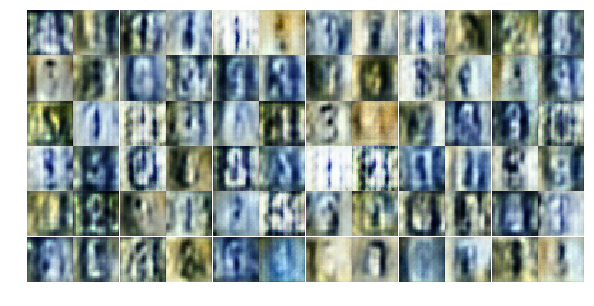

Epoch 4/25... Discriminator Loss: 1.4610... Generator Loss: 0.7298
Epoch 4/25... Discriminator Loss: 1.3589... Generator Loss: 0.7048
Epoch 4/25... Discriminator Loss: 1.2925... Generator Loss: 0.8080
Epoch 4/25... Discriminator Loss: 1.2365... Generator Loss: 0.6128
Epoch 4/25... Discriminator Loss: 1.3801... Generator Loss: 0.7890
Epoch 4/25... Discriminator Loss: 1.3400... Generator Loss: 0.7083
Epoch 4/25... Discriminator Loss: 1.3099... Generator Loss: 0.6915
Epoch 4/25... Discriminator Loss: 1.3581... Generator Loss: 0.8577
Epoch 4/25... Discriminator Loss: 1.3477... Generator Loss: 0.7630
Epoch 4/25... Discriminator Loss: 1.3093... Generator Loss: 0.7790


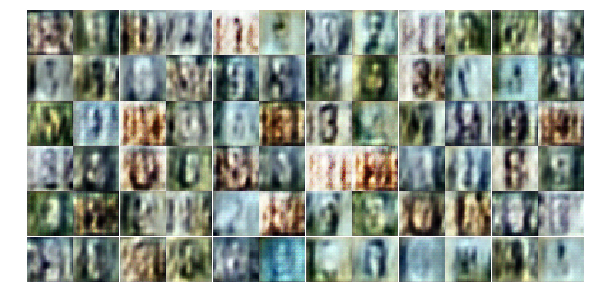

Epoch 4/25... Discriminator Loss: 1.2045... Generator Loss: 0.6721
Epoch 4/25... Discriminator Loss: 1.4596... Generator Loss: 0.6812
Epoch 4/25... Discriminator Loss: 1.3524... Generator Loss: 0.7356
Epoch 4/25... Discriminator Loss: 1.3857... Generator Loss: 0.7264
Epoch 4/25... Discriminator Loss: 1.2645... Generator Loss: 0.8515
Epoch 4/25... Discriminator Loss: 1.3140... Generator Loss: 0.7153
Epoch 4/25... Discriminator Loss: 1.3002... Generator Loss: 0.7388
Epoch 4/25... Discriminator Loss: 1.3989... Generator Loss: 0.7602
Epoch 4/25... Discriminator Loss: 1.3336... Generator Loss: 0.8365
Epoch 5/25... Discriminator Loss: 1.3617... Generator Loss: 0.7201


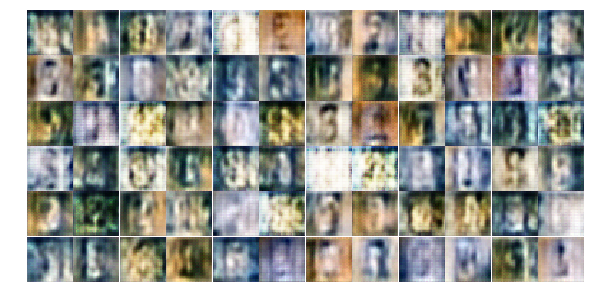

Epoch 5/25... Discriminator Loss: 1.2581... Generator Loss: 0.7720
Epoch 5/25... Discriminator Loss: 1.4189... Generator Loss: 0.7929
Epoch 5/25... Discriminator Loss: 1.3780... Generator Loss: 0.7197
Epoch 5/25... Discriminator Loss: 1.3301... Generator Loss: 0.7384
Epoch 5/25... Discriminator Loss: 1.2504... Generator Loss: 0.7889
Epoch 5/25... Discriminator Loss: 1.3993... Generator Loss: 0.7784
Epoch 5/25... Discriminator Loss: 1.3244... Generator Loss: 0.7265
Epoch 5/25... Discriminator Loss: 1.3939... Generator Loss: 0.7590
Epoch 5/25... Discriminator Loss: 1.2245... Generator Loss: 0.7039
Epoch 5/25... Discriminator Loss: 1.3465... Generator Loss: 0.8368


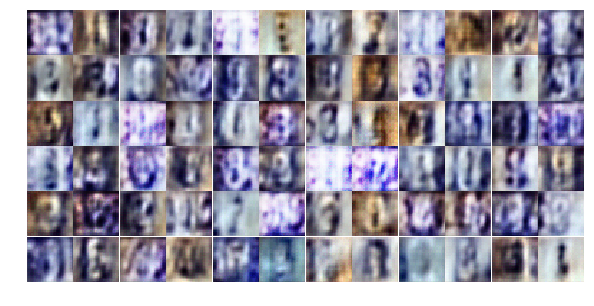

Epoch 5/25... Discriminator Loss: 1.2835... Generator Loss: 0.7565
Epoch 5/25... Discriminator Loss: 1.3268... Generator Loss: 0.7644
Epoch 5/25... Discriminator Loss: 1.1322... Generator Loss: 0.9201
Epoch 5/25... Discriminator Loss: 1.3937... Generator Loss: 0.9180
Epoch 5/25... Discriminator Loss: 1.2753... Generator Loss: 0.7204
Epoch 5/25... Discriminator Loss: 1.1967... Generator Loss: 0.7600
Epoch 5/25... Discriminator Loss: 1.4701... Generator Loss: 1.0105
Epoch 5/25... Discriminator Loss: 1.2674... Generator Loss: 0.7849
Epoch 5/25... Discriminator Loss: 1.1275... Generator Loss: 0.8058
Epoch 5/25... Discriminator Loss: 1.3686... Generator Loss: 0.8700


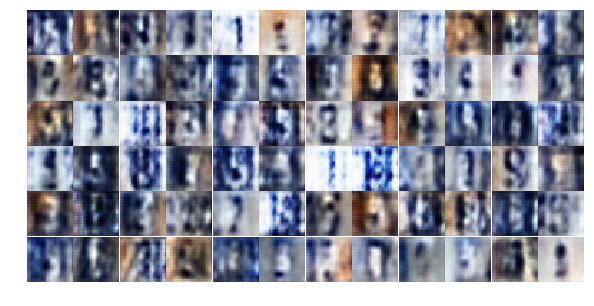

Epoch 5/25... Discriminator Loss: 1.2409... Generator Loss: 0.8731
Epoch 5/25... Discriminator Loss: 1.0436... Generator Loss: 1.0922
Epoch 5/25... Discriminator Loss: 1.2206... Generator Loss: 0.7324
Epoch 5/25... Discriminator Loss: 1.2883... Generator Loss: 0.6973
Epoch 5/25... Discriminator Loss: 1.0671... Generator Loss: 0.9585
Epoch 5/25... Discriminator Loss: 1.4083... Generator Loss: 1.2065
Epoch 5/25... Discriminator Loss: 1.5316... Generator Loss: 0.7601
Epoch 5/25... Discriminator Loss: 1.1816... Generator Loss: 0.8122
Epoch 5/25... Discriminator Loss: 1.2084... Generator Loss: 0.8641
Epoch 5/25... Discriminator Loss: 1.1702... Generator Loss: 1.0048


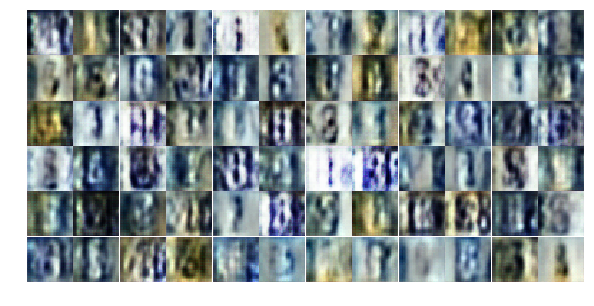

Epoch 5/25... Discriminator Loss: 1.1663... Generator Loss: 0.7563
Epoch 5/25... Discriminator Loss: 1.2401... Generator Loss: 0.8376
Epoch 5/25... Discriminator Loss: 1.2144... Generator Loss: 0.7715
Epoch 5/25... Discriminator Loss: 1.3939... Generator Loss: 0.7417
Epoch 5/25... Discriminator Loss: 1.2568... Generator Loss: 0.7510
Epoch 5/25... Discriminator Loss: 1.1760... Generator Loss: 0.7460
Epoch 5/25... Discriminator Loss: 1.2896... Generator Loss: 0.8020
Epoch 5/25... Discriminator Loss: 1.2431... Generator Loss: 0.8295
Epoch 5/25... Discriminator Loss: 1.0341... Generator Loss: 0.9896
Epoch 5/25... Discriminator Loss: 1.2353... Generator Loss: 0.7688


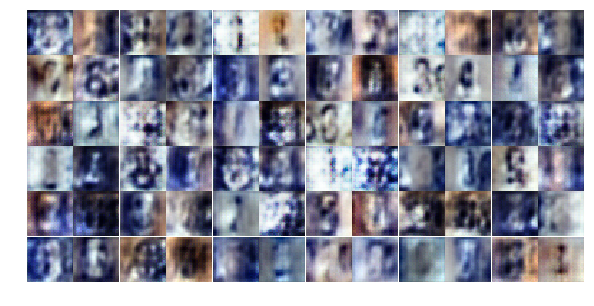

Epoch 5/25... Discriminator Loss: 1.1944... Generator Loss: 0.8942
Epoch 5/25... Discriminator Loss: 1.1144... Generator Loss: 0.9169
Epoch 5/25... Discriminator Loss: 1.2182... Generator Loss: 0.7613
Epoch 5/25... Discriminator Loss: 1.1112... Generator Loss: 0.8708
Epoch 5/25... Discriminator Loss: 1.3646... Generator Loss: 1.0313
Epoch 5/25... Discriminator Loss: 1.1777... Generator Loss: 0.9058
Epoch 5/25... Discriminator Loss: 1.1511... Generator Loss: 0.9218
Epoch 5/25... Discriminator Loss: 1.2199... Generator Loss: 0.7737
Epoch 5/25... Discriminator Loss: 1.9773... Generator Loss: 1.1847
Epoch 5/25... Discriminator Loss: 1.2174... Generator Loss: 0.9129


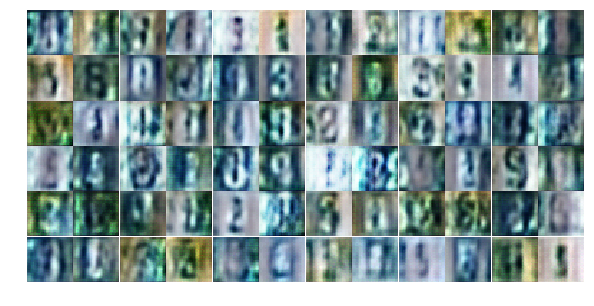

Epoch 5/25... Discriminator Loss: 1.2835... Generator Loss: 0.8660
Epoch 5/25... Discriminator Loss: 0.8946... Generator Loss: 0.9643
Epoch 5/25... Discriminator Loss: 1.7929... Generator Loss: 1.1379
Epoch 5/25... Discriminator Loss: 1.1863... Generator Loss: 0.8294
Epoch 5/25... Discriminator Loss: 1.1911... Generator Loss: 1.0283
Epoch 5/25... Discriminator Loss: 1.1955... Generator Loss: 0.9062
Epoch 6/25... Discriminator Loss: 1.2300... Generator Loss: 0.9788
Epoch 6/25... Discriminator Loss: 1.1333... Generator Loss: 1.1399
Epoch 6/25... Discriminator Loss: 0.9423... Generator Loss: 0.8269
Epoch 6/25... Discriminator Loss: 0.9821... Generator Loss: 1.0649


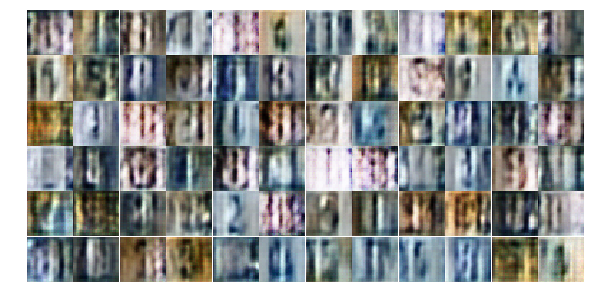

Epoch 6/25... Discriminator Loss: 1.0152... Generator Loss: 1.0396
Epoch 6/25... Discriminator Loss: 1.1278... Generator Loss: 0.8882
Epoch 6/25... Discriminator Loss: 1.2074... Generator Loss: 0.7111
Epoch 6/25... Discriminator Loss: 1.2554... Generator Loss: 0.8216
Epoch 6/25... Discriminator Loss: 0.9934... Generator Loss: 1.0396
Epoch 6/25... Discriminator Loss: 1.2027... Generator Loss: 1.5480
Epoch 6/25... Discriminator Loss: 1.4193... Generator Loss: 0.8977
Epoch 6/25... Discriminator Loss: 0.9924... Generator Loss: 0.9187
Epoch 6/25... Discriminator Loss: 1.0586... Generator Loss: 1.0614
Epoch 6/25... Discriminator Loss: 1.1407... Generator Loss: 0.9115


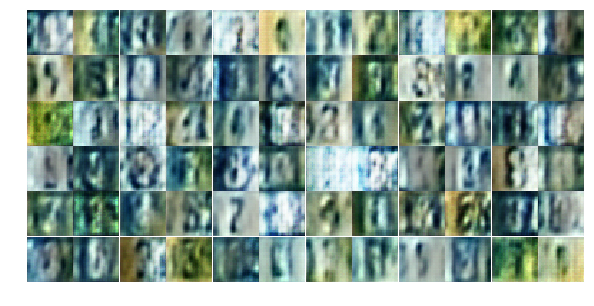

Epoch 6/25... Discriminator Loss: 1.1181... Generator Loss: 1.1364
Epoch 6/25... Discriminator Loss: 1.1636... Generator Loss: 0.8498
Epoch 6/25... Discriminator Loss: 1.1843... Generator Loss: 0.8715
Epoch 6/25... Discriminator Loss: 1.1204... Generator Loss: 1.1142
Epoch 6/25... Discriminator Loss: 1.2219... Generator Loss: 1.2197
Epoch 6/25... Discriminator Loss: 1.1276... Generator Loss: 0.9821
Epoch 6/25... Discriminator Loss: 0.9571... Generator Loss: 0.9242
Epoch 6/25... Discriminator Loss: 0.9563... Generator Loss: 0.9042
Epoch 6/25... Discriminator Loss: 1.1135... Generator Loss: 0.9279
Epoch 6/25... Discriminator Loss: 1.2180... Generator Loss: 0.9345


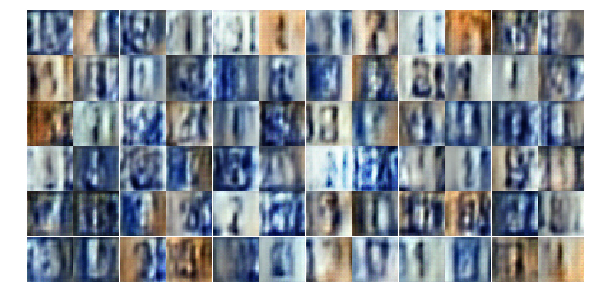

Epoch 6/25... Discriminator Loss: 1.4463... Generator Loss: 1.2390
Epoch 6/25... Discriminator Loss: 1.0628... Generator Loss: 0.9265
Epoch 6/25... Discriminator Loss: 1.0535... Generator Loss: 0.9904
Epoch 6/25... Discriminator Loss: 1.5161... Generator Loss: 1.2535
Epoch 6/25... Discriminator Loss: 1.0596... Generator Loss: 0.9311
Epoch 6/25... Discriminator Loss: 0.8817... Generator Loss: 0.9748
Epoch 6/25... Discriminator Loss: 1.0572... Generator Loss: 1.0158
Epoch 6/25... Discriminator Loss: 0.9876... Generator Loss: 0.8161
Epoch 6/25... Discriminator Loss: 0.9779... Generator Loss: 0.9342
Epoch 6/25... Discriminator Loss: 1.0444... Generator Loss: 1.1697


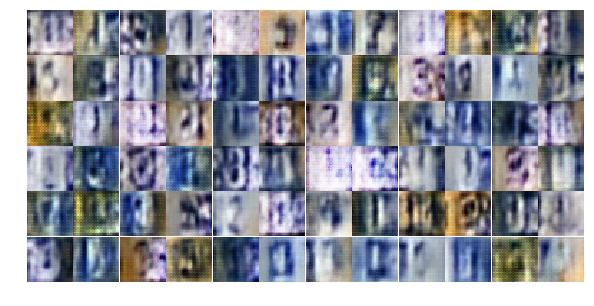

Epoch 6/25... Discriminator Loss: 1.1186... Generator Loss: 0.9338
Epoch 6/25... Discriminator Loss: 1.1115... Generator Loss: 0.8179
Epoch 6/25... Discriminator Loss: 1.2469... Generator Loss: 0.8986
Epoch 6/25... Discriminator Loss: 0.8606... Generator Loss: 1.3447
Epoch 6/25... Discriminator Loss: 1.1058... Generator Loss: 0.8564
Epoch 6/25... Discriminator Loss: 1.0278... Generator Loss: 1.0112
Epoch 6/25... Discriminator Loss: 1.0712... Generator Loss: 1.4934
Epoch 6/25... Discriminator Loss: 0.9342... Generator Loss: 1.0128
Epoch 6/25... Discriminator Loss: 1.1545... Generator Loss: 0.7157
Epoch 6/25... Discriminator Loss: 1.0450... Generator Loss: 0.9339


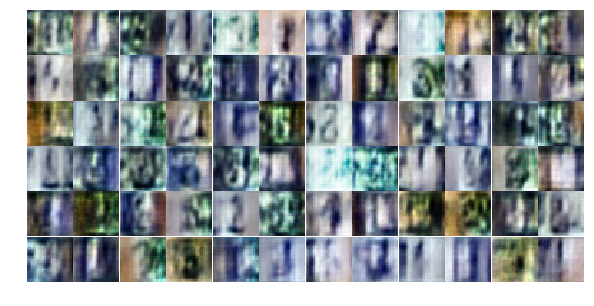

Epoch 6/25... Discriminator Loss: 0.8936... Generator Loss: 1.0915
Epoch 6/25... Discriminator Loss: 1.1356... Generator Loss: 0.9613
Epoch 6/25... Discriminator Loss: 1.1962... Generator Loss: 1.0233
Epoch 6/25... Discriminator Loss: 1.1306... Generator Loss: 0.9785
Epoch 6/25... Discriminator Loss: 1.0647... Generator Loss: 0.9494
Epoch 6/25... Discriminator Loss: 1.0664... Generator Loss: 1.0972
Epoch 6/25... Discriminator Loss: 1.0387... Generator Loss: 1.0967
Epoch 6/25... Discriminator Loss: 1.1949... Generator Loss: 0.7994
Epoch 6/25... Discriminator Loss: 1.0062... Generator Loss: 1.0718
Epoch 6/25... Discriminator Loss: 1.1783... Generator Loss: 0.8336


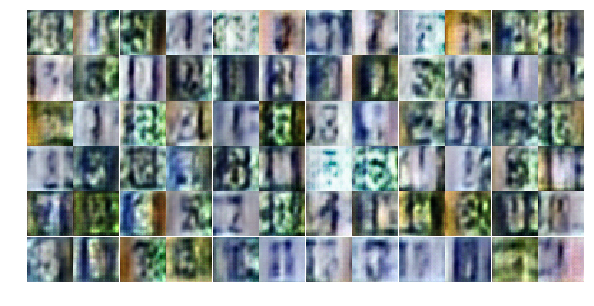

Epoch 6/25... Discriminator Loss: 1.0672... Generator Loss: 0.9869
Epoch 6/25... Discriminator Loss: 1.0577... Generator Loss: 1.1700
Epoch 6/25... Discriminator Loss: 1.1607... Generator Loss: 0.7348
Epoch 7/25... Discriminator Loss: 1.5578... Generator Loss: 1.7619
Epoch 7/25... Discriminator Loss: 1.0941... Generator Loss: 0.9239
Epoch 7/25... Discriminator Loss: 0.9528... Generator Loss: 0.9374
Epoch 7/25... Discriminator Loss: 1.0795... Generator Loss: 1.0109
Epoch 7/25... Discriminator Loss: 1.1444... Generator Loss: 0.9235
Epoch 7/25... Discriminator Loss: 1.0851... Generator Loss: 0.9660
Epoch 7/25... Discriminator Loss: 1.2745... Generator Loss: 0.6798


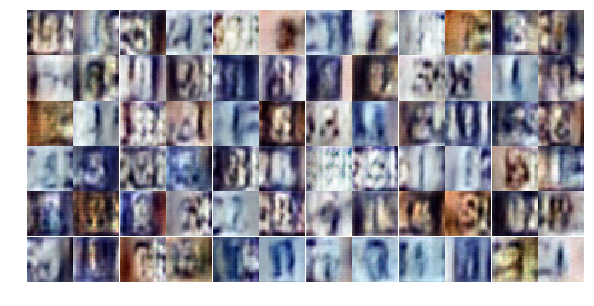

Epoch 7/25... Discriminator Loss: 0.9972... Generator Loss: 1.1210
Epoch 7/25... Discriminator Loss: 1.1410... Generator Loss: 0.9049
Epoch 7/25... Discriminator Loss: 1.2321... Generator Loss: 0.9844
Epoch 7/25... Discriminator Loss: 1.1497... Generator Loss: 0.9302
Epoch 7/25... Discriminator Loss: 1.1227... Generator Loss: 0.9094
Epoch 7/25... Discriminator Loss: 1.0367... Generator Loss: 1.0160
Epoch 7/25... Discriminator Loss: 1.0984... Generator Loss: 1.0606
Epoch 7/25... Discriminator Loss: 1.1026... Generator Loss: 0.9406
Epoch 7/25... Discriminator Loss: 1.0167... Generator Loss: 0.9938
Epoch 7/25... Discriminator Loss: 1.1232... Generator Loss: 1.0010


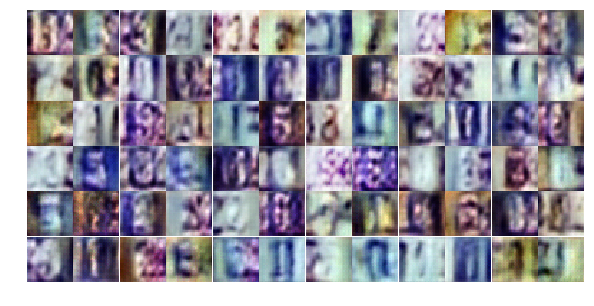

Epoch 7/25... Discriminator Loss: 1.1466... Generator Loss: 1.1255
Epoch 7/25... Discriminator Loss: 1.0331... Generator Loss: 1.0602
Epoch 7/25... Discriminator Loss: 1.0930... Generator Loss: 0.9387
Epoch 7/25... Discriminator Loss: 1.0823... Generator Loss: 1.0271
Epoch 7/25... Discriminator Loss: 1.0635... Generator Loss: 0.9752
Epoch 7/25... Discriminator Loss: 1.0535... Generator Loss: 1.2275
Epoch 7/25... Discriminator Loss: 1.1187... Generator Loss: 1.0315
Epoch 7/25... Discriminator Loss: 1.0844... Generator Loss: 0.9347
Epoch 7/25... Discriminator Loss: 1.0634... Generator Loss: 0.9337
Epoch 7/25... Discriminator Loss: 1.1609... Generator Loss: 0.8695


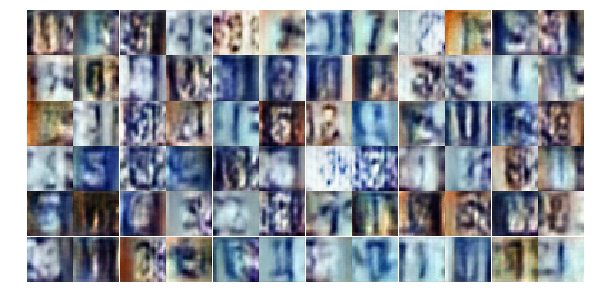

Epoch 7/25... Discriminator Loss: 1.1507... Generator Loss: 0.7879
Epoch 7/25... Discriminator Loss: 1.0754... Generator Loss: 1.1223
Epoch 7/25... Discriminator Loss: 1.0768... Generator Loss: 0.8774
Epoch 7/25... Discriminator Loss: 0.9543... Generator Loss: 1.0937
Epoch 7/25... Discriminator Loss: 1.2194... Generator Loss: 0.9318
Epoch 7/25... Discriminator Loss: 1.2060... Generator Loss: 0.8469
Epoch 7/25... Discriminator Loss: 1.2605... Generator Loss: 1.0100
Epoch 7/25... Discriminator Loss: 1.0374... Generator Loss: 1.0531
Epoch 7/25... Discriminator Loss: 1.1903... Generator Loss: 0.8362
Epoch 7/25... Discriminator Loss: 1.0242... Generator Loss: 1.0696


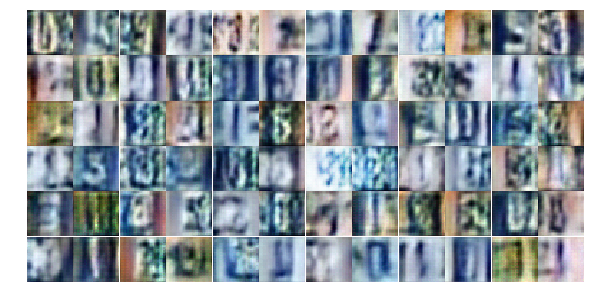

Epoch 7/25... Discriminator Loss: 1.2371... Generator Loss: 1.1788
Epoch 7/25... Discriminator Loss: 1.1984... Generator Loss: 0.9827
Epoch 7/25... Discriminator Loss: 1.1723... Generator Loss: 0.9954
Epoch 7/25... Discriminator Loss: 1.0406... Generator Loss: 0.8529
Epoch 7/25... Discriminator Loss: 1.0056... Generator Loss: 0.9652
Epoch 7/25... Discriminator Loss: 1.1905... Generator Loss: 1.1865
Epoch 7/25... Discriminator Loss: 1.1424... Generator Loss: 0.8848
Epoch 7/25... Discriminator Loss: 1.1497... Generator Loss: 0.7244
Epoch 7/25... Discriminator Loss: 1.1302... Generator Loss: 0.7147
Epoch 7/25... Discriminator Loss: 1.1568... Generator Loss: 0.9228


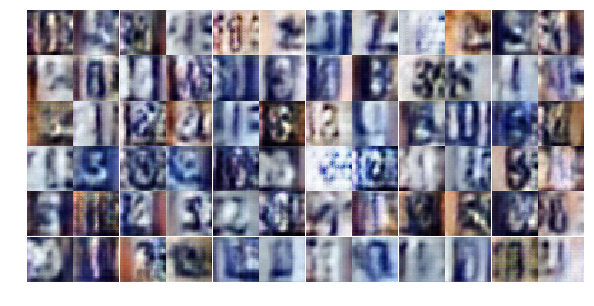

Epoch 7/25... Discriminator Loss: 1.1303... Generator Loss: 0.9903
Epoch 7/25... Discriminator Loss: 1.0402... Generator Loss: 0.8905
Epoch 7/25... Discriminator Loss: 1.1380... Generator Loss: 0.8593
Epoch 7/25... Discriminator Loss: 1.0229... Generator Loss: 0.9242
Epoch 7/25... Discriminator Loss: 1.0320... Generator Loss: 0.9595
Epoch 7/25... Discriminator Loss: 1.1169... Generator Loss: 0.9851
Epoch 7/25... Discriminator Loss: 1.0223... Generator Loss: 0.8554
Epoch 7/25... Discriminator Loss: 1.0185... Generator Loss: 1.1253
Epoch 7/25... Discriminator Loss: 1.1168... Generator Loss: 0.8810
Epoch 7/25... Discriminator Loss: 1.1233... Generator Loss: 0.9658


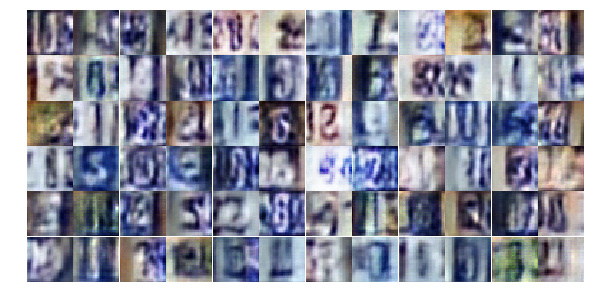

Epoch 7/25... Discriminator Loss: 1.0451... Generator Loss: 1.0879
Epoch 8/25... Discriminator Loss: 1.1448... Generator Loss: 1.0846
Epoch 8/25... Discriminator Loss: 1.0720... Generator Loss: 0.8989
Epoch 8/25... Discriminator Loss: 1.1481... Generator Loss: 0.8878
Epoch 8/25... Discriminator Loss: 1.1920... Generator Loss: 0.7833
Epoch 8/25... Discriminator Loss: 1.0692... Generator Loss: 0.9940
Epoch 8/25... Discriminator Loss: 1.1435... Generator Loss: 0.8910
Epoch 8/25... Discriminator Loss: 1.0636... Generator Loss: 0.9678
Epoch 8/25... Discriminator Loss: 1.0973... Generator Loss: 1.0058
Epoch 8/25... Discriminator Loss: 1.1345... Generator Loss: 0.8716


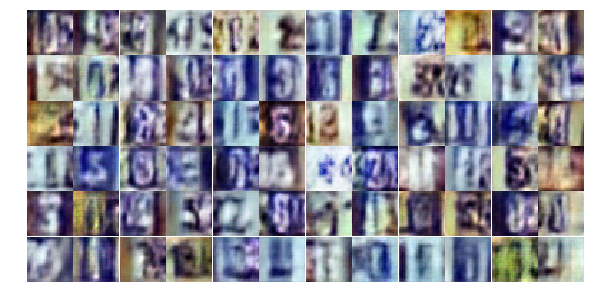

Epoch 8/25... Discriminator Loss: 1.0620... Generator Loss: 0.9285
Epoch 8/25... Discriminator Loss: 1.1288... Generator Loss: 1.1250
Epoch 8/25... Discriminator Loss: 1.2525... Generator Loss: 0.9174
Epoch 8/25... Discriminator Loss: 1.0806... Generator Loss: 0.9680
Epoch 8/25... Discriminator Loss: 1.0515... Generator Loss: 1.0230
Epoch 8/25... Discriminator Loss: 1.0365... Generator Loss: 0.9099
Epoch 8/25... Discriminator Loss: 1.2518... Generator Loss: 0.7243
Epoch 8/25... Discriminator Loss: 1.1054... Generator Loss: 0.9602
Epoch 8/25... Discriminator Loss: 1.1572... Generator Loss: 1.0736
Epoch 8/25... Discriminator Loss: 1.1969... Generator Loss: 0.8519


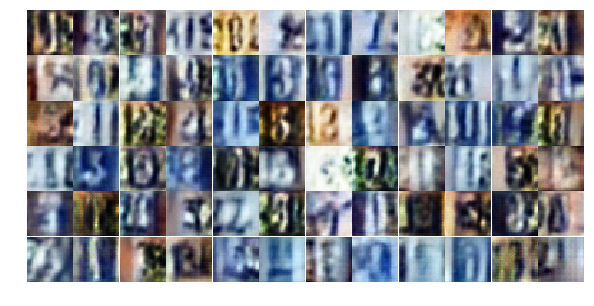

Epoch 8/25... Discriminator Loss: 1.1304... Generator Loss: 0.9478
Epoch 8/25... Discriminator Loss: 1.1342... Generator Loss: 0.9424
Epoch 8/25... Discriminator Loss: 1.0469... Generator Loss: 0.8507
Epoch 8/25... Discriminator Loss: 1.1243... Generator Loss: 0.8962
Epoch 8/25... Discriminator Loss: 1.1071... Generator Loss: 0.8607
Epoch 8/25... Discriminator Loss: 0.9709... Generator Loss: 1.0578
Epoch 8/25... Discriminator Loss: 1.2112... Generator Loss: 0.8351
Epoch 8/25... Discriminator Loss: 1.2602... Generator Loss: 0.9084
Epoch 8/25... Discriminator Loss: 1.1105... Generator Loss: 0.8160
Epoch 8/25... Discriminator Loss: 1.1005... Generator Loss: 0.9020


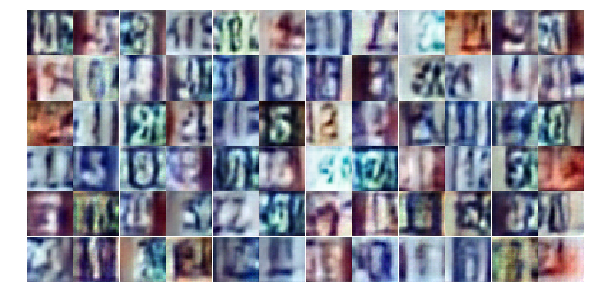

Epoch 8/25... Discriminator Loss: 1.1634... Generator Loss: 0.7805
Epoch 8/25... Discriminator Loss: 1.1407... Generator Loss: 0.9373
Epoch 8/25... Discriminator Loss: 1.2664... Generator Loss: 1.1256
Epoch 8/25... Discriminator Loss: 1.1240... Generator Loss: 0.8392
Epoch 8/25... Discriminator Loss: 1.1614... Generator Loss: 0.8229
Epoch 8/25... Discriminator Loss: 1.1081... Generator Loss: 0.9065
Epoch 8/25... Discriminator Loss: 1.2144... Generator Loss: 0.8826
Epoch 8/25... Discriminator Loss: 1.1335... Generator Loss: 0.9680
Epoch 8/25... Discriminator Loss: 1.1592... Generator Loss: 0.8059
Epoch 8/25... Discriminator Loss: 1.1086... Generator Loss: 0.8416


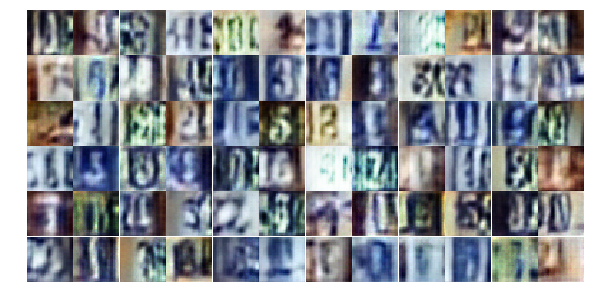

Epoch 8/25... Discriminator Loss: 1.0905... Generator Loss: 0.9384
Epoch 8/25... Discriminator Loss: 1.2554... Generator Loss: 0.7051
Epoch 8/25... Discriminator Loss: 1.1547... Generator Loss: 0.9576
Epoch 8/25... Discriminator Loss: 1.2572... Generator Loss: 1.0234
Epoch 8/25... Discriminator Loss: 1.1401... Generator Loss: 0.9028
Epoch 8/25... Discriminator Loss: 1.0328... Generator Loss: 0.8746
Epoch 8/25... Discriminator Loss: 1.1151... Generator Loss: 1.0147
Epoch 8/25... Discriminator Loss: 1.1496... Generator Loss: 0.9485
Epoch 8/25... Discriminator Loss: 1.3394... Generator Loss: 0.7496
Epoch 8/25... Discriminator Loss: 1.1951... Generator Loss: 0.8755


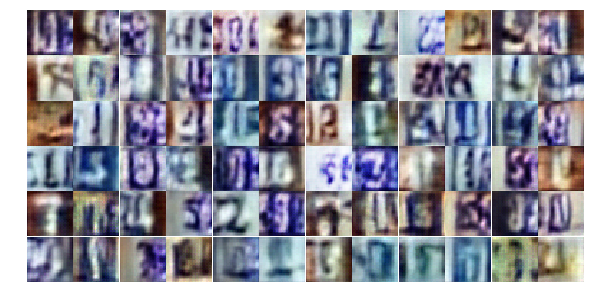

Epoch 8/25... Discriminator Loss: 1.2625... Generator Loss: 0.7685
Epoch 8/25... Discriminator Loss: 1.1387... Generator Loss: 1.0047
Epoch 8/25... Discriminator Loss: 1.1253... Generator Loss: 0.9380
Epoch 8/25... Discriminator Loss: 1.1022... Generator Loss: 0.8640
Epoch 8/25... Discriminator Loss: 1.1259... Generator Loss: 0.9032
Epoch 8/25... Discriminator Loss: 1.2332... Generator Loss: 0.7684
Epoch 8/25... Discriminator Loss: 1.1886... Generator Loss: 0.9728
Epoch 8/25... Discriminator Loss: 1.1748... Generator Loss: 0.8813
Epoch 9/25... Discriminator Loss: 1.2458... Generator Loss: 0.7603
Epoch 9/25... Discriminator Loss: 1.3558... Generator Loss: 0.7416


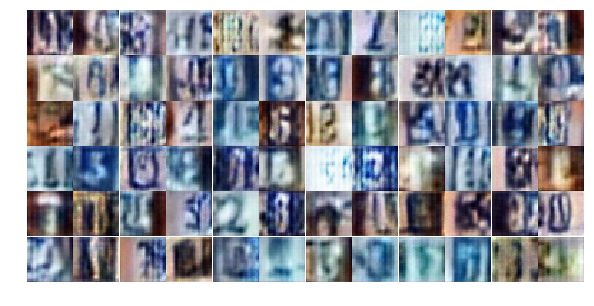

Epoch 9/25... Discriminator Loss: 1.4787... Generator Loss: 0.9460
Epoch 9/25... Discriminator Loss: 1.2120... Generator Loss: 0.8539
Epoch 9/25... Discriminator Loss: 1.1161... Generator Loss: 0.8587
Epoch 9/25... Discriminator Loss: 1.2786... Generator Loss: 0.8432
Epoch 9/25... Discriminator Loss: 1.2553... Generator Loss: 0.8413
Epoch 9/25... Discriminator Loss: 1.1133... Generator Loss: 0.8649
Epoch 9/25... Discriminator Loss: 1.1393... Generator Loss: 0.9318
Epoch 9/25... Discriminator Loss: 1.1863... Generator Loss: 0.8492
Epoch 9/25... Discriminator Loss: 1.1729... Generator Loss: 0.8299
Epoch 9/25... Discriminator Loss: 1.1818... Generator Loss: 0.9541


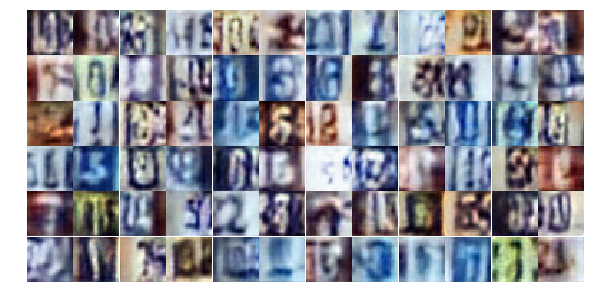

Epoch 9/25... Discriminator Loss: 1.1413... Generator Loss: 0.8147
Epoch 9/25... Discriminator Loss: 1.0253... Generator Loss: 0.8633
Epoch 9/25... Discriminator Loss: 1.1942... Generator Loss: 0.8627
Epoch 9/25... Discriminator Loss: 1.1822... Generator Loss: 0.8013
Epoch 9/25... Discriminator Loss: 1.1425... Generator Loss: 0.8183
Epoch 9/25... Discriminator Loss: 1.1776... Generator Loss: 0.8691
Epoch 9/25... Discriminator Loss: 1.1424... Generator Loss: 0.8941
Epoch 9/25... Discriminator Loss: 1.0940... Generator Loss: 0.9335
Epoch 9/25... Discriminator Loss: 1.0850... Generator Loss: 0.9761
Epoch 9/25... Discriminator Loss: 1.2966... Generator Loss: 0.7801


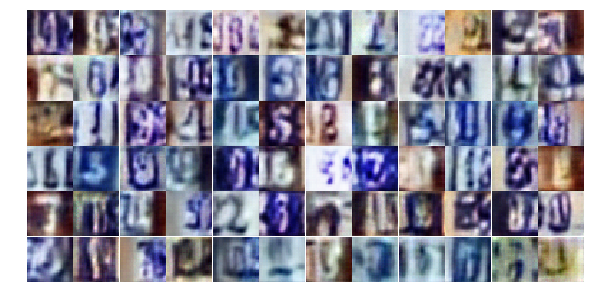

Epoch 9/25... Discriminator Loss: 1.1993... Generator Loss: 0.9832
Epoch 9/25... Discriminator Loss: 1.1274... Generator Loss: 1.0298
Epoch 9/25... Discriminator Loss: 1.1213... Generator Loss: 0.9191
Epoch 9/25... Discriminator Loss: 1.2428... Generator Loss: 1.2621
Epoch 9/25... Discriminator Loss: 1.2893... Generator Loss: 0.6354
Epoch 9/25... Discriminator Loss: 1.0724... Generator Loss: 0.8147
Epoch 9/25... Discriminator Loss: 1.1381... Generator Loss: 0.8576
Epoch 9/25... Discriminator Loss: 1.2074... Generator Loss: 0.7602
Epoch 9/25... Discriminator Loss: 1.2924... Generator Loss: 0.9145
Epoch 9/25... Discriminator Loss: 1.0483... Generator Loss: 1.0883


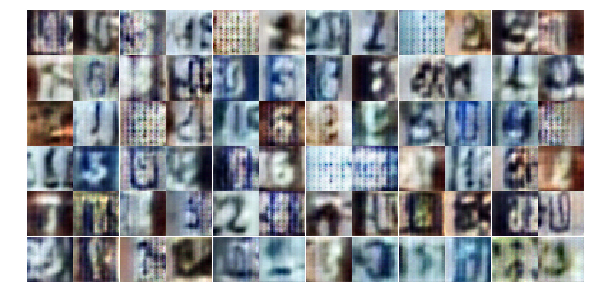

Epoch 9/25... Discriminator Loss: 1.1953... Generator Loss: 0.8362
Epoch 9/25... Discriminator Loss: 1.1962... Generator Loss: 0.8886
Epoch 9/25... Discriminator Loss: 1.2074... Generator Loss: 0.8560
Epoch 9/25... Discriminator Loss: 1.1667... Generator Loss: 0.8767
Epoch 9/25... Discriminator Loss: 1.1889... Generator Loss: 0.8853
Epoch 9/25... Discriminator Loss: 1.1224... Generator Loss: 0.9677
Epoch 9/25... Discriminator Loss: 1.1500... Generator Loss: 0.8056
Epoch 9/25... Discriminator Loss: 1.0892... Generator Loss: 0.8883
Epoch 9/25... Discriminator Loss: 1.1239... Generator Loss: 0.8184
Epoch 9/25... Discriminator Loss: 1.1609... Generator Loss: 0.8927


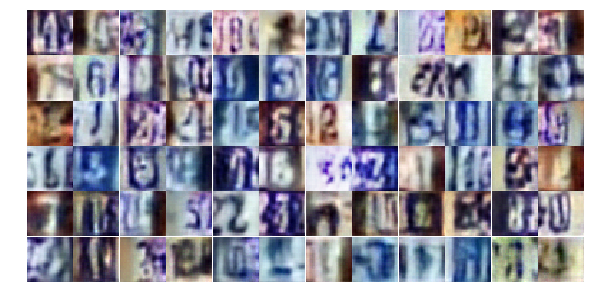

Epoch 9/25... Discriminator Loss: 1.2504... Generator Loss: 0.8851
Epoch 9/25... Discriminator Loss: 1.2581... Generator Loss: 0.8274
Epoch 9/25... Discriminator Loss: 1.0870... Generator Loss: 0.9324
Epoch 9/25... Discriminator Loss: 1.1462... Generator Loss: 0.9440
Epoch 9/25... Discriminator Loss: 1.0920... Generator Loss: 0.8322
Epoch 9/25... Discriminator Loss: 1.2010... Generator Loss: 1.2694
Epoch 9/25... Discriminator Loss: 1.1330... Generator Loss: 0.8613
Epoch 9/25... Discriminator Loss: 1.2061... Generator Loss: 0.8376
Epoch 9/25... Discriminator Loss: 1.0890... Generator Loss: 0.9628
Epoch 9/25... Discriminator Loss: 1.2264... Generator Loss: 0.9011


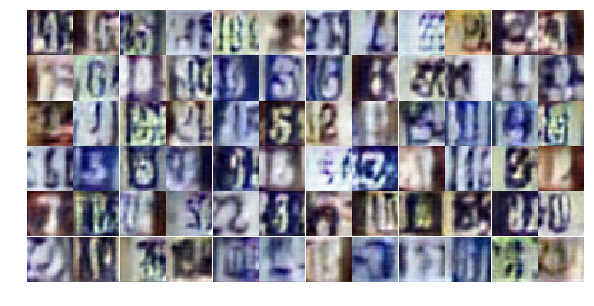

Epoch 9/25... Discriminator Loss: 1.1878... Generator Loss: 0.7888
Epoch 9/25... Discriminator Loss: 1.1056... Generator Loss: 0.8418
Epoch 9/25... Discriminator Loss: 1.1321... Generator Loss: 0.8682
Epoch 9/25... Discriminator Loss: 1.1833... Generator Loss: 0.7848
Epoch 9/25... Discriminator Loss: 1.1508... Generator Loss: 0.9845
Epoch 10/25... Discriminator Loss: 1.1416... Generator Loss: 0.8213
Epoch 10/25... Discriminator Loss: 1.0362... Generator Loss: 1.0680
Epoch 10/25... Discriminator Loss: 1.0802... Generator Loss: 0.9657
Epoch 10/25... Discriminator Loss: 1.2193... Generator Loss: 0.8637
Epoch 10/25... Discriminator Loss: 1.1884... Generator Loss: 0.8667


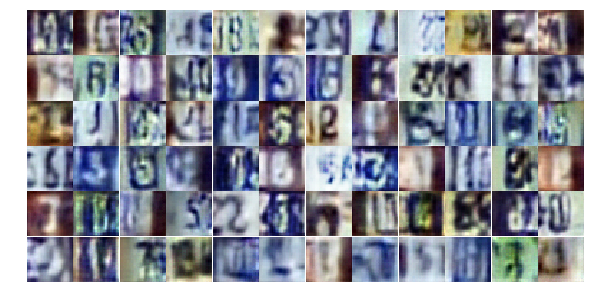

Epoch 10/25... Discriminator Loss: 1.2993... Generator Loss: 0.9226
Epoch 10/25... Discriminator Loss: 1.1577... Generator Loss: 0.8755
Epoch 10/25... Discriminator Loss: 1.1818... Generator Loss: 0.9848
Epoch 10/25... Discriminator Loss: 1.1763... Generator Loss: 0.8660
Epoch 10/25... Discriminator Loss: 1.2127... Generator Loss: 0.8113
Epoch 10/25... Discriminator Loss: 1.2467... Generator Loss: 0.9401
Epoch 10/25... Discriminator Loss: 1.1128... Generator Loss: 0.9366
Epoch 10/25... Discriminator Loss: 1.1280... Generator Loss: 0.8705
Epoch 10/25... Discriminator Loss: 1.0748... Generator Loss: 0.8471
Epoch 10/25... Discriminator Loss: 1.0925... Generator Loss: 0.9136


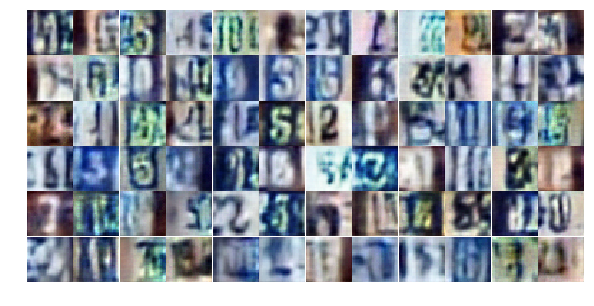

Epoch 10/25... Discriminator Loss: 1.1597... Generator Loss: 0.8637
Epoch 10/25... Discriminator Loss: 1.2549... Generator Loss: 0.9635
Epoch 10/25... Discriminator Loss: 1.2006... Generator Loss: 0.9633
Epoch 10/25... Discriminator Loss: 1.1024... Generator Loss: 1.0422
Epoch 10/25... Discriminator Loss: 1.1990... Generator Loss: 0.7380
Epoch 10/25... Discriminator Loss: 1.0845... Generator Loss: 0.9463
Epoch 10/25... Discriminator Loss: 1.1996... Generator Loss: 0.8519
Epoch 10/25... Discriminator Loss: 1.1675... Generator Loss: 0.8478
Epoch 10/25... Discriminator Loss: 1.1010... Generator Loss: 0.9063
Epoch 10/25... Discriminator Loss: 1.1698... Generator Loss: 0.7723


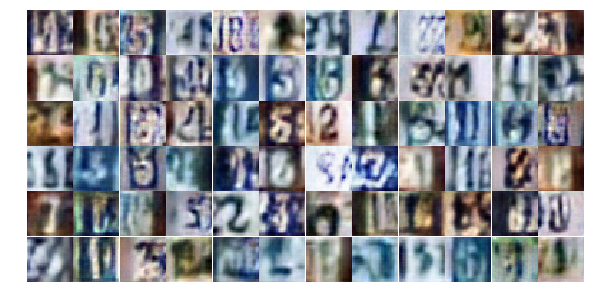

Epoch 10/25... Discriminator Loss: 1.1567... Generator Loss: 0.7087
Epoch 10/25... Discriminator Loss: 1.1218... Generator Loss: 0.8387
Epoch 10/25... Discriminator Loss: 1.0983... Generator Loss: 1.1600
Epoch 10/25... Discriminator Loss: 1.2074... Generator Loss: 0.8021
Epoch 10/25... Discriminator Loss: 1.1555... Generator Loss: 0.7880
Epoch 10/25... Discriminator Loss: 1.2135... Generator Loss: 0.9645
Epoch 10/25... Discriminator Loss: 1.0816... Generator Loss: 0.9401
Epoch 10/25... Discriminator Loss: 1.0692... Generator Loss: 1.0804
Epoch 10/25... Discriminator Loss: 1.2235... Generator Loss: 0.8091
Epoch 10/25... Discriminator Loss: 1.2439... Generator Loss: 0.9146


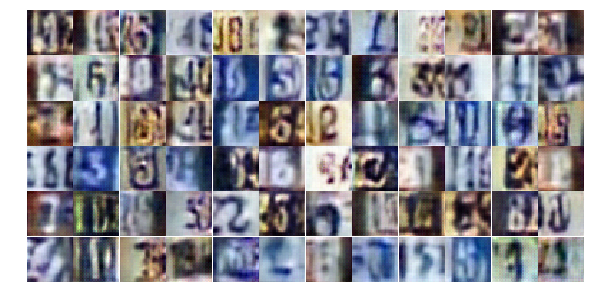

Epoch 10/25... Discriminator Loss: 1.1706... Generator Loss: 0.8575
Epoch 10/25... Discriminator Loss: 1.2411... Generator Loss: 0.9635
Epoch 10/25... Discriminator Loss: 1.1314... Generator Loss: 0.8435
Epoch 10/25... Discriminator Loss: 1.1945... Generator Loss: 0.8255
Epoch 10/25... Discriminator Loss: 1.1722... Generator Loss: 0.9515
Epoch 10/25... Discriminator Loss: 1.2258... Generator Loss: 0.9071
Epoch 10/25... Discriminator Loss: 1.1598... Generator Loss: 0.8651
Epoch 10/25... Discriminator Loss: 1.3319... Generator Loss: 0.7132
Epoch 10/25... Discriminator Loss: 1.1993... Generator Loss: 0.9138
Epoch 10/25... Discriminator Loss: 1.1907... Generator Loss: 0.8390


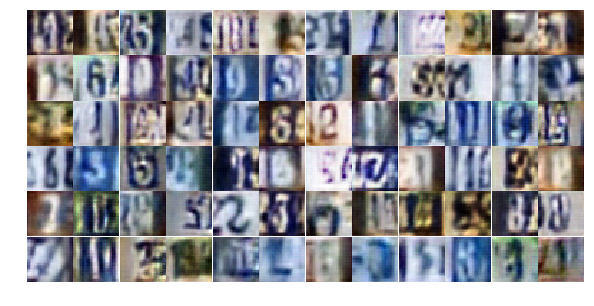

Epoch 10/25... Discriminator Loss: 1.2068... Generator Loss: 1.0246
Epoch 10/25... Discriminator Loss: 1.0856... Generator Loss: 0.8476
Epoch 10/25... Discriminator Loss: 1.2262... Generator Loss: 0.8267
Epoch 10/25... Discriminator Loss: 1.2297... Generator Loss: 1.1300
Epoch 10/25... Discriminator Loss: 1.1814... Generator Loss: 0.9025
Epoch 10/25... Discriminator Loss: 1.1338... Generator Loss: 0.7972
Epoch 10/25... Discriminator Loss: 1.1166... Generator Loss: 0.8516
Epoch 10/25... Discriminator Loss: 1.0345... Generator Loss: 0.8921
Epoch 10/25... Discriminator Loss: 1.2660... Generator Loss: 0.8229
Epoch 10/25... Discriminator Loss: 1.1883... Generator Loss: 1.0388


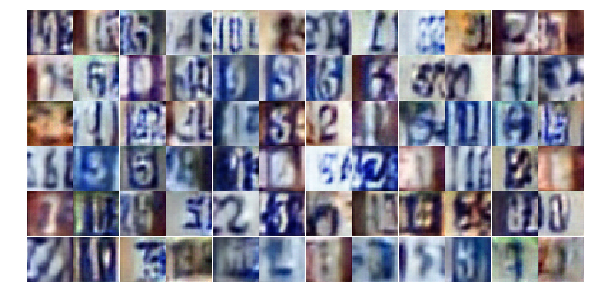

Epoch 10/25... Discriminator Loss: 1.2092... Generator Loss: 0.8188
Epoch 10/25... Discriminator Loss: 1.1594... Generator Loss: 0.8933
Epoch 10/25... Discriminator Loss: 0.9549... Generator Loss: 0.9627
Epoch 11/25... Discriminator Loss: 1.1630... Generator Loss: 0.8235
Epoch 11/25... Discriminator Loss: 1.1400... Generator Loss: 0.9860
Epoch 11/25... Discriminator Loss: 1.2629... Generator Loss: 0.7937
Epoch 11/25... Discriminator Loss: 1.2132... Generator Loss: 0.7988
Epoch 11/25... Discriminator Loss: 1.0534... Generator Loss: 0.9283
Epoch 11/25... Discriminator Loss: 1.2564... Generator Loss: 0.7822
Epoch 11/25... Discriminator Loss: 1.1188... Generator Loss: 0.8732


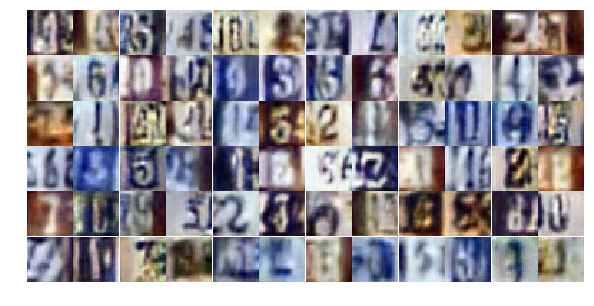

Epoch 11/25... Discriminator Loss: 1.1182... Generator Loss: 1.0448
Epoch 11/25... Discriminator Loss: 1.1606... Generator Loss: 0.8474
Epoch 11/25... Discriminator Loss: 0.9995... Generator Loss: 0.9700
Epoch 11/25... Discriminator Loss: 1.1697... Generator Loss: 0.9113
Epoch 11/25... Discriminator Loss: 1.1961... Generator Loss: 0.8839
Epoch 11/25... Discriminator Loss: 1.2187... Generator Loss: 0.8394
Epoch 11/25... Discriminator Loss: 1.0070... Generator Loss: 1.0736
Epoch 11/25... Discriminator Loss: 1.0531... Generator Loss: 1.0430
Epoch 11/25... Discriminator Loss: 1.1155... Generator Loss: 0.9205
Epoch 11/25... Discriminator Loss: 1.2810... Generator Loss: 0.8167


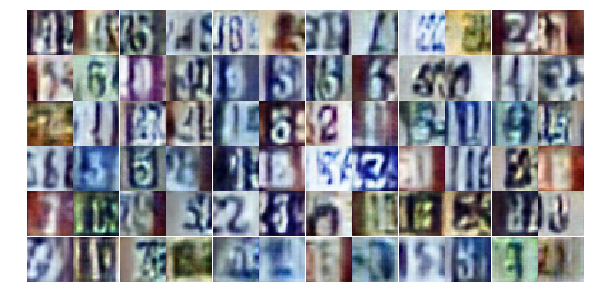

Epoch 11/25... Discriminator Loss: 1.2196... Generator Loss: 0.9379
Epoch 11/25... Discriminator Loss: 1.0898... Generator Loss: 0.8905
Epoch 11/25... Discriminator Loss: 1.2009... Generator Loss: 0.8679
Epoch 11/25... Discriminator Loss: 1.1456... Generator Loss: 0.8458
Epoch 11/25... Discriminator Loss: 1.1499... Generator Loss: 0.8760
Epoch 11/25... Discriminator Loss: 1.0008... Generator Loss: 0.9513
Epoch 11/25... Discriminator Loss: 1.1502... Generator Loss: 0.9283
Epoch 11/25... Discriminator Loss: 1.2688... Generator Loss: 0.7738
Epoch 11/25... Discriminator Loss: 1.0973... Generator Loss: 0.8738
Epoch 11/25... Discriminator Loss: 1.1259... Generator Loss: 0.8525


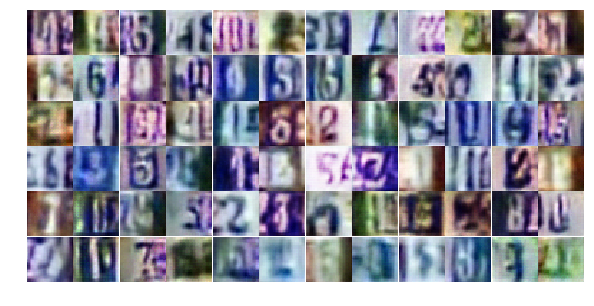

Epoch 11/25... Discriminator Loss: 1.2659... Generator Loss: 0.8947
Epoch 11/25... Discriminator Loss: 1.0873... Generator Loss: 0.9052
Epoch 11/25... Discriminator Loss: 1.1967... Generator Loss: 0.9390
Epoch 11/25... Discriminator Loss: 1.1758... Generator Loss: 0.7856
Epoch 11/25... Discriminator Loss: 1.1171... Generator Loss: 0.9046
Epoch 11/25... Discriminator Loss: 1.1341... Generator Loss: 0.8569
Epoch 11/25... Discriminator Loss: 1.1690... Generator Loss: 0.8043
Epoch 11/25... Discriminator Loss: 1.2403... Generator Loss: 0.7808
Epoch 11/25... Discriminator Loss: 1.1446... Generator Loss: 0.7912
Epoch 11/25... Discriminator Loss: 1.1867... Generator Loss: 0.8481


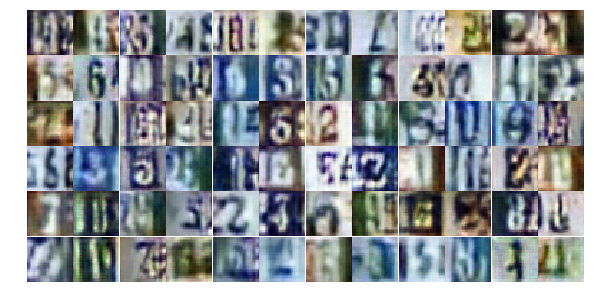

Epoch 11/25... Discriminator Loss: 1.0190... Generator Loss: 1.0003
Epoch 11/25... Discriminator Loss: 1.1312... Generator Loss: 0.9250
Epoch 11/25... Discriminator Loss: 1.2551... Generator Loss: 1.0059
Epoch 11/25... Discriminator Loss: 1.2202... Generator Loss: 0.7944
Epoch 11/25... Discriminator Loss: 1.1919... Generator Loss: 0.7927
Epoch 11/25... Discriminator Loss: 1.1347... Generator Loss: 0.9355
Epoch 11/25... Discriminator Loss: 1.2003... Generator Loss: 0.8852
Epoch 11/25... Discriminator Loss: 1.1703... Generator Loss: 0.9011
Epoch 11/25... Discriminator Loss: 1.1288... Generator Loss: 0.8605
Epoch 11/25... Discriminator Loss: 1.1939... Generator Loss: 0.9350


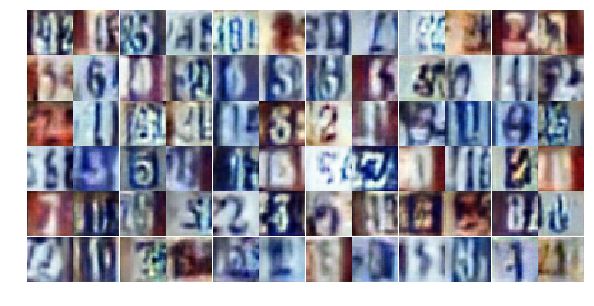

Epoch 11/25... Discriminator Loss: 1.1768... Generator Loss: 0.9174
Epoch 11/25... Discriminator Loss: 1.0829... Generator Loss: 0.9363
Epoch 11/25... Discriminator Loss: 1.1591... Generator Loss: 0.8137
Epoch 11/25... Discriminator Loss: 1.2095... Generator Loss: 0.8498
Epoch 11/25... Discriminator Loss: 1.2411... Generator Loss: 0.8459
Epoch 11/25... Discriminator Loss: 1.1244... Generator Loss: 0.9883
Epoch 11/25... Discriminator Loss: 1.1019... Generator Loss: 0.8248
Epoch 11/25... Discriminator Loss: 1.1696... Generator Loss: 0.8429
Epoch 11/25... Discriminator Loss: 1.2218... Generator Loss: 0.9492
Epoch 11/25... Discriminator Loss: 1.2448... Generator Loss: 0.8329


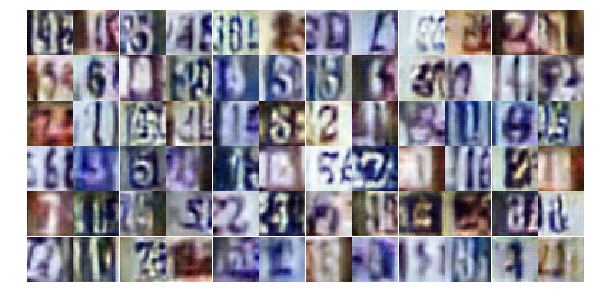

Epoch 12/25... Discriminator Loss: 1.0706... Generator Loss: 0.9086
Epoch 12/25... Discriminator Loss: 1.1652... Generator Loss: 0.8800
Epoch 12/25... Discriminator Loss: 1.0781... Generator Loss: 0.9521
Epoch 12/25... Discriminator Loss: 1.2327... Generator Loss: 0.7851
Epoch 12/25... Discriminator Loss: 1.1632... Generator Loss: 0.8213
Epoch 12/25... Discriminator Loss: 1.1321... Generator Loss: 0.8409
Epoch 12/25... Discriminator Loss: 1.1483... Generator Loss: 0.8812
Epoch 12/25... Discriminator Loss: 1.2544... Generator Loss: 1.0323
Epoch 12/25... Discriminator Loss: 1.2216... Generator Loss: 0.8639
Epoch 12/25... Discriminator Loss: 1.2523... Generator Loss: 0.8508


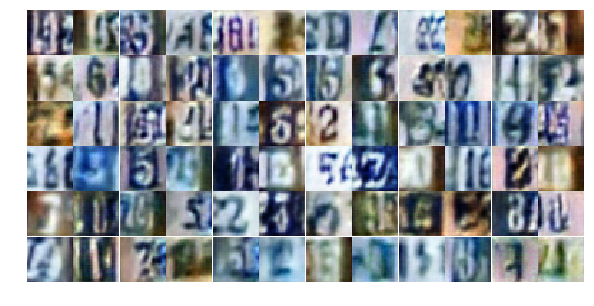

Epoch 12/25... Discriminator Loss: 1.1323... Generator Loss: 0.7916
Epoch 12/25... Discriminator Loss: 1.2230... Generator Loss: 0.8746
Epoch 12/25... Discriminator Loss: 1.0765... Generator Loss: 0.8528
Epoch 12/25... Discriminator Loss: 1.1721... Generator Loss: 1.0008
Epoch 12/25... Discriminator Loss: 1.1999... Generator Loss: 0.9642
Epoch 12/25... Discriminator Loss: 1.2158... Generator Loss: 0.7995
Epoch 12/25... Discriminator Loss: 1.1710... Generator Loss: 0.8264
Epoch 12/25... Discriminator Loss: 1.0572... Generator Loss: 0.9114
Epoch 12/25... Discriminator Loss: 1.1578... Generator Loss: 0.9480
Epoch 12/25... Discriminator Loss: 1.2209... Generator Loss: 0.8417


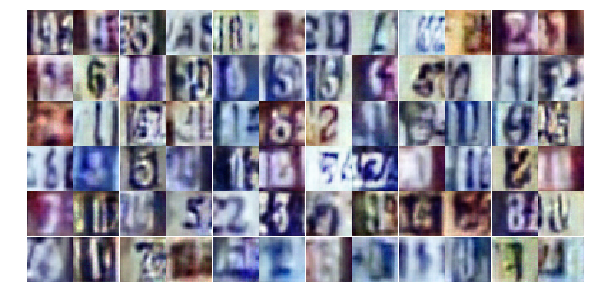

Epoch 12/25... Discriminator Loss: 1.1139... Generator Loss: 0.9266
Epoch 12/25... Discriminator Loss: 1.1054... Generator Loss: 0.9221
Epoch 12/25... Discriminator Loss: 1.2105... Generator Loss: 0.8626
Epoch 12/25... Discriminator Loss: 1.1417... Generator Loss: 0.7374
Epoch 12/25... Discriminator Loss: 1.2033... Generator Loss: 0.8456
Epoch 12/25... Discriminator Loss: 1.1120... Generator Loss: 0.9096
Epoch 12/25... Discriminator Loss: 1.1989... Generator Loss: 0.8871
Epoch 12/25... Discriminator Loss: 1.1014... Generator Loss: 1.0076
Epoch 12/25... Discriminator Loss: 1.0981... Generator Loss: 0.8358
Epoch 12/25... Discriminator Loss: 1.2018... Generator Loss: 0.8099


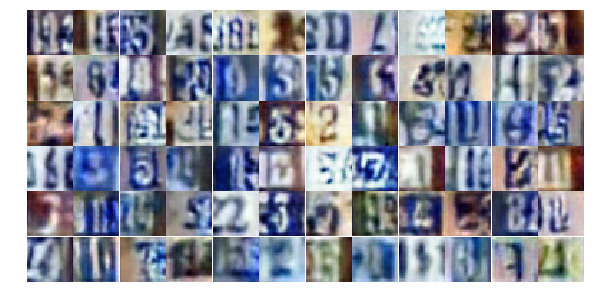

Epoch 12/25... Discriminator Loss: 1.2440... Generator Loss: 0.8082
Epoch 12/25... Discriminator Loss: 1.2259... Generator Loss: 0.8814
Epoch 12/25... Discriminator Loss: 1.1307... Generator Loss: 0.8536
Epoch 12/25... Discriminator Loss: 1.1089... Generator Loss: 0.8180
Epoch 12/25... Discriminator Loss: 1.2259... Generator Loss: 0.8554
Epoch 12/25... Discriminator Loss: 1.2213... Generator Loss: 0.9847
Epoch 12/25... Discriminator Loss: 1.1722... Generator Loss: 0.7873
Epoch 12/25... Discriminator Loss: 1.2042... Generator Loss: 0.7828
Epoch 12/25... Discriminator Loss: 1.1413... Generator Loss: 0.9648
Epoch 12/25... Discriminator Loss: 1.0800... Generator Loss: 0.9756


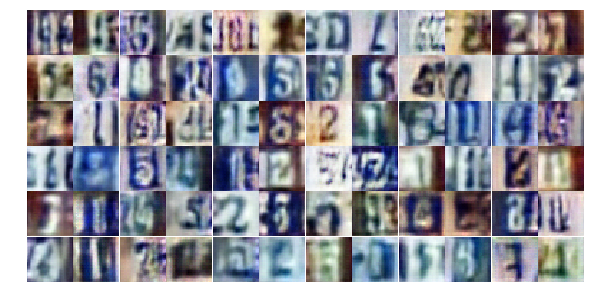

Epoch 12/25... Discriminator Loss: 1.1320... Generator Loss: 0.9799
Epoch 12/25... Discriminator Loss: 1.1174... Generator Loss: 0.8975
Epoch 12/25... Discriminator Loss: 1.1907... Generator Loss: 0.8771
Epoch 12/25... Discriminator Loss: 1.1339... Generator Loss: 0.9083
Epoch 12/25... Discriminator Loss: 1.0626... Generator Loss: 0.9170
Epoch 12/25... Discriminator Loss: 1.2679... Generator Loss: 0.8490
Epoch 12/25... Discriminator Loss: 1.1872... Generator Loss: 0.9292
Epoch 12/25... Discriminator Loss: 1.1627... Generator Loss: 0.8257
Epoch 12/25... Discriminator Loss: 1.2448... Generator Loss: 0.7644
Epoch 12/25... Discriminator Loss: 1.1958... Generator Loss: 0.8588


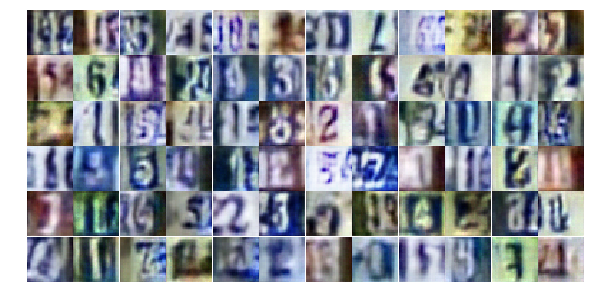

Epoch 12/25... Discriminator Loss: 1.1370... Generator Loss: 0.9776
Epoch 12/25... Discriminator Loss: 1.1910... Generator Loss: 0.7892
Epoch 12/25... Discriminator Loss: 1.0544... Generator Loss: 1.0176
Epoch 12/25... Discriminator Loss: 1.2317... Generator Loss: 0.8225
Epoch 12/25... Discriminator Loss: 1.1544... Generator Loss: 0.8275
Epoch 12/25... Discriminator Loss: 1.0424... Generator Loss: 0.9723
Epoch 12/25... Discriminator Loss: 1.2306... Generator Loss: 0.7669
Epoch 13/25... Discriminator Loss: 1.1762... Generator Loss: 0.8616
Epoch 13/25... Discriminator Loss: 1.1236... Generator Loss: 0.7823
Epoch 13/25... Discriminator Loss: 1.1590... Generator Loss: 0.8800


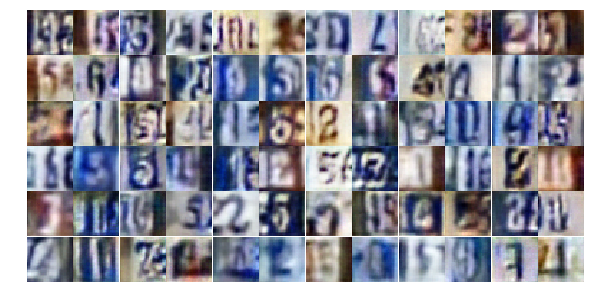

Epoch 13/25... Discriminator Loss: 1.1478... Generator Loss: 0.8709
Epoch 13/25... Discriminator Loss: 1.1557... Generator Loss: 0.8938
Epoch 13/25... Discriminator Loss: 1.1232... Generator Loss: 0.8162
Epoch 13/25... Discriminator Loss: 1.1806... Generator Loss: 0.8527
Epoch 13/25... Discriminator Loss: 1.1241... Generator Loss: 0.9377
Epoch 13/25... Discriminator Loss: 1.1640... Generator Loss: 0.9361
Epoch 13/25... Discriminator Loss: 1.1172... Generator Loss: 0.9243
Epoch 13/25... Discriminator Loss: 1.2475... Generator Loss: 0.6676
Epoch 13/25... Discriminator Loss: 1.1843... Generator Loss: 0.8501
Epoch 13/25... Discriminator Loss: 1.1090... Generator Loss: 0.8770


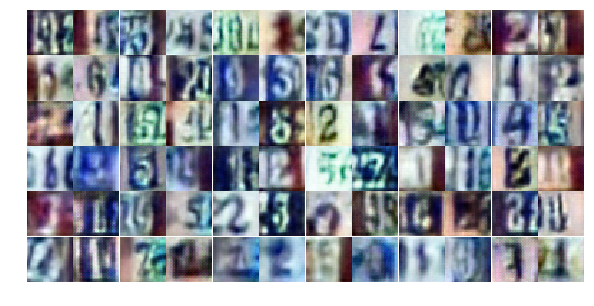

Epoch 13/25... Discriminator Loss: 1.1888... Generator Loss: 0.8827
Epoch 13/25... Discriminator Loss: 1.2839... Generator Loss: 1.0651
Epoch 13/25... Discriminator Loss: 1.1011... Generator Loss: 0.9335
Epoch 13/25... Discriminator Loss: 1.1229... Generator Loss: 0.8503
Epoch 13/25... Discriminator Loss: 1.1307... Generator Loss: 1.0130
Epoch 13/25... Discriminator Loss: 1.2021... Generator Loss: 0.8512
Epoch 13/25... Discriminator Loss: 1.1876... Generator Loss: 0.8779
Epoch 13/25... Discriminator Loss: 1.1368... Generator Loss: 0.9066
Epoch 13/25... Discriminator Loss: 1.0992... Generator Loss: 0.8612
Epoch 13/25... Discriminator Loss: 1.2274... Generator Loss: 0.8138


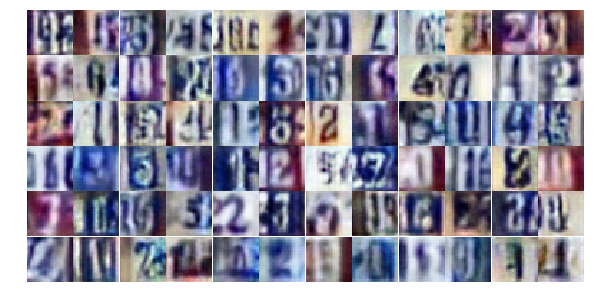

Epoch 13/25... Discriminator Loss: 1.1929... Generator Loss: 0.8170
Epoch 13/25... Discriminator Loss: 1.0709... Generator Loss: 0.9332
Epoch 13/25... Discriminator Loss: 1.1948... Generator Loss: 0.7324
Epoch 13/25... Discriminator Loss: 1.1716... Generator Loss: 0.8787
Epoch 13/25... Discriminator Loss: 1.1778... Generator Loss: 0.8690
Epoch 13/25... Discriminator Loss: 1.1663... Generator Loss: 0.8311
Epoch 13/25... Discriminator Loss: 1.0358... Generator Loss: 0.8457
Epoch 13/25... Discriminator Loss: 1.1370... Generator Loss: 0.8796
Epoch 13/25... Discriminator Loss: 1.1573... Generator Loss: 0.8692
Epoch 13/25... Discriminator Loss: 1.1544... Generator Loss: 0.8273


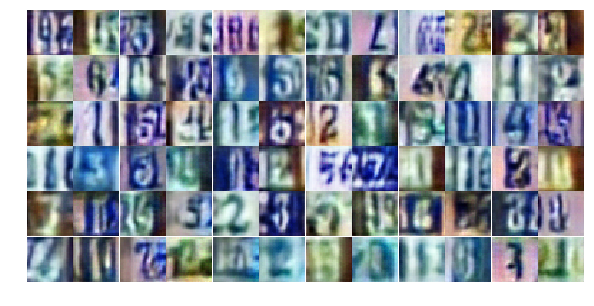

Epoch 13/25... Discriminator Loss: 1.2339... Generator Loss: 0.9363
Epoch 13/25... Discriminator Loss: 1.2048... Generator Loss: 0.9632
Epoch 13/25... Discriminator Loss: 1.1980... Generator Loss: 0.8452
Epoch 13/25... Discriminator Loss: 1.1514... Generator Loss: 0.8219
Epoch 13/25... Discriminator Loss: 1.1375... Generator Loss: 0.9294
Epoch 13/25... Discriminator Loss: 1.1227... Generator Loss: 1.0043
Epoch 13/25... Discriminator Loss: 1.1705... Generator Loss: 0.8930
Epoch 13/25... Discriminator Loss: 1.1078... Generator Loss: 0.9222
Epoch 13/25... Discriminator Loss: 1.2106... Generator Loss: 0.6871
Epoch 13/25... Discriminator Loss: 1.2826... Generator Loss: 0.6265


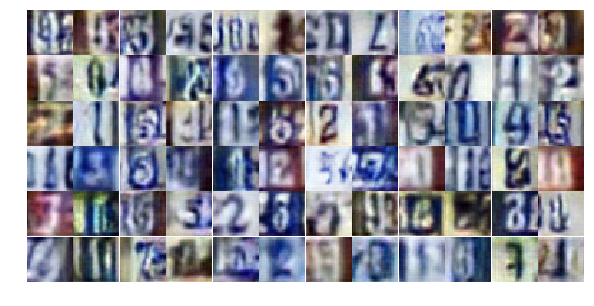

Epoch 13/25... Discriminator Loss: 1.0372... Generator Loss: 0.9647
Epoch 13/25... Discriminator Loss: 1.1813... Generator Loss: 1.0140
Epoch 13/25... Discriminator Loss: 1.2308... Generator Loss: 0.7812
Epoch 13/25... Discriminator Loss: 1.1464... Generator Loss: 0.9577
Epoch 13/25... Discriminator Loss: 1.2205... Generator Loss: 0.8499
Epoch 13/25... Discriminator Loss: 1.1782... Generator Loss: 0.8958
Epoch 13/25... Discriminator Loss: 1.1154... Generator Loss: 0.9708
Epoch 13/25... Discriminator Loss: 1.1332... Generator Loss: 0.8189
Epoch 13/25... Discriminator Loss: 1.2119... Generator Loss: 0.8661
Epoch 13/25... Discriminator Loss: 1.1566... Generator Loss: 0.8184


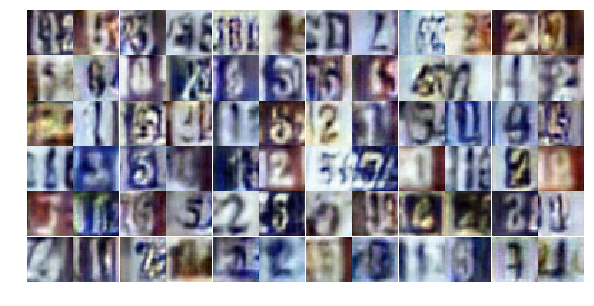

Epoch 13/25... Discriminator Loss: 1.2204... Generator Loss: 0.8750
Epoch 13/25... Discriminator Loss: 1.0720... Generator Loss: 0.8262
Epoch 13/25... Discriminator Loss: 1.1106... Generator Loss: 0.9790
Epoch 13/25... Discriminator Loss: 1.2304... Generator Loss: 0.9203
Epoch 14/25... Discriminator Loss: 1.1905... Generator Loss: 0.8843
Epoch 14/25... Discriminator Loss: 1.1600... Generator Loss: 0.9362
Epoch 14/25... Discriminator Loss: 1.1688... Generator Loss: 0.8590
Epoch 14/25... Discriminator Loss: 1.2106... Generator Loss: 0.9933
Epoch 14/25... Discriminator Loss: 1.1176... Generator Loss: 0.8674
Epoch 14/25... Discriminator Loss: 1.1224... Generator Loss: 0.8378


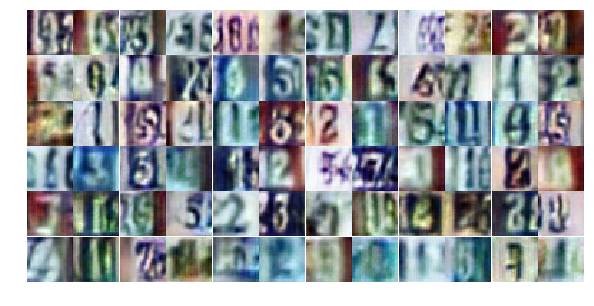

Epoch 14/25... Discriminator Loss: 1.1678... Generator Loss: 0.8701
Epoch 14/25... Discriminator Loss: 1.1604... Generator Loss: 0.7362
Epoch 14/25... Discriminator Loss: 1.1604... Generator Loss: 0.8047
Epoch 14/25... Discriminator Loss: 1.1299... Generator Loss: 0.9502
Epoch 14/25... Discriminator Loss: 1.1730... Generator Loss: 0.7522
Epoch 14/25... Discriminator Loss: 1.1392... Generator Loss: 0.9243
Epoch 14/25... Discriminator Loss: 1.0985... Generator Loss: 0.7923
Epoch 14/25... Discriminator Loss: 1.1767... Generator Loss: 0.8533
Epoch 14/25... Discriminator Loss: 1.2111... Generator Loss: 0.8130
Epoch 14/25... Discriminator Loss: 1.2326... Generator Loss: 0.8546


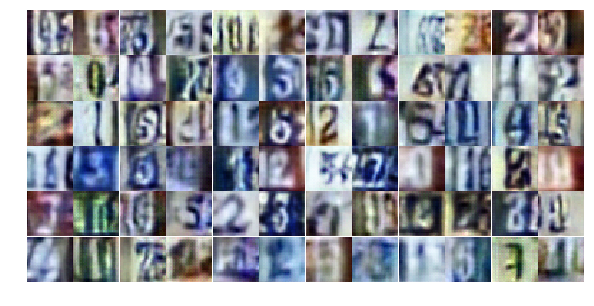

Epoch 14/25... Discriminator Loss: 1.1696... Generator Loss: 0.8377
Epoch 14/25... Discriminator Loss: 1.1927... Generator Loss: 0.8196
Epoch 14/25... Discriminator Loss: 1.1993... Generator Loss: 0.7571
Epoch 14/25... Discriminator Loss: 1.1385... Generator Loss: 0.8470
Epoch 14/25... Discriminator Loss: 1.0549... Generator Loss: 0.8921
Epoch 14/25... Discriminator Loss: 1.3366... Generator Loss: 0.7671
Epoch 14/25... Discriminator Loss: 1.2336... Generator Loss: 0.8183
Epoch 14/25... Discriminator Loss: 1.0810... Generator Loss: 0.8462
Epoch 14/25... Discriminator Loss: 1.1900... Generator Loss: 0.9344
Epoch 14/25... Discriminator Loss: 1.0733... Generator Loss: 0.9902


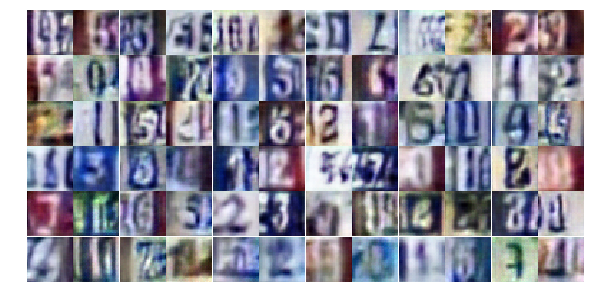

Epoch 14/25... Discriminator Loss: 1.2106... Generator Loss: 0.9440
Epoch 14/25... Discriminator Loss: 1.0964... Generator Loss: 0.7967
Epoch 14/25... Discriminator Loss: 1.1798... Generator Loss: 0.8682
Epoch 14/25... Discriminator Loss: 1.1750... Generator Loss: 0.9221
Epoch 14/25... Discriminator Loss: 1.1444... Generator Loss: 0.8728
Epoch 14/25... Discriminator Loss: 1.1751... Generator Loss: 0.8188
Epoch 14/25... Discriminator Loss: 1.1518... Generator Loss: 0.9131
Epoch 14/25... Discriminator Loss: 1.0913... Generator Loss: 0.9864
Epoch 14/25... Discriminator Loss: 1.1259... Generator Loss: 0.9222
Epoch 14/25... Discriminator Loss: 1.1860... Generator Loss: 0.8268


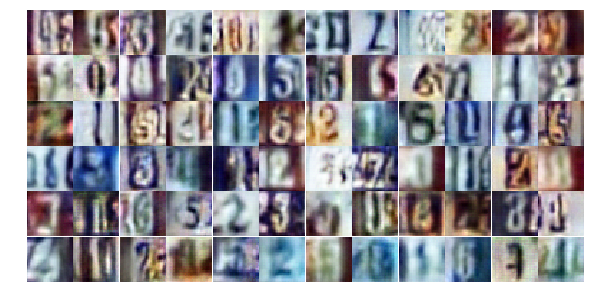

Epoch 14/25... Discriminator Loss: 1.2170... Generator Loss: 0.7089
Epoch 14/25... Discriminator Loss: 1.1388... Generator Loss: 0.9261
Epoch 14/25... Discriminator Loss: 1.2460... Generator Loss: 0.9028
Epoch 14/25... Discriminator Loss: 1.2148... Generator Loss: 0.8305
Epoch 14/25... Discriminator Loss: 1.1858... Generator Loss: 0.8420
Epoch 14/25... Discriminator Loss: 1.1959... Generator Loss: 0.8959
Epoch 14/25... Discriminator Loss: 1.1807... Generator Loss: 0.8011
Epoch 14/25... Discriminator Loss: 1.2064... Generator Loss: 0.8140
Epoch 14/25... Discriminator Loss: 1.1370... Generator Loss: 0.7866
Epoch 14/25... Discriminator Loss: 1.2254... Generator Loss: 0.7755


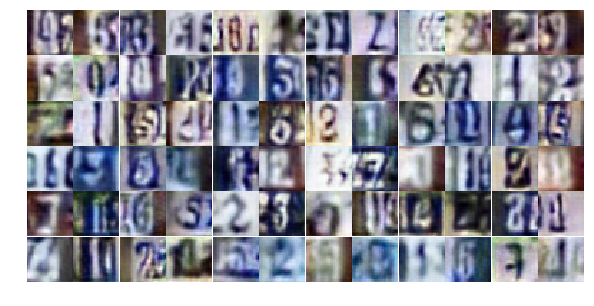

Epoch 14/25... Discriminator Loss: 1.1318... Generator Loss: 0.7967
Epoch 14/25... Discriminator Loss: 1.0794... Generator Loss: 1.0344
Epoch 14/25... Discriminator Loss: 1.1886... Generator Loss: 0.8885
Epoch 14/25... Discriminator Loss: 1.2440... Generator Loss: 0.8362
Epoch 14/25... Discriminator Loss: 1.2161... Generator Loss: 0.8241
Epoch 14/25... Discriminator Loss: 1.1788... Generator Loss: 0.8641
Epoch 14/25... Discriminator Loss: 1.2186... Generator Loss: 1.0063
Epoch 14/25... Discriminator Loss: 1.2125... Generator Loss: 0.7949
Epoch 14/25... Discriminator Loss: 1.2292... Generator Loss: 0.8576
Epoch 14/25... Discriminator Loss: 1.1774... Generator Loss: 0.7994


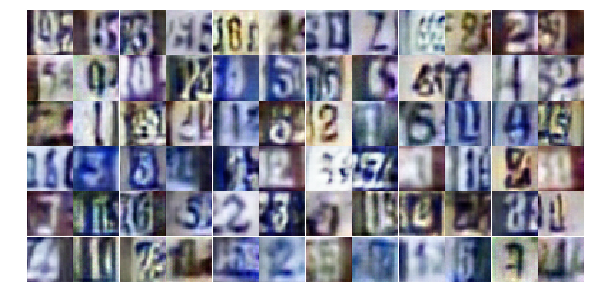

Epoch 14/25... Discriminator Loss: 1.1421... Generator Loss: 0.9155
Epoch 14/25... Discriminator Loss: 1.1950... Generator Loss: 0.8811
Epoch 15/25... Discriminator Loss: 1.0525... Generator Loss: 1.0261
Epoch 15/25... Discriminator Loss: 1.1375... Generator Loss: 0.9671
Epoch 15/25... Discriminator Loss: 1.1665... Generator Loss: 0.8993
Epoch 15/25... Discriminator Loss: 1.1652... Generator Loss: 0.8164
Epoch 15/25... Discriminator Loss: 1.1487... Generator Loss: 0.8326
Epoch 15/25... Discriminator Loss: 1.0932... Generator Loss: 0.8385
Epoch 15/25... Discriminator Loss: 1.1383... Generator Loss: 0.8597
Epoch 15/25... Discriminator Loss: 1.1923... Generator Loss: 0.8912


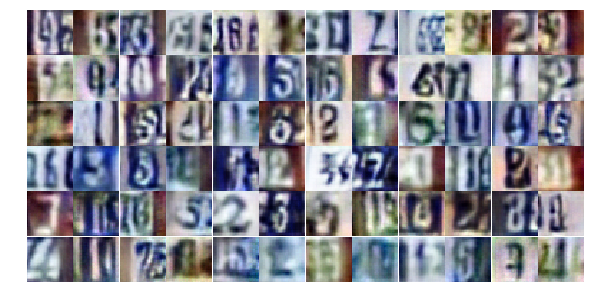

Epoch 15/25... Discriminator Loss: 1.1686... Generator Loss: 0.9343
Epoch 15/25... Discriminator Loss: 1.1858... Generator Loss: 0.8435
Epoch 15/25... Discriminator Loss: 1.2772... Generator Loss: 0.8064
Epoch 15/25... Discriminator Loss: 1.1997... Generator Loss: 0.8378
Epoch 15/25... Discriminator Loss: 1.2187... Generator Loss: 0.8826
Epoch 15/25... Discriminator Loss: 1.0467... Generator Loss: 0.8752
Epoch 15/25... Discriminator Loss: 1.2187... Generator Loss: 0.7943
Epoch 15/25... Discriminator Loss: 1.1877... Generator Loss: 0.8159
Epoch 15/25... Discriminator Loss: 1.1805... Generator Loss: 0.9837
Epoch 15/25... Discriminator Loss: 1.1606... Generator Loss: 0.9203


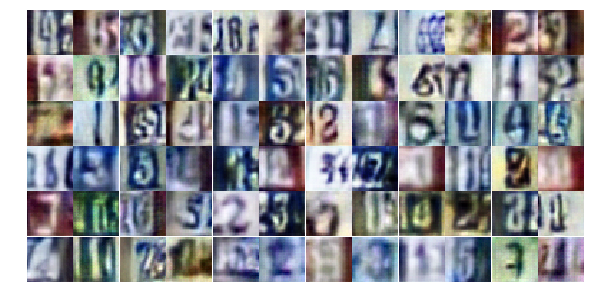

Epoch 15/25... Discriminator Loss: 1.3023... Generator Loss: 0.9557
Epoch 15/25... Discriminator Loss: 1.2325... Generator Loss: 0.8329
Epoch 15/25... Discriminator Loss: 1.1258... Generator Loss: 0.8694
Epoch 15/25... Discriminator Loss: 1.1258... Generator Loss: 0.8411
Epoch 15/25... Discriminator Loss: 1.2051... Generator Loss: 0.8036
Epoch 15/25... Discriminator Loss: 1.1238... Generator Loss: 0.9237
Epoch 15/25... Discriminator Loss: 1.1386... Generator Loss: 0.9004
Epoch 15/25... Discriminator Loss: 1.2241... Generator Loss: 0.8401
Epoch 15/25... Discriminator Loss: 1.2028... Generator Loss: 0.9300
Epoch 15/25... Discriminator Loss: 1.1588... Generator Loss: 0.9006


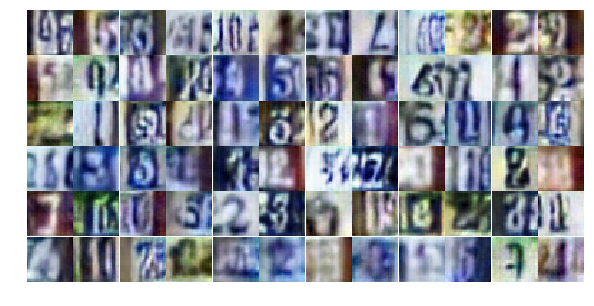

Epoch 15/25... Discriminator Loss: 1.2050... Generator Loss: 0.9196
Epoch 15/25... Discriminator Loss: 1.1692... Generator Loss: 0.7138
Epoch 15/25... Discriminator Loss: 1.1503... Generator Loss: 0.8469
Epoch 15/25... Discriminator Loss: 1.1271... Generator Loss: 0.8137
Epoch 15/25... Discriminator Loss: 1.2016... Generator Loss: 0.8164
Epoch 15/25... Discriminator Loss: 1.1877... Generator Loss: 0.8072
Epoch 15/25... Discriminator Loss: 1.1368... Generator Loss: 0.9023
Epoch 15/25... Discriminator Loss: 1.2301... Generator Loss: 0.9151
Epoch 15/25... Discriminator Loss: 1.1153... Generator Loss: 0.7380
Epoch 15/25... Discriminator Loss: 1.2213... Generator Loss: 0.7962


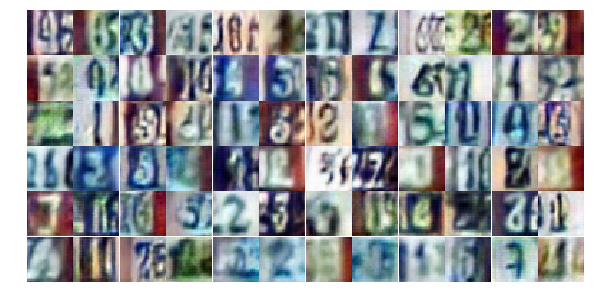

Epoch 15/25... Discriminator Loss: 1.1375... Generator Loss: 0.9546
Epoch 15/25... Discriminator Loss: 1.2462... Generator Loss: 0.8806
Epoch 15/25... Discriminator Loss: 1.1814... Generator Loss: 0.8941
Epoch 15/25... Discriminator Loss: 1.1726... Generator Loss: 0.8578
Epoch 15/25... Discriminator Loss: 1.1385... Generator Loss: 0.7490
Epoch 15/25... Discriminator Loss: 1.2759... Generator Loss: 0.7719
Epoch 15/25... Discriminator Loss: 1.0885... Generator Loss: 0.9540
Epoch 15/25... Discriminator Loss: 1.1400... Generator Loss: 0.7525
Epoch 15/25... Discriminator Loss: 1.1447... Generator Loss: 0.8364
Epoch 15/25... Discriminator Loss: 1.1753... Generator Loss: 0.7292


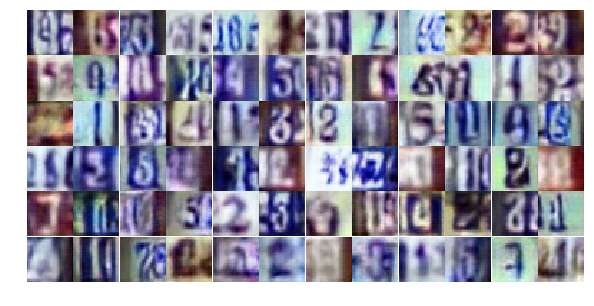

Epoch 15/25... Discriminator Loss: 1.1716... Generator Loss: 0.8271
Epoch 15/25... Discriminator Loss: 1.1613... Generator Loss: 0.9627
Epoch 15/25... Discriminator Loss: 1.2685... Generator Loss: 0.7677
Epoch 15/25... Discriminator Loss: 1.1986... Generator Loss: 0.7749
Epoch 15/25... Discriminator Loss: 1.1341... Generator Loss: 0.8124
Epoch 15/25... Discriminator Loss: 1.2219... Generator Loss: 0.7823
Epoch 15/25... Discriminator Loss: 1.2307... Generator Loss: 0.8113
Epoch 15/25... Discriminator Loss: 1.1923... Generator Loss: 0.8451
Epoch 15/25... Discriminator Loss: 1.1990... Generator Loss: 0.7395
Epoch 16/25... Discriminator Loss: 1.1980... Generator Loss: 0.8128


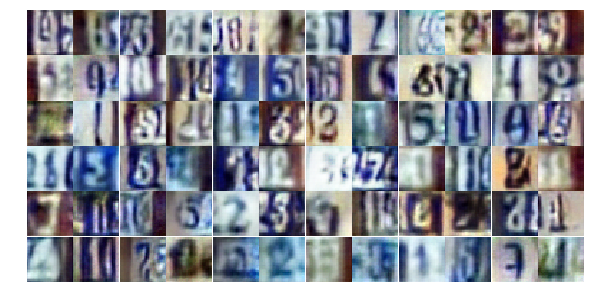

Epoch 16/25... Discriminator Loss: 1.1209... Generator Loss: 0.8707
Epoch 16/25... Discriminator Loss: 1.1437... Generator Loss: 0.8205
Epoch 16/25... Discriminator Loss: 1.2053... Generator Loss: 0.7921
Epoch 16/25... Discriminator Loss: 1.1573... Generator Loss: 0.9013
Epoch 16/25... Discriminator Loss: 1.1831... Generator Loss: 0.9077
Epoch 16/25... Discriminator Loss: 1.1128... Generator Loss: 0.7571
Epoch 16/25... Discriminator Loss: 1.1622... Generator Loss: 0.7945
Epoch 16/25... Discriminator Loss: 1.2677... Generator Loss: 0.8053
Epoch 16/25... Discriminator Loss: 1.1813... Generator Loss: 0.7978
Epoch 16/25... Discriminator Loss: 1.2440... Generator Loss: 0.9887


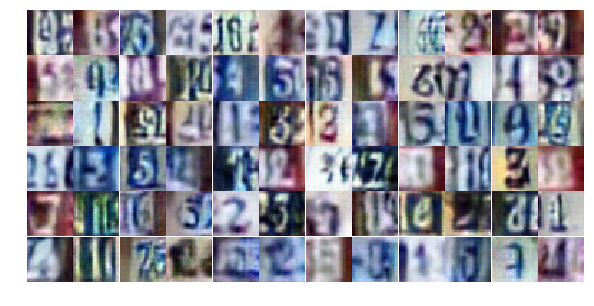

Epoch 16/25... Discriminator Loss: 1.1616... Generator Loss: 0.8970
Epoch 16/25... Discriminator Loss: 1.0929... Generator Loss: 0.8542
Epoch 16/25... Discriminator Loss: 1.2308... Generator Loss: 0.9985
Epoch 16/25... Discriminator Loss: 1.3010... Generator Loss: 0.7878
Epoch 16/25... Discriminator Loss: 1.2025... Generator Loss: 0.8621
Epoch 16/25... Discriminator Loss: 1.1278... Generator Loss: 0.8962
Epoch 16/25... Discriminator Loss: 1.2044... Generator Loss: 0.7967
Epoch 16/25... Discriminator Loss: 1.0658... Generator Loss: 1.0184
Epoch 16/25... Discriminator Loss: 1.1511... Generator Loss: 0.8933
Epoch 16/25... Discriminator Loss: 1.2743... Generator Loss: 0.7604


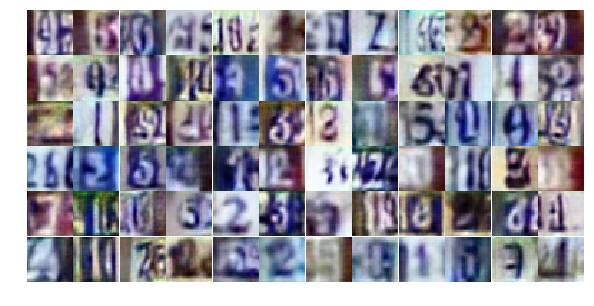

Epoch 16/25... Discriminator Loss: 1.1565... Generator Loss: 0.8351
Epoch 16/25... Discriminator Loss: 1.2110... Generator Loss: 0.8526
Epoch 16/25... Discriminator Loss: 1.1963... Generator Loss: 0.8200
Epoch 16/25... Discriminator Loss: 1.2003... Generator Loss: 0.7957
Epoch 16/25... Discriminator Loss: 1.1851... Generator Loss: 0.7981
Epoch 16/25... Discriminator Loss: 1.2154... Generator Loss: 0.8820
Epoch 16/25... Discriminator Loss: 1.1691... Generator Loss: 0.9059
Epoch 16/25... Discriminator Loss: 1.1504... Generator Loss: 0.8616
Epoch 16/25... Discriminator Loss: 1.2498... Generator Loss: 0.9220
Epoch 16/25... Discriminator Loss: 1.1375... Generator Loss: 0.8860


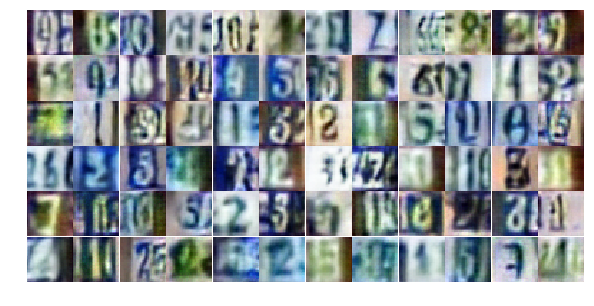

Epoch 16/25... Discriminator Loss: 1.0846... Generator Loss: 0.9580
Epoch 16/25... Discriminator Loss: 1.1935... Generator Loss: 0.8669
Epoch 16/25... Discriminator Loss: 1.2618... Generator Loss: 0.8818
Epoch 16/25... Discriminator Loss: 1.2433... Generator Loss: 0.8372
Epoch 16/25... Discriminator Loss: 1.1401... Generator Loss: 0.8129
Epoch 16/25... Discriminator Loss: 1.3232... Generator Loss: 0.9565
Epoch 16/25... Discriminator Loss: 1.1597... Generator Loss: 0.9618
Epoch 16/25... Discriminator Loss: 1.1932... Generator Loss: 0.7755
Epoch 16/25... Discriminator Loss: 1.1460... Generator Loss: 0.8066
Epoch 16/25... Discriminator Loss: 1.1403... Generator Loss: 0.8657


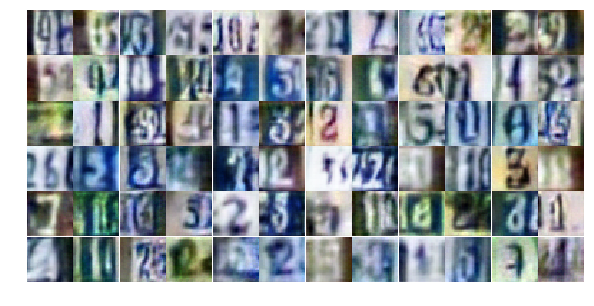

Epoch 16/25... Discriminator Loss: 1.1505... Generator Loss: 0.9880
Epoch 16/25... Discriminator Loss: 1.3116... Generator Loss: 0.7355
Epoch 16/25... Discriminator Loss: 1.1562... Generator Loss: 0.9592
Epoch 16/25... Discriminator Loss: 1.1896... Generator Loss: 0.7327
Epoch 16/25... Discriminator Loss: 1.1846... Generator Loss: 0.9102
Epoch 16/25... Discriminator Loss: 1.1653... Generator Loss: 0.7670
Epoch 16/25... Discriminator Loss: 1.1333... Generator Loss: 0.9005
Epoch 16/25... Discriminator Loss: 1.1348... Generator Loss: 0.9937
Epoch 16/25... Discriminator Loss: 1.1806... Generator Loss: 0.7571
Epoch 16/25... Discriminator Loss: 1.3350... Generator Loss: 0.7053


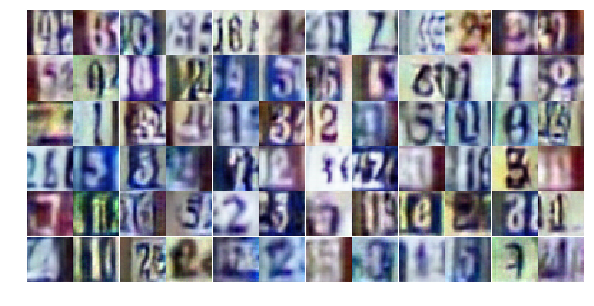

Epoch 16/25... Discriminator Loss: 1.1775... Generator Loss: 0.7828
Epoch 16/25... Discriminator Loss: 1.2210... Generator Loss: 0.9060
Epoch 16/25... Discriminator Loss: 1.2329... Generator Loss: 0.8695
Epoch 16/25... Discriminator Loss: 1.1466... Generator Loss: 0.9648
Epoch 16/25... Discriminator Loss: 1.2092... Generator Loss: 0.7785
Epoch 16/25... Discriminator Loss: 1.2369... Generator Loss: 0.7286
Epoch 17/25... Discriminator Loss: 1.2116... Generator Loss: 0.8912
Epoch 17/25... Discriminator Loss: 1.1331... Generator Loss: 0.9003
Epoch 17/25... Discriminator Loss: 1.1009... Generator Loss: 0.7959
Epoch 17/25... Discriminator Loss: 1.1731... Generator Loss: 0.9385


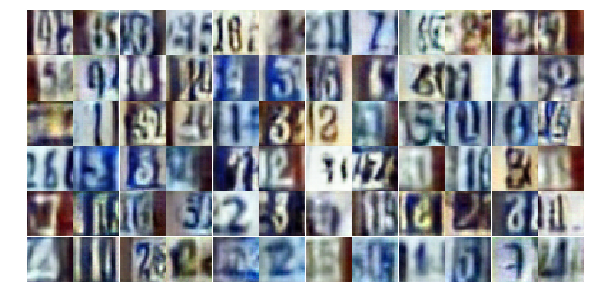

Epoch 17/25... Discriminator Loss: 1.1987... Generator Loss: 0.8035
Epoch 17/25... Discriminator Loss: 1.0776... Generator Loss: 0.9805
Epoch 17/25... Discriminator Loss: 1.0737... Generator Loss: 0.9174
Epoch 17/25... Discriminator Loss: 1.0870... Generator Loss: 0.9568
Epoch 17/25... Discriminator Loss: 1.1897... Generator Loss: 0.7692
Epoch 17/25... Discriminator Loss: 1.2409... Generator Loss: 0.8520
Epoch 17/25... Discriminator Loss: 1.1278... Generator Loss: 1.0652
Epoch 17/25... Discriminator Loss: 1.1345... Generator Loss: 0.9002
Epoch 17/25... Discriminator Loss: 1.1779... Generator Loss: 0.8029
Epoch 17/25... Discriminator Loss: 1.2124... Generator Loss: 0.9133


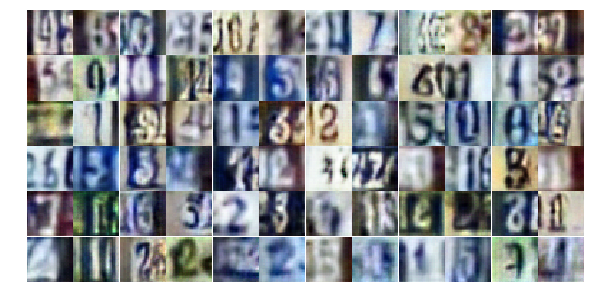

Epoch 17/25... Discriminator Loss: 1.2067... Generator Loss: 0.7994
Epoch 17/25... Discriminator Loss: 1.2232... Generator Loss: 0.9569
Epoch 17/25... Discriminator Loss: 1.0698... Generator Loss: 0.9184
Epoch 17/25... Discriminator Loss: 1.2037... Generator Loss: 0.8780
Epoch 17/25... Discriminator Loss: 1.1892... Generator Loss: 0.8702
Epoch 17/25... Discriminator Loss: 1.3218... Generator Loss: 0.7103
Epoch 17/25... Discriminator Loss: 1.1445... Generator Loss: 0.9166
Epoch 17/25... Discriminator Loss: 1.1228... Generator Loss: 0.8520
Epoch 17/25... Discriminator Loss: 1.0691... Generator Loss: 0.9658
Epoch 17/25... Discriminator Loss: 1.1874... Generator Loss: 0.8541


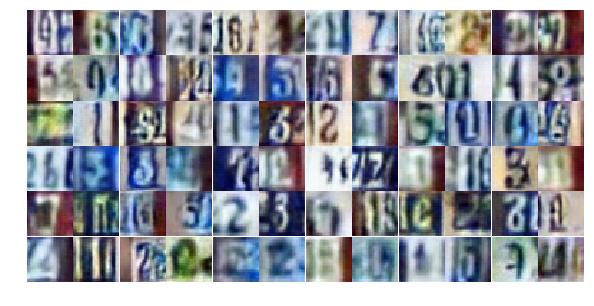

Epoch 17/25... Discriminator Loss: 1.2522... Generator Loss: 0.8089
Epoch 17/25... Discriminator Loss: 1.1110... Generator Loss: 0.8591
Epoch 17/25... Discriminator Loss: 1.2680... Generator Loss: 1.0024
Epoch 17/25... Discriminator Loss: 1.2133... Generator Loss: 0.8759
Epoch 17/25... Discriminator Loss: 1.2340... Generator Loss: 0.8494
Epoch 17/25... Discriminator Loss: 1.2168... Generator Loss: 0.8937
Epoch 17/25... Discriminator Loss: 1.1666... Generator Loss: 0.8068
Epoch 17/25... Discriminator Loss: 1.1922... Generator Loss: 0.8423
Epoch 17/25... Discriminator Loss: 1.2129... Generator Loss: 0.7709
Epoch 17/25... Discriminator Loss: 1.2210... Generator Loss: 0.8043


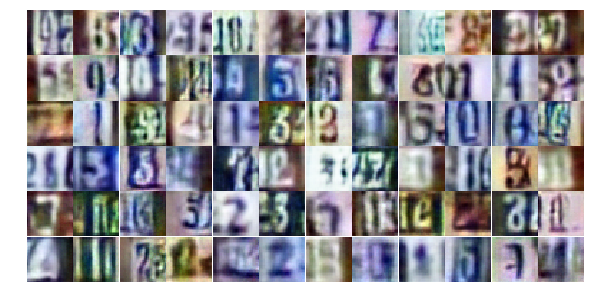

Epoch 17/25... Discriminator Loss: 1.1441... Generator Loss: 0.9031
Epoch 17/25... Discriminator Loss: 1.2297... Generator Loss: 0.8349
Epoch 17/25... Discriminator Loss: 1.1043... Generator Loss: 0.8875
Epoch 17/25... Discriminator Loss: 1.1335... Generator Loss: 0.8621
Epoch 17/25... Discriminator Loss: 1.2071... Generator Loss: 0.8552
Epoch 17/25... Discriminator Loss: 1.2279... Generator Loss: 0.8491
Epoch 17/25... Discriminator Loss: 1.2048... Generator Loss: 0.7482
Epoch 17/25... Discriminator Loss: 1.1085... Generator Loss: 0.9613
Epoch 17/25... Discriminator Loss: 1.1571... Generator Loss: 1.0765
Epoch 17/25... Discriminator Loss: 1.1993... Generator Loss: 0.8103


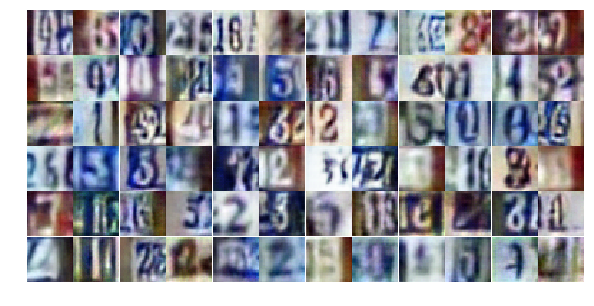

Epoch 17/25... Discriminator Loss: 1.1854... Generator Loss: 0.7324
Epoch 17/25... Discriminator Loss: 1.0527... Generator Loss: 0.9771
Epoch 17/25... Discriminator Loss: 1.2184... Generator Loss: 0.8479
Epoch 17/25... Discriminator Loss: 1.1452... Generator Loss: 0.8823
Epoch 17/25... Discriminator Loss: 1.1597... Generator Loss: 0.7663
Epoch 17/25... Discriminator Loss: 1.1567... Generator Loss: 0.9112
Epoch 17/25... Discriminator Loss: 1.1238... Generator Loss: 0.8877
Epoch 17/25... Discriminator Loss: 1.0467... Generator Loss: 0.8799
Epoch 17/25... Discriminator Loss: 1.1654... Generator Loss: 0.8637
Epoch 17/25... Discriminator Loss: 1.3262... Generator Loss: 0.8021


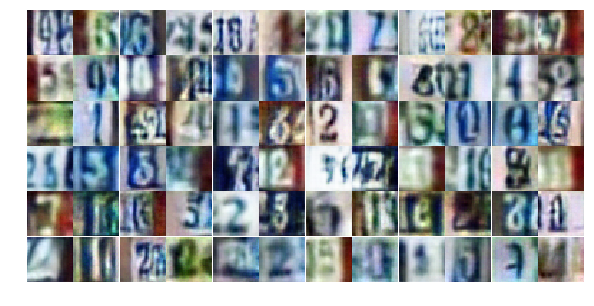

Epoch 17/25... Discriminator Loss: 1.0949... Generator Loss: 0.7996
Epoch 17/25... Discriminator Loss: 1.1484... Generator Loss: 0.8311
Epoch 17/25... Discriminator Loss: 1.1337... Generator Loss: 0.9655
Epoch 17/25... Discriminator Loss: 1.1090... Generator Loss: 0.9266
Epoch 18/25... Discriminator Loss: 1.2099... Generator Loss: 0.8677
Epoch 18/25... Discriminator Loss: 1.1915... Generator Loss: 0.7632
Epoch 18/25... Discriminator Loss: 1.1499... Generator Loss: 1.0022
Epoch 18/25... Discriminator Loss: 1.0983... Generator Loss: 0.8291
Epoch 18/25... Discriminator Loss: 1.2121... Generator Loss: 0.7866
Epoch 18/25... Discriminator Loss: 1.2336... Generator Loss: 0.8920


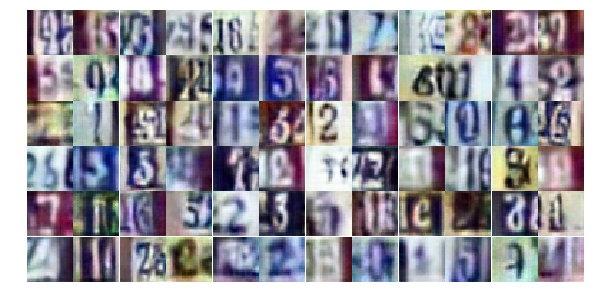

Epoch 18/25... Discriminator Loss: 1.1930... Generator Loss: 0.8936
Epoch 18/25... Discriminator Loss: 1.1149... Generator Loss: 0.8527
Epoch 18/25... Discriminator Loss: 1.2167... Generator Loss: 0.8527
Epoch 18/25... Discriminator Loss: 1.1713... Generator Loss: 0.9380
Epoch 18/25... Discriminator Loss: 1.1563... Generator Loss: 0.8922
Epoch 18/25... Discriminator Loss: 1.2297... Generator Loss: 0.8721
Epoch 18/25... Discriminator Loss: 1.1968... Generator Loss: 0.8941
Epoch 18/25... Discriminator Loss: 1.2157... Generator Loss: 1.0258
Epoch 18/25... Discriminator Loss: 1.2252... Generator Loss: 0.7720
Epoch 18/25... Discriminator Loss: 1.0901... Generator Loss: 0.8474


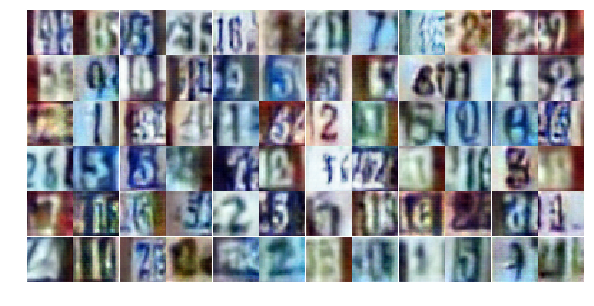

Epoch 18/25... Discriminator Loss: 1.1093... Generator Loss: 0.8848
Epoch 18/25... Discriminator Loss: 1.1217... Generator Loss: 0.8478
Epoch 18/25... Discriminator Loss: 1.2301... Generator Loss: 0.8556
Epoch 18/25... Discriminator Loss: 1.0909... Generator Loss: 0.8648
Epoch 18/25... Discriminator Loss: 1.1657... Generator Loss: 0.8903
Epoch 18/25... Discriminator Loss: 1.1507... Generator Loss: 0.7378
Epoch 18/25... Discriminator Loss: 1.1976... Generator Loss: 0.7927
Epoch 18/25... Discriminator Loss: 1.1173... Generator Loss: 0.8787
Epoch 18/25... Discriminator Loss: 1.0914... Generator Loss: 0.9163
Epoch 18/25... Discriminator Loss: 1.1474... Generator Loss: 0.7670


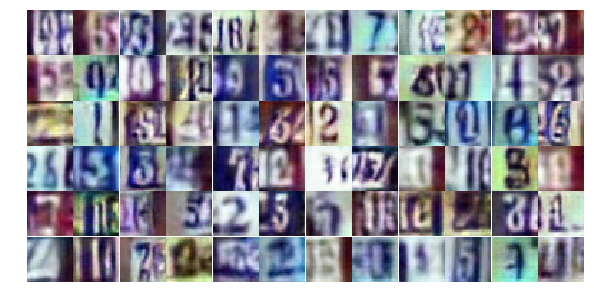

Epoch 18/25... Discriminator Loss: 1.1403... Generator Loss: 0.9437
Epoch 18/25... Discriminator Loss: 1.1756... Generator Loss: 0.7690
Epoch 18/25... Discriminator Loss: 1.2138... Generator Loss: 0.8903
Epoch 18/25... Discriminator Loss: 1.0899... Generator Loss: 0.8404
Epoch 18/25... Discriminator Loss: 1.1655... Generator Loss: 0.8049
Epoch 18/25... Discriminator Loss: 1.2232... Generator Loss: 0.9120
Epoch 18/25... Discriminator Loss: 1.1730... Generator Loss: 0.8466
Epoch 18/25... Discriminator Loss: 1.1415... Generator Loss: 0.8787
Epoch 18/25... Discriminator Loss: 1.1445... Generator Loss: 0.8743
Epoch 18/25... Discriminator Loss: 1.1916... Generator Loss: 0.8989


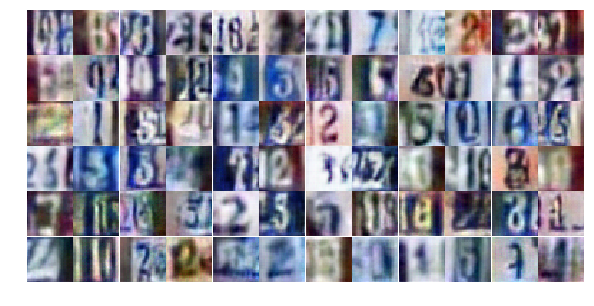

Epoch 18/25... Discriminator Loss: 1.1428... Generator Loss: 1.0056
Epoch 18/25... Discriminator Loss: 1.1122... Generator Loss: 0.8251
Epoch 18/25... Discriminator Loss: 1.2083... Generator Loss: 0.8692
Epoch 18/25... Discriminator Loss: 1.1492... Generator Loss: 0.7966
Epoch 18/25... Discriminator Loss: 1.2348... Generator Loss: 0.8252
Epoch 18/25... Discriminator Loss: 1.1498... Generator Loss: 0.8235
Epoch 18/25... Discriminator Loss: 1.2502... Generator Loss: 0.8439
Epoch 18/25... Discriminator Loss: 1.1474... Generator Loss: 0.7887
Epoch 18/25... Discriminator Loss: 1.0892... Generator Loss: 0.9279
Epoch 18/25... Discriminator Loss: 1.1630... Generator Loss: 0.8401


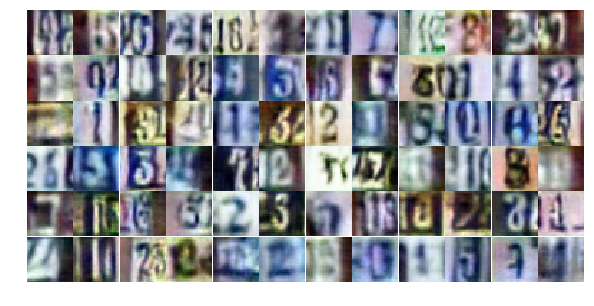

Epoch 18/25... Discriminator Loss: 1.1680... Generator Loss: 0.8897
Epoch 18/25... Discriminator Loss: 1.2013... Generator Loss: 0.8264
Epoch 18/25... Discriminator Loss: 1.1870... Generator Loss: 0.8259
Epoch 18/25... Discriminator Loss: 1.2207... Generator Loss: 0.8104
Epoch 18/25... Discriminator Loss: 1.1535... Generator Loss: 0.7671
Epoch 18/25... Discriminator Loss: 1.1199... Generator Loss: 0.9150
Epoch 18/25... Discriminator Loss: 1.1960... Generator Loss: 0.8287
Epoch 18/25... Discriminator Loss: 1.0860... Generator Loss: 0.8945
Epoch 18/25... Discriminator Loss: 1.2449... Generator Loss: 0.8479
Epoch 18/25... Discriminator Loss: 1.3041... Generator Loss: 0.9148


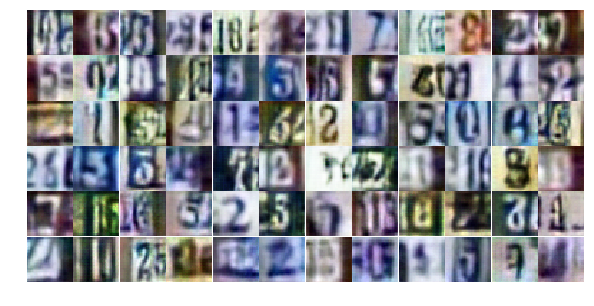

Epoch 18/25... Discriminator Loss: 1.2301... Generator Loss: 0.7940
Epoch 19/25... Discriminator Loss: 1.1880... Generator Loss: 0.8108
Epoch 19/25... Discriminator Loss: 1.2272... Generator Loss: 0.8287
Epoch 19/25... Discriminator Loss: 1.2345... Generator Loss: 0.9088
Epoch 19/25... Discriminator Loss: 1.2181... Generator Loss: 0.7350
Epoch 19/25... Discriminator Loss: 1.2529... Generator Loss: 0.8612
Epoch 19/25... Discriminator Loss: 1.1764... Generator Loss: 0.8265
Epoch 19/25... Discriminator Loss: 1.2019... Generator Loss: 0.8116
Epoch 19/25... Discriminator Loss: 1.1860... Generator Loss: 0.8363
Epoch 19/25... Discriminator Loss: 1.1552... Generator Loss: 0.8651


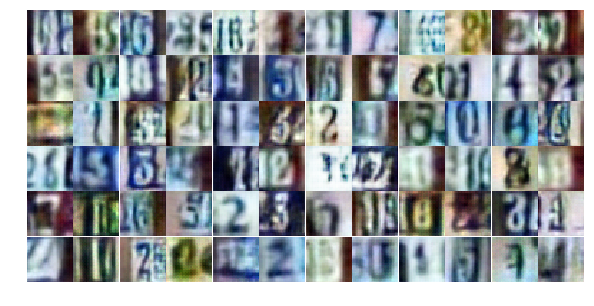

Epoch 19/25... Discriminator Loss: 1.1696... Generator Loss: 0.8998
Epoch 19/25... Discriminator Loss: 1.1521... Generator Loss: 0.9237
Epoch 19/25... Discriminator Loss: 1.2130... Generator Loss: 0.8859
Epoch 19/25... Discriminator Loss: 1.0622... Generator Loss: 0.8815
Epoch 19/25... Discriminator Loss: 1.0800... Generator Loss: 0.7594
Epoch 19/25... Discriminator Loss: 1.1640... Generator Loss: 0.9340
Epoch 19/25... Discriminator Loss: 1.2187... Generator Loss: 0.7875
Epoch 19/25... Discriminator Loss: 1.1864... Generator Loss: 1.0249
Epoch 19/25... Discriminator Loss: 1.1781... Generator Loss: 0.7739
Epoch 19/25... Discriminator Loss: 1.1932... Generator Loss: 0.8153


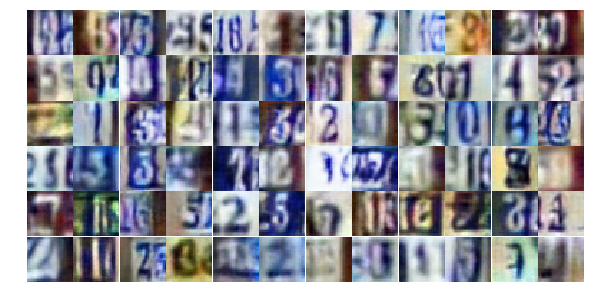

Epoch 19/25... Discriminator Loss: 1.1317... Generator Loss: 0.8638
Epoch 19/25... Discriminator Loss: 1.2153... Generator Loss: 0.8041
Epoch 19/25... Discriminator Loss: 1.2681... Generator Loss: 0.7531
Epoch 19/25... Discriminator Loss: 1.1908... Generator Loss: 1.0168
Epoch 19/25... Discriminator Loss: 1.1823... Generator Loss: 0.8580
Epoch 19/25... Discriminator Loss: 1.1751... Generator Loss: 0.8636
Epoch 19/25... Discriminator Loss: 1.1173... Generator Loss: 0.9554
Epoch 19/25... Discriminator Loss: 1.1934... Generator Loss: 0.7740
Epoch 19/25... Discriminator Loss: 1.1010... Generator Loss: 0.8533
Epoch 19/25... Discriminator Loss: 1.1390... Generator Loss: 0.7606


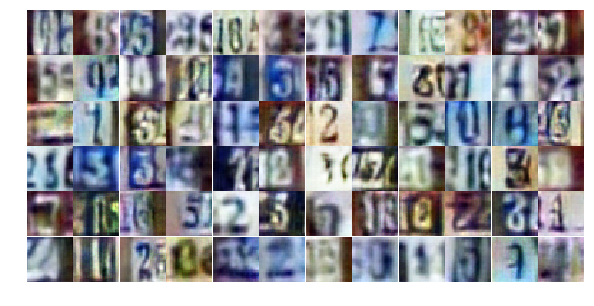

Epoch 19/25... Discriminator Loss: 1.1896... Generator Loss: 0.8656
Epoch 19/25... Discriminator Loss: 1.2641... Generator Loss: 0.7916
Epoch 19/25... Discriminator Loss: 1.1528... Generator Loss: 0.8437
Epoch 19/25... Discriminator Loss: 1.1323... Generator Loss: 0.8099
Epoch 19/25... Discriminator Loss: 1.1396... Generator Loss: 0.9470
Epoch 19/25... Discriminator Loss: 1.2120... Generator Loss: 0.7935
Epoch 19/25... Discriminator Loss: 1.1565... Generator Loss: 0.8789
Epoch 19/25... Discriminator Loss: 1.1751... Generator Loss: 0.9301
Epoch 19/25... Discriminator Loss: 1.1764... Generator Loss: 0.7839
Epoch 19/25... Discriminator Loss: 1.1214... Generator Loss: 0.8423


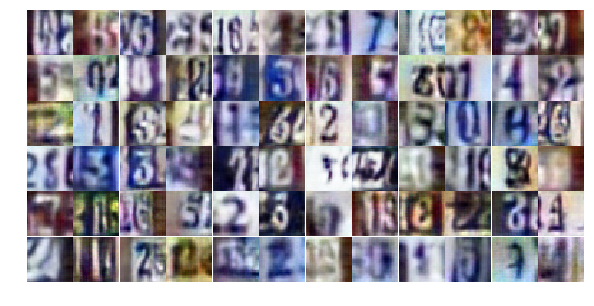

Epoch 19/25... Discriminator Loss: 1.0358... Generator Loss: 0.9252
Epoch 19/25... Discriminator Loss: 1.1861... Generator Loss: 0.6924
Epoch 19/25... Discriminator Loss: 1.2128... Generator Loss: 0.8570
Epoch 19/25... Discriminator Loss: 1.2518... Generator Loss: 0.9435
Epoch 19/25... Discriminator Loss: 1.2730... Generator Loss: 0.8132
Epoch 19/25... Discriminator Loss: 1.1897... Generator Loss: 0.8298
Epoch 19/25... Discriminator Loss: 1.2255... Generator Loss: 0.8722
Epoch 19/25... Discriminator Loss: 1.0352... Generator Loss: 0.8541
Epoch 19/25... Discriminator Loss: 1.1701... Generator Loss: 0.9885
Epoch 19/25... Discriminator Loss: 1.0983... Generator Loss: 0.8323


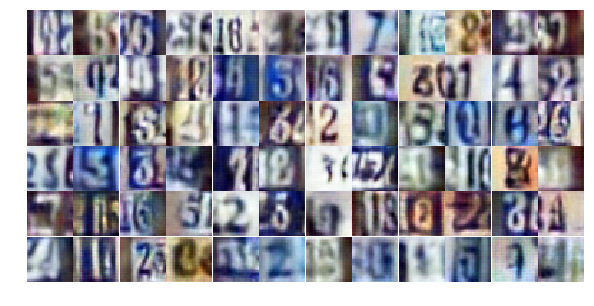

Epoch 19/25... Discriminator Loss: 1.2292... Generator Loss: 0.7752
Epoch 19/25... Discriminator Loss: 1.1343... Generator Loss: 0.9508
Epoch 19/25... Discriminator Loss: 1.2824... Generator Loss: 0.8590
Epoch 19/25... Discriminator Loss: 1.2550... Generator Loss: 0.8984
Epoch 19/25... Discriminator Loss: 1.1404... Generator Loss: 0.8406
Epoch 19/25... Discriminator Loss: 1.1402... Generator Loss: 0.9714
Epoch 19/25... Discriminator Loss: 1.2591... Generator Loss: 0.8211
Epoch 19/25... Discriminator Loss: 1.1386... Generator Loss: 1.1069
Epoch 20/25... Discriminator Loss: 1.1743... Generator Loss: 0.8278
Epoch 20/25... Discriminator Loss: 1.1800... Generator Loss: 0.9834


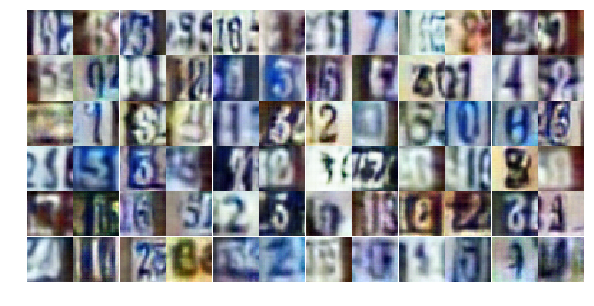

Epoch 20/25... Discriminator Loss: 1.1721... Generator Loss: 0.7597
Epoch 20/25... Discriminator Loss: 1.2151... Generator Loss: 0.7809
Epoch 20/25... Discriminator Loss: 1.2207... Generator Loss: 0.8553
Epoch 20/25... Discriminator Loss: 1.2612... Generator Loss: 0.8463
Epoch 20/25... Discriminator Loss: 1.1458... Generator Loss: 0.8629
Epoch 20/25... Discriminator Loss: 1.2861... Generator Loss: 0.7622
Epoch 20/25... Discriminator Loss: 1.1698... Generator Loss: 0.9496
Epoch 20/25... Discriminator Loss: 1.2082... Generator Loss: 0.8313
Epoch 20/25... Discriminator Loss: 1.2102... Generator Loss: 0.9123
Epoch 20/25... Discriminator Loss: 1.1618... Generator Loss: 0.7860


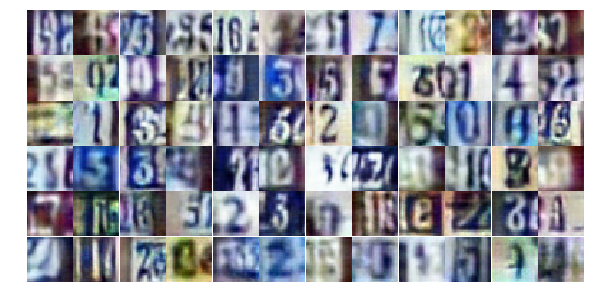

Epoch 20/25... Discriminator Loss: 1.1574... Generator Loss: 0.7722
Epoch 20/25... Discriminator Loss: 1.1484... Generator Loss: 0.8866
Epoch 20/25... Discriminator Loss: 1.1736... Generator Loss: 0.9188
Epoch 20/25... Discriminator Loss: 1.2149... Generator Loss: 0.8737
Epoch 20/25... Discriminator Loss: 1.2446... Generator Loss: 0.8872
Epoch 20/25... Discriminator Loss: 1.2170... Generator Loss: 0.8485
Epoch 20/25... Discriminator Loss: 1.2469... Generator Loss: 0.7256
Epoch 20/25... Discriminator Loss: 1.1044... Generator Loss: 0.8661
Epoch 20/25... Discriminator Loss: 1.2122... Generator Loss: 0.9944
Epoch 20/25... Discriminator Loss: 1.1680... Generator Loss: 0.8668


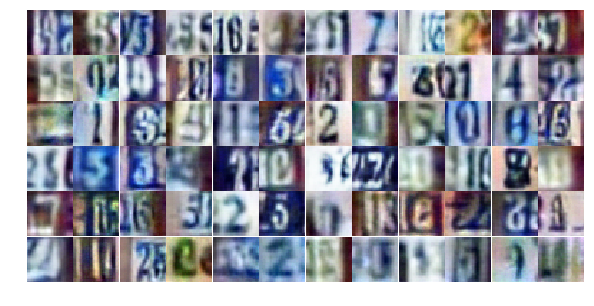

Epoch 20/25... Discriminator Loss: 1.1539... Generator Loss: 0.8799
Epoch 20/25... Discriminator Loss: 1.1365... Generator Loss: 0.8900
Epoch 20/25... Discriminator Loss: 1.1835... Generator Loss: 0.9059
Epoch 20/25... Discriminator Loss: 1.1830... Generator Loss: 0.8459
Epoch 20/25... Discriminator Loss: 1.1698... Generator Loss: 0.7725
Epoch 20/25... Discriminator Loss: 1.1546... Generator Loss: 0.9029
Epoch 20/25... Discriminator Loss: 1.1848... Generator Loss: 0.7967
Epoch 20/25... Discriminator Loss: 1.2151... Generator Loss: 0.7372
Epoch 20/25... Discriminator Loss: 1.1841... Generator Loss: 0.8219
Epoch 20/25... Discriminator Loss: 1.0778... Generator Loss: 0.9595


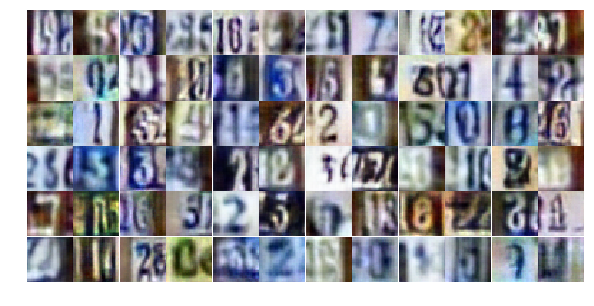

Epoch 20/25... Discriminator Loss: 1.2102... Generator Loss: 0.7717
Epoch 20/25... Discriminator Loss: 1.1943... Generator Loss: 0.9074
Epoch 20/25... Discriminator Loss: 1.3126... Generator Loss: 0.7322
Epoch 20/25... Discriminator Loss: 1.2495... Generator Loss: 0.8288
Epoch 20/25... Discriminator Loss: 1.1411... Generator Loss: 0.9763
Epoch 20/25... Discriminator Loss: 1.1658... Generator Loss: 0.8066
Epoch 20/25... Discriminator Loss: 1.1512... Generator Loss: 0.8287
Epoch 20/25... Discriminator Loss: 1.1490... Generator Loss: 0.9116
Epoch 20/25... Discriminator Loss: 1.1969... Generator Loss: 0.8346
Epoch 20/25... Discriminator Loss: 1.0851... Generator Loss: 0.9282


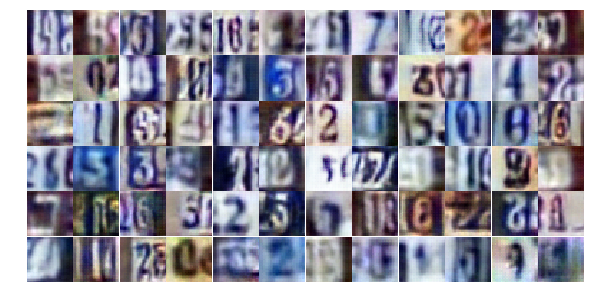

Epoch 20/25... Discriminator Loss: 1.1579... Generator Loss: 0.8044
Epoch 20/25... Discriminator Loss: 1.2046... Generator Loss: 0.8311
Epoch 20/25... Discriminator Loss: 1.1495... Generator Loss: 0.8603
Epoch 20/25... Discriminator Loss: 1.2386... Generator Loss: 0.8386
Epoch 20/25... Discriminator Loss: 1.1700... Generator Loss: 0.9066
Epoch 20/25... Discriminator Loss: 1.1563... Generator Loss: 0.8828
Epoch 20/25... Discriminator Loss: 1.1279... Generator Loss: 0.8282
Epoch 20/25... Discriminator Loss: 1.1093... Generator Loss: 1.0136
Epoch 20/25... Discriminator Loss: 1.1207... Generator Loss: 0.8796
Epoch 20/25... Discriminator Loss: 1.0915... Generator Loss: 0.9363


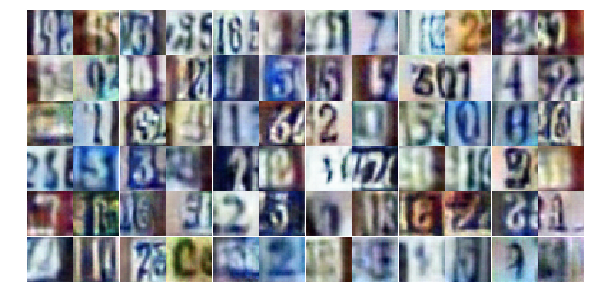

Epoch 20/25... Discriminator Loss: 1.1372... Generator Loss: 0.9054
Epoch 20/25... Discriminator Loss: 1.2288... Generator Loss: 0.7636
Epoch 20/25... Discriminator Loss: 1.1712... Generator Loss: 0.9271
Epoch 20/25... Discriminator Loss: 1.1757... Generator Loss: 0.9075
Epoch 20/25... Discriminator Loss: 1.1782... Generator Loss: 0.9148
Epoch 20/25... Discriminator Loss: 0.9127... Generator Loss: 0.9204
Epoch 21/25... Discriminator Loss: 1.1062... Generator Loss: 0.8700
Epoch 21/25... Discriminator Loss: 1.1628... Generator Loss: 0.8021
Epoch 21/25... Discriminator Loss: 1.2684... Generator Loss: 0.8398
Epoch 21/25... Discriminator Loss: 1.2075... Generator Loss: 0.7952


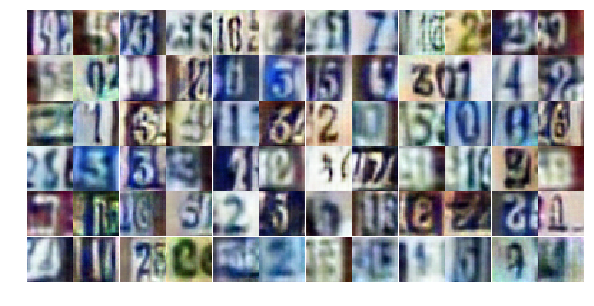

Epoch 21/25... Discriminator Loss: 1.0956... Generator Loss: 0.9076
Epoch 21/25... Discriminator Loss: 1.2605... Generator Loss: 0.8005
Epoch 21/25... Discriminator Loss: 1.0845... Generator Loss: 0.9592
Epoch 21/25... Discriminator Loss: 1.1415... Generator Loss: 0.8429
Epoch 21/25... Discriminator Loss: 1.1570... Generator Loss: 0.8764
Epoch 21/25... Discriminator Loss: 1.0190... Generator Loss: 0.9806
Epoch 21/25... Discriminator Loss: 1.1644... Generator Loss: 0.9162
Epoch 21/25... Discriminator Loss: 1.2134... Generator Loss: 0.7640
Epoch 21/25... Discriminator Loss: 1.2964... Generator Loss: 0.7508
Epoch 21/25... Discriminator Loss: 1.1830... Generator Loss: 0.9860


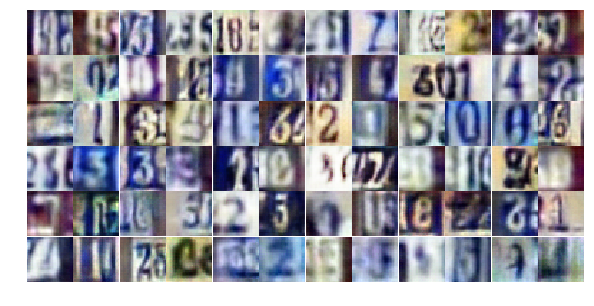

Epoch 21/25... Discriminator Loss: 1.2111... Generator Loss: 0.9668
Epoch 21/25... Discriminator Loss: 1.0712... Generator Loss: 0.9120
Epoch 21/25... Discriminator Loss: 1.2695... Generator Loss: 0.8407
Epoch 21/25... Discriminator Loss: 1.1876... Generator Loss: 0.8913
Epoch 21/25... Discriminator Loss: 1.1301... Generator Loss: 0.8596
Epoch 21/25... Discriminator Loss: 1.2390... Generator Loss: 0.8015
Epoch 21/25... Discriminator Loss: 1.1098... Generator Loss: 0.8432
Epoch 21/25... Discriminator Loss: 1.1486... Generator Loss: 0.8868
Epoch 21/25... Discriminator Loss: 1.0526... Generator Loss: 0.8478
Epoch 21/25... Discriminator Loss: 1.2127... Generator Loss: 0.8524


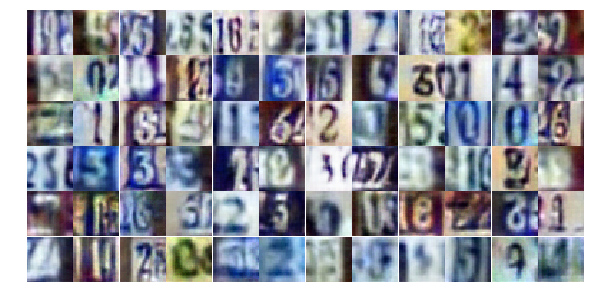

Epoch 21/25... Discriminator Loss: 1.2037... Generator Loss: 0.8113
Epoch 21/25... Discriminator Loss: 1.1635... Generator Loss: 0.9154
Epoch 21/25... Discriminator Loss: 1.2306... Generator Loss: 0.8452
Epoch 21/25... Discriminator Loss: 1.2089... Generator Loss: 0.7817
Epoch 21/25... Discriminator Loss: 1.1292... Generator Loss: 0.9611
Epoch 21/25... Discriminator Loss: 1.1528... Generator Loss: 0.9529
Epoch 21/25... Discriminator Loss: 1.1093... Generator Loss: 0.8283
Epoch 21/25... Discriminator Loss: 1.1839... Generator Loss: 0.8793
Epoch 21/25... Discriminator Loss: 1.1965... Generator Loss: 0.8556
Epoch 21/25... Discriminator Loss: 1.0783... Generator Loss: 0.9989


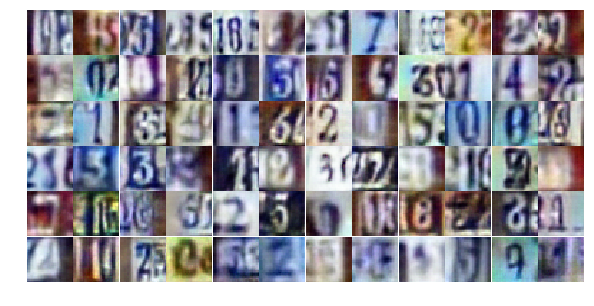

Epoch 21/25... Discriminator Loss: 1.1678... Generator Loss: 0.7918
Epoch 21/25... Discriminator Loss: 1.2383... Generator Loss: 0.8262
Epoch 21/25... Discriminator Loss: 1.1822... Generator Loss: 0.8467
Epoch 21/25... Discriminator Loss: 1.0738... Generator Loss: 0.9103
Epoch 21/25... Discriminator Loss: 1.1758... Generator Loss: 0.9812
Epoch 21/25... Discriminator Loss: 1.2138... Generator Loss: 0.8928
Epoch 21/25... Discriminator Loss: 1.1659... Generator Loss: 0.8017
Epoch 21/25... Discriminator Loss: 1.2320... Generator Loss: 0.7562
Epoch 21/25... Discriminator Loss: 1.1300... Generator Loss: 0.8380
Epoch 21/25... Discriminator Loss: 1.1779... Generator Loss: 0.8375


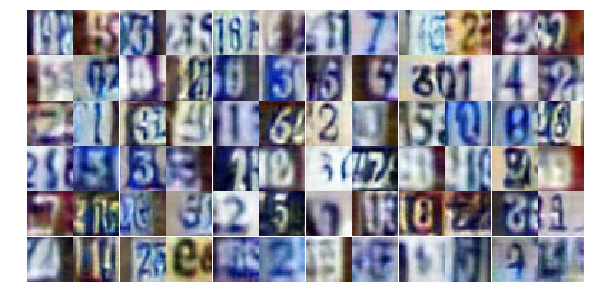

Epoch 21/25... Discriminator Loss: 1.2404... Generator Loss: 0.7728
Epoch 21/25... Discriminator Loss: 1.1447... Generator Loss: 1.0132
Epoch 21/25... Discriminator Loss: 1.2010... Generator Loss: 0.8783
Epoch 21/25... Discriminator Loss: 1.1565... Generator Loss: 0.8565
Epoch 21/25... Discriminator Loss: 1.2051... Generator Loss: 0.8067
Epoch 21/25... Discriminator Loss: 1.2539... Generator Loss: 0.7904
Epoch 21/25... Discriminator Loss: 1.1668... Generator Loss: 0.8834
Epoch 21/25... Discriminator Loss: 1.2316... Generator Loss: 0.7386
Epoch 21/25... Discriminator Loss: 1.1837... Generator Loss: 1.0334
Epoch 21/25... Discriminator Loss: 1.1579... Generator Loss: 0.8891


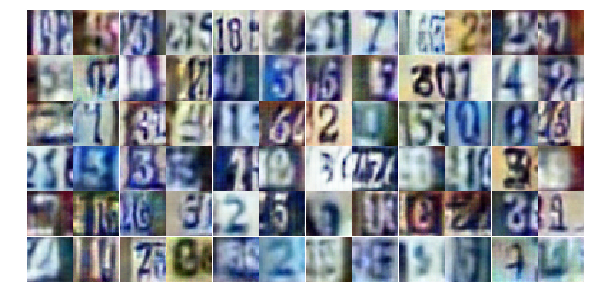

Epoch 21/25... Discriminator Loss: 1.1112... Generator Loss: 0.8431
Epoch 21/25... Discriminator Loss: 1.1689... Generator Loss: 0.9086
Epoch 21/25... Discriminator Loss: 1.3284... Generator Loss: 0.8674
Epoch 22/25... Discriminator Loss: 1.1561... Generator Loss: 0.9605
Epoch 22/25... Discriminator Loss: 1.1779... Generator Loss: 0.9040
Epoch 22/25... Discriminator Loss: 1.1837... Generator Loss: 0.9001
Epoch 22/25... Discriminator Loss: 1.2045... Generator Loss: 0.8182
Epoch 22/25... Discriminator Loss: 1.1974... Generator Loss: 0.8490
Epoch 22/25... Discriminator Loss: 1.1640... Generator Loss: 0.8442
Epoch 22/25... Discriminator Loss: 1.1686... Generator Loss: 0.7835


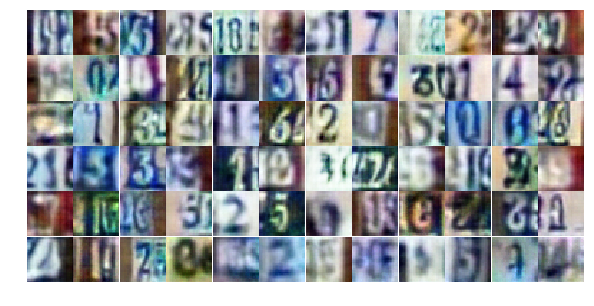

Epoch 22/25... Discriminator Loss: 1.2004... Generator Loss: 0.9740
Epoch 22/25... Discriminator Loss: 1.2067... Generator Loss: 0.7835
Epoch 22/25... Discriminator Loss: 1.2062... Generator Loss: 0.8088
Epoch 22/25... Discriminator Loss: 1.1050... Generator Loss: 0.8848
Epoch 22/25... Discriminator Loss: 1.2143... Generator Loss: 0.8831
Epoch 22/25... Discriminator Loss: 1.1325... Generator Loss: 0.9069
Epoch 22/25... Discriminator Loss: 1.1573... Generator Loss: 0.9176
Epoch 22/25... Discriminator Loss: 1.2350... Generator Loss: 0.7819
Epoch 22/25... Discriminator Loss: 1.2483... Generator Loss: 0.7659
Epoch 22/25... Discriminator Loss: 1.2335... Generator Loss: 0.7585


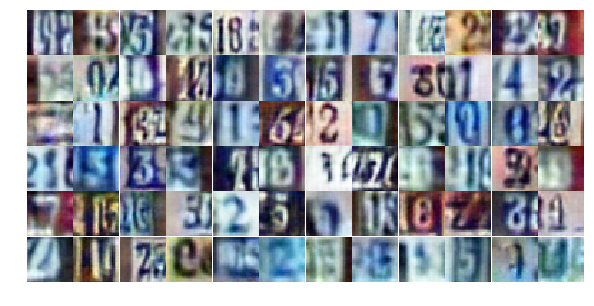

Epoch 22/25... Discriminator Loss: 1.0926... Generator Loss: 0.9072
Epoch 22/25... Discriminator Loss: 1.1414... Generator Loss: 1.1157
Epoch 22/25... Discriminator Loss: 1.2762... Generator Loss: 0.8500
Epoch 22/25... Discriminator Loss: 1.1089... Generator Loss: 0.9295
Epoch 22/25... Discriminator Loss: 1.1376... Generator Loss: 0.8173
Epoch 22/25... Discriminator Loss: 1.1848... Generator Loss: 0.7739
Epoch 22/25... Discriminator Loss: 1.0653... Generator Loss: 0.9028
Epoch 22/25... Discriminator Loss: 1.2069... Generator Loss: 0.7438
Epoch 22/25... Discriminator Loss: 1.0923... Generator Loss: 0.8745
Epoch 22/25... Discriminator Loss: 1.1569... Generator Loss: 0.8576


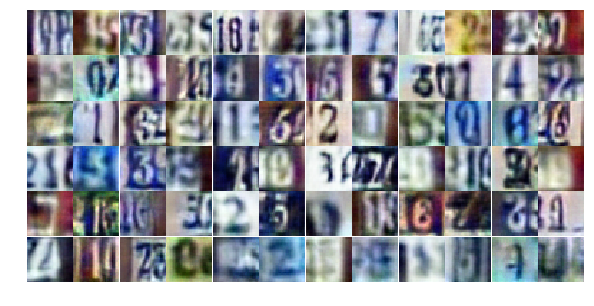

Epoch 22/25... Discriminator Loss: 1.1034... Generator Loss: 0.9766
Epoch 22/25... Discriminator Loss: 1.2340... Generator Loss: 0.7380
Epoch 22/25... Discriminator Loss: 1.2075... Generator Loss: 0.7227
Epoch 22/25... Discriminator Loss: 1.1581... Generator Loss: 0.8672
Epoch 22/25... Discriminator Loss: 1.2084... Generator Loss: 0.9014
Epoch 22/25... Discriminator Loss: 1.1111... Generator Loss: 0.7835
Epoch 22/25... Discriminator Loss: 1.1175... Generator Loss: 0.8186
Epoch 22/25... Discriminator Loss: 1.2207... Generator Loss: 0.8446
Epoch 22/25... Discriminator Loss: 1.1869... Generator Loss: 0.8972
Epoch 22/25... Discriminator Loss: 1.1947... Generator Loss: 0.8031


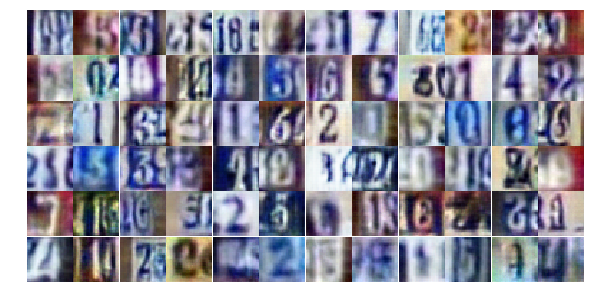

Epoch 22/25... Discriminator Loss: 1.2109... Generator Loss: 0.9029
Epoch 22/25... Discriminator Loss: 1.1231... Generator Loss: 0.9021
Epoch 22/25... Discriminator Loss: 1.1312... Generator Loss: 0.9403
Epoch 22/25... Discriminator Loss: 1.2216... Generator Loss: 1.0850
Epoch 22/25... Discriminator Loss: 1.1299... Generator Loss: 0.8862
Epoch 22/25... Discriminator Loss: 1.2111... Generator Loss: 0.8592
Epoch 22/25... Discriminator Loss: 1.1720... Generator Loss: 0.8899
Epoch 22/25... Discriminator Loss: 1.1060... Generator Loss: 0.9492
Epoch 22/25... Discriminator Loss: 1.2731... Generator Loss: 0.7763
Epoch 22/25... Discriminator Loss: 1.1930... Generator Loss: 0.8663


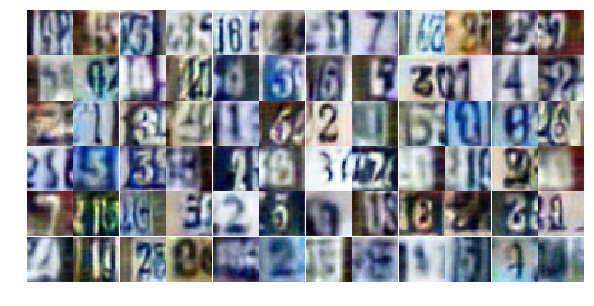

Epoch 22/25... Discriminator Loss: 1.1876... Generator Loss: 0.8026
Epoch 22/25... Discriminator Loss: 1.1766... Generator Loss: 0.8260
Epoch 22/25... Discriminator Loss: 1.2058... Generator Loss: 0.7773
Epoch 22/25... Discriminator Loss: 1.2258... Generator Loss: 0.8791
Epoch 22/25... Discriminator Loss: 1.1854... Generator Loss: 0.7658
Epoch 22/25... Discriminator Loss: 1.1339... Generator Loss: 0.8176
Epoch 22/25... Discriminator Loss: 1.2081... Generator Loss: 0.8343
Epoch 22/25... Discriminator Loss: 1.1833... Generator Loss: 0.8693
Epoch 22/25... Discriminator Loss: 1.0668... Generator Loss: 0.9285
Epoch 22/25... Discriminator Loss: 1.0780... Generator Loss: 0.9602


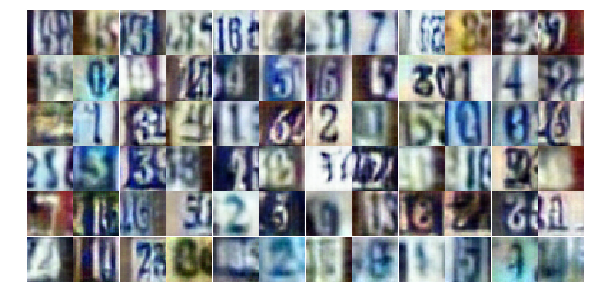

Epoch 23/25... Discriminator Loss: 1.1519... Generator Loss: 0.9147
Epoch 23/25... Discriminator Loss: 1.0919... Generator Loss: 0.9378
Epoch 23/25... Discriminator Loss: 1.2046... Generator Loss: 0.8032
Epoch 23/25... Discriminator Loss: 1.1280... Generator Loss: 0.8745
Epoch 23/25... Discriminator Loss: 1.1904... Generator Loss: 0.7516
Epoch 23/25... Discriminator Loss: 1.1608... Generator Loss: 0.8754
Epoch 23/25... Discriminator Loss: 1.2381... Generator Loss: 0.8069
Epoch 23/25... Discriminator Loss: 1.1266... Generator Loss: 0.7946
Epoch 23/25... Discriminator Loss: 1.1835... Generator Loss: 0.7968
Epoch 23/25... Discriminator Loss: 1.1378... Generator Loss: 0.8711


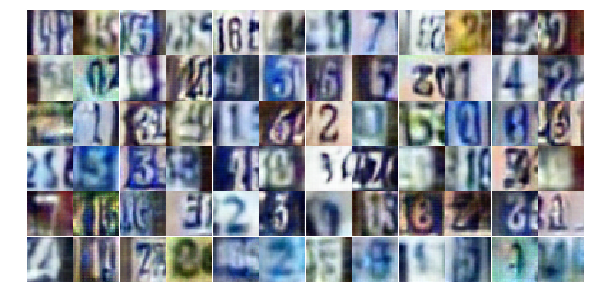

Epoch 23/25... Discriminator Loss: 1.1639... Generator Loss: 0.9301
Epoch 23/25... Discriminator Loss: 1.2096... Generator Loss: 0.9031
Epoch 23/25... Discriminator Loss: 1.1364... Generator Loss: 0.9668
Epoch 23/25... Discriminator Loss: 1.1726... Generator Loss: 0.8550
Epoch 23/25... Discriminator Loss: 1.1614... Generator Loss: 0.8918
Epoch 23/25... Discriminator Loss: 1.1379... Generator Loss: 0.9312
Epoch 23/25... Discriminator Loss: 1.0761... Generator Loss: 0.8554
Epoch 23/25... Discriminator Loss: 1.1319... Generator Loss: 0.8404
Epoch 23/25... Discriminator Loss: 1.2372... Generator Loss: 0.8619
Epoch 23/25... Discriminator Loss: 1.2041... Generator Loss: 0.8713


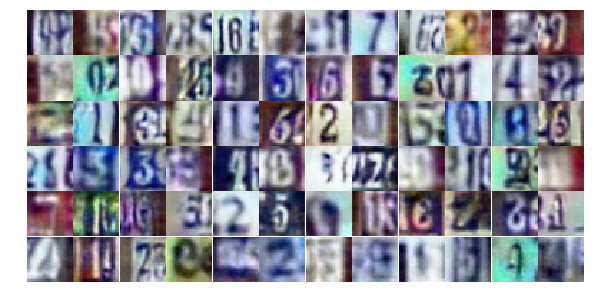

Epoch 23/25... Discriminator Loss: 1.1660... Generator Loss: 0.7790
Epoch 23/25... Discriminator Loss: 1.1113... Generator Loss: 0.9746
Epoch 23/25... Discriminator Loss: 1.2102... Generator Loss: 0.8220
Epoch 23/25... Discriminator Loss: 1.1921... Generator Loss: 0.8052
Epoch 23/25... Discriminator Loss: 1.1436... Generator Loss: 0.8316
Epoch 23/25... Discriminator Loss: 1.1304... Generator Loss: 0.8097
Epoch 23/25... Discriminator Loss: 1.1404... Generator Loss: 0.8688
Epoch 23/25... Discriminator Loss: 1.1322... Generator Loss: 0.9735
Epoch 23/25... Discriminator Loss: 1.1654... Generator Loss: 0.8104
Epoch 23/25... Discriminator Loss: 1.1066... Generator Loss: 0.7871


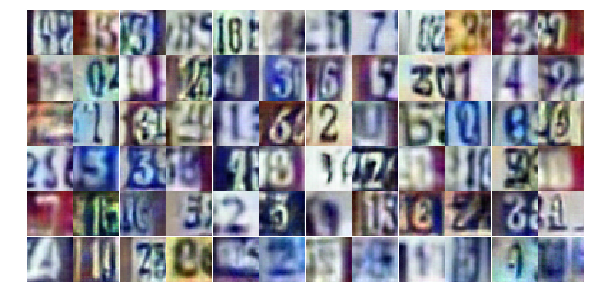

Epoch 23/25... Discriminator Loss: 1.1459... Generator Loss: 0.9285
Epoch 23/25... Discriminator Loss: 1.1055... Generator Loss: 0.9352
Epoch 23/25... Discriminator Loss: 1.1951... Generator Loss: 0.8003
Epoch 23/25... Discriminator Loss: 1.2696... Generator Loss: 0.8449
Epoch 23/25... Discriminator Loss: 1.2156... Generator Loss: 0.9641
Epoch 23/25... Discriminator Loss: 1.2221... Generator Loss: 0.7279
Epoch 23/25... Discriminator Loss: 1.1993... Generator Loss: 0.7967
Epoch 23/25... Discriminator Loss: 1.1406... Generator Loss: 0.9270
Epoch 23/25... Discriminator Loss: 1.0860... Generator Loss: 0.9377
Epoch 23/25... Discriminator Loss: 1.1678... Generator Loss: 0.9289


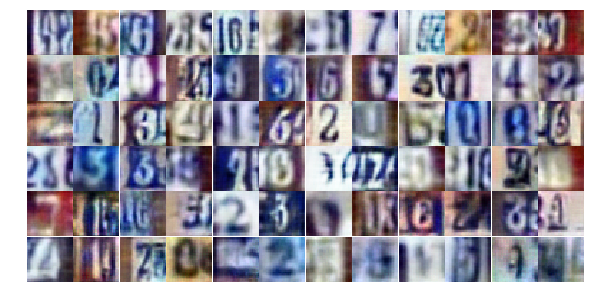

Epoch 23/25... Discriminator Loss: 1.1526... Generator Loss: 0.8733
Epoch 23/25... Discriminator Loss: 1.1686... Generator Loss: 0.9300
Epoch 23/25... Discriminator Loss: 1.2041... Generator Loss: 0.7473
Epoch 23/25... Discriminator Loss: 1.0291... Generator Loss: 0.8764
Epoch 23/25... Discriminator Loss: 1.1676... Generator Loss: 0.9042
Epoch 23/25... Discriminator Loss: 1.2027... Generator Loss: 0.8112
Epoch 23/25... Discriminator Loss: 1.1490... Generator Loss: 0.9405
Epoch 23/25... Discriminator Loss: 1.1966... Generator Loss: 0.8236
Epoch 23/25... Discriminator Loss: 1.2215... Generator Loss: 0.7684
Epoch 23/25... Discriminator Loss: 1.1576... Generator Loss: 0.9212


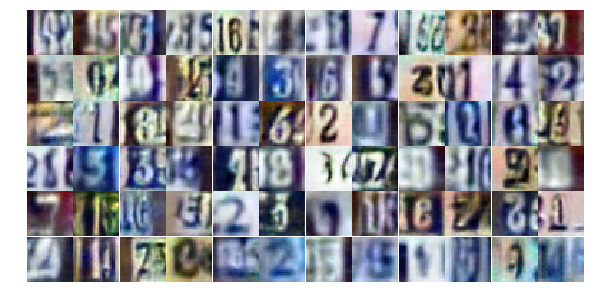

Epoch 23/25... Discriminator Loss: 1.1384... Generator Loss: 0.8778
Epoch 23/25... Discriminator Loss: 1.2761... Generator Loss: 0.8066
Epoch 23/25... Discriminator Loss: 1.1915... Generator Loss: 0.8455
Epoch 23/25... Discriminator Loss: 1.2537... Generator Loss: 0.9164
Epoch 23/25... Discriminator Loss: 1.1406... Generator Loss: 0.7682
Epoch 23/25... Discriminator Loss: 1.1500... Generator Loss: 0.9238
Epoch 23/25... Discriminator Loss: 1.2123... Generator Loss: 0.8501
Epoch 24/25... Discriminator Loss: 1.2356... Generator Loss: 0.7633
Epoch 24/25... Discriminator Loss: 1.1770... Generator Loss: 0.7315
Epoch 24/25... Discriminator Loss: 1.1491... Generator Loss: 0.9109


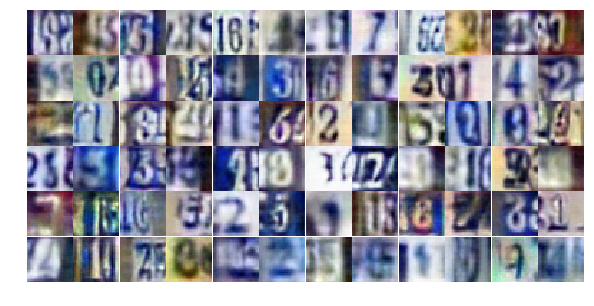

Epoch 24/25... Discriminator Loss: 1.1777... Generator Loss: 0.8862
Epoch 24/25... Discriminator Loss: 1.2312... Generator Loss: 0.8378
Epoch 24/25... Discriminator Loss: 1.1625... Generator Loss: 0.8549
Epoch 24/25... Discriminator Loss: 1.2152... Generator Loss: 0.8904
Epoch 24/25... Discriminator Loss: 1.1992... Generator Loss: 0.8218
Epoch 24/25... Discriminator Loss: 1.1878... Generator Loss: 0.8204
Epoch 24/25... Discriminator Loss: 1.2703... Generator Loss: 0.9201
Epoch 24/25... Discriminator Loss: 1.0993... Generator Loss: 0.7832
Epoch 24/25... Discriminator Loss: 1.1816... Generator Loss: 0.8282
Epoch 24/25... Discriminator Loss: 0.9984... Generator Loss: 0.8713


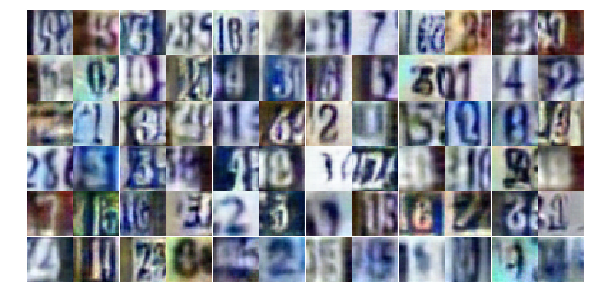

Epoch 24/25... Discriminator Loss: 1.1959... Generator Loss: 0.7975
Epoch 24/25... Discriminator Loss: 1.2662... Generator Loss: 0.6723
Epoch 24/25... Discriminator Loss: 1.1316... Generator Loss: 0.8799
Epoch 24/25... Discriminator Loss: 1.2746... Generator Loss: 0.8156
Epoch 24/25... Discriminator Loss: 1.1773... Generator Loss: 0.8096
Epoch 24/25... Discriminator Loss: 1.2511... Generator Loss: 0.7289
Epoch 24/25... Discriminator Loss: 1.1203... Generator Loss: 0.8976
Epoch 24/25... Discriminator Loss: 1.1703... Generator Loss: 0.7062
Epoch 24/25... Discriminator Loss: 1.1706... Generator Loss: 0.8597
Epoch 24/25... Discriminator Loss: 1.2229... Generator Loss: 0.8455


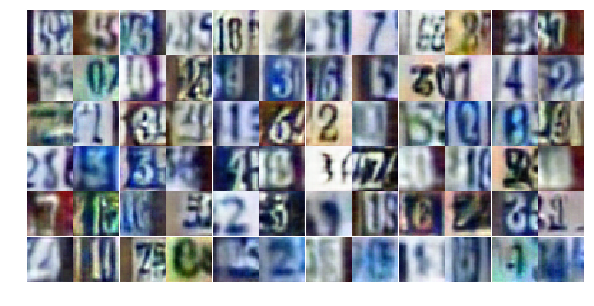

Epoch 24/25... Discriminator Loss: 1.1501... Generator Loss: 0.9136
Epoch 24/25... Discriminator Loss: 1.1990... Generator Loss: 0.8673
Epoch 24/25... Discriminator Loss: 1.0769... Generator Loss: 0.8843
Epoch 24/25... Discriminator Loss: 1.1371... Generator Loss: 0.8172
Epoch 24/25... Discriminator Loss: 1.1256... Generator Loss: 0.7545
Epoch 24/25... Discriminator Loss: 1.2212... Generator Loss: 0.8854
Epoch 24/25... Discriminator Loss: 1.1691... Generator Loss: 0.9560
Epoch 24/25... Discriminator Loss: 1.0892... Generator Loss: 0.9315
Epoch 24/25... Discriminator Loss: 1.1812... Generator Loss: 0.9344
Epoch 24/25... Discriminator Loss: 1.0927... Generator Loss: 0.8489


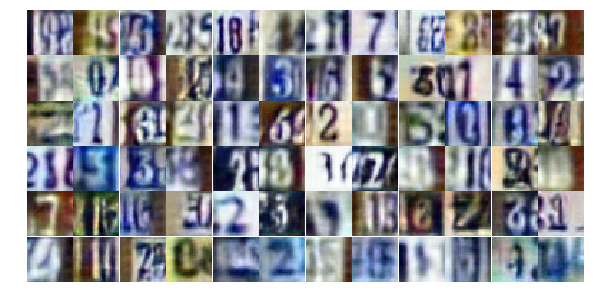

Epoch 24/25... Discriminator Loss: 1.1309... Generator Loss: 0.9431
Epoch 24/25... Discriminator Loss: 1.0845... Generator Loss: 0.9898
Epoch 24/25... Discriminator Loss: 1.2303... Generator Loss: 0.7614
Epoch 24/25... Discriminator Loss: 1.1938... Generator Loss: 0.7271
Epoch 24/25... Discriminator Loss: 1.2315... Generator Loss: 0.8405
Epoch 24/25... Discriminator Loss: 1.2509... Generator Loss: 0.8743
Epoch 24/25... Discriminator Loss: 1.2294... Generator Loss: 0.9009
Epoch 24/25... Discriminator Loss: 1.2131... Generator Loss: 0.7934
Epoch 24/25... Discriminator Loss: 1.2009... Generator Loss: 0.8125
Epoch 24/25... Discriminator Loss: 1.1423... Generator Loss: 0.7969


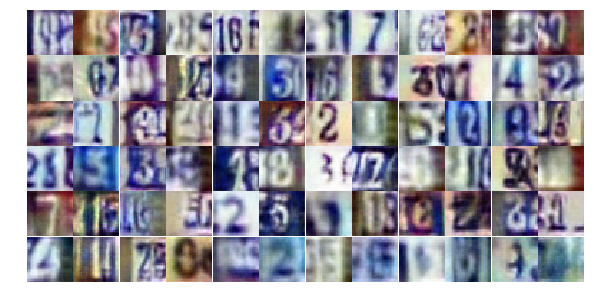

Epoch 24/25... Discriminator Loss: 1.2181... Generator Loss: 0.7953
Epoch 24/25... Discriminator Loss: 1.1281... Generator Loss: 0.9289
Epoch 24/25... Discriminator Loss: 1.2351... Generator Loss: 0.7787
Epoch 24/25... Discriminator Loss: 1.1570... Generator Loss: 0.8527
Epoch 24/25... Discriminator Loss: 1.1408... Generator Loss: 0.9006
Epoch 24/25... Discriminator Loss: 1.1101... Generator Loss: 0.8344
Epoch 24/25... Discriminator Loss: 1.2243... Generator Loss: 0.8181
Epoch 24/25... Discriminator Loss: 1.1939... Generator Loss: 0.8107
Epoch 24/25... Discriminator Loss: 1.2082... Generator Loss: 0.8652
Epoch 24/25... Discriminator Loss: 1.2005... Generator Loss: 0.9599


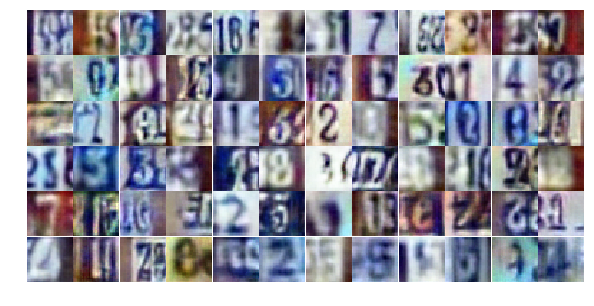

Epoch 24/25... Discriminator Loss: 1.2045... Generator Loss: 0.8544
Epoch 24/25... Discriminator Loss: 1.2005... Generator Loss: 0.8934
Epoch 24/25... Discriminator Loss: 1.2259... Generator Loss: 0.7076
Epoch 24/25... Discriminator Loss: 1.2033... Generator Loss: 0.8963
Epoch 24/25... Discriminator Loss: 1.2146... Generator Loss: 0.8154
Epoch 25/25... Discriminator Loss: 1.0522... Generator Loss: 0.9924
Epoch 25/25... Discriminator Loss: 1.0885... Generator Loss: 0.8963
Epoch 25/25... Discriminator Loss: 1.1695... Generator Loss: 0.8898
Epoch 25/25... Discriminator Loss: 1.1306... Generator Loss: 0.9337
Epoch 25/25... Discriminator Loss: 1.1734... Generator Loss: 0.8095


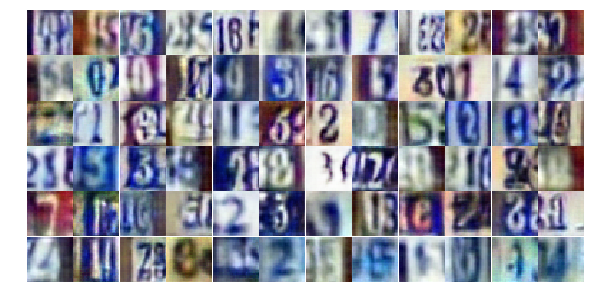

Epoch 25/25... Discriminator Loss: 1.0839... Generator Loss: 0.8439
Epoch 25/25... Discriminator Loss: 1.1928... Generator Loss: 0.8006
Epoch 25/25... Discriminator Loss: 1.2181... Generator Loss: 0.9003
Epoch 25/25... Discriminator Loss: 1.1845... Generator Loss: 0.9683
Epoch 25/25... Discriminator Loss: 1.1327... Generator Loss: 0.8315
Epoch 25/25... Discriminator Loss: 1.2628... Generator Loss: 0.7061
Epoch 25/25... Discriminator Loss: 1.2148... Generator Loss: 0.7856
Epoch 25/25... Discriminator Loss: 1.1534... Generator Loss: 0.8664
Epoch 25/25... Discriminator Loss: 1.0455... Generator Loss: 0.9888
Epoch 25/25... Discriminator Loss: 1.1360... Generator Loss: 0.8244


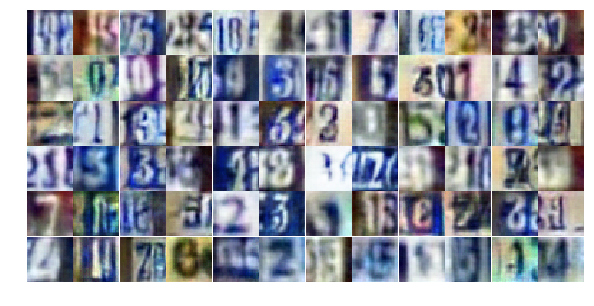

Epoch 25/25... Discriminator Loss: 1.1621... Generator Loss: 0.8594
Epoch 25/25... Discriminator Loss: 1.1894... Generator Loss: 0.8457
Epoch 25/25... Discriminator Loss: 1.0657... Generator Loss: 0.9433
Epoch 25/25... Discriminator Loss: 1.2642... Generator Loss: 0.8478
Epoch 25/25... Discriminator Loss: 1.1702... Generator Loss: 0.8467
Epoch 25/25... Discriminator Loss: 1.1846... Generator Loss: 0.8543
Epoch 25/25... Discriminator Loss: 1.2023... Generator Loss: 0.9359
Epoch 25/25... Discriminator Loss: 1.2715... Generator Loss: 0.7762
Epoch 25/25... Discriminator Loss: 1.1856... Generator Loss: 0.8816
Epoch 25/25... Discriminator Loss: 1.1221... Generator Loss: 0.8818


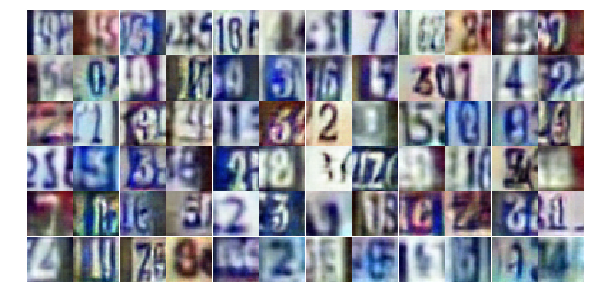

Epoch 25/25... Discriminator Loss: 1.1730... Generator Loss: 0.8097
Epoch 25/25... Discriminator Loss: 1.1796... Generator Loss: 0.8745
Epoch 25/25... Discriminator Loss: 1.2092... Generator Loss: 0.8516
Epoch 25/25... Discriminator Loss: 1.1371... Generator Loss: 0.9195
Epoch 25/25... Discriminator Loss: 1.1510... Generator Loss: 0.7912
Epoch 25/25... Discriminator Loss: 1.1338... Generator Loss: 0.9771
Epoch 25/25... Discriminator Loss: 1.2159... Generator Loss: 0.8026
Epoch 25/25... Discriminator Loss: 1.1018... Generator Loss: 0.9116
Epoch 25/25... Discriminator Loss: 1.1909... Generator Loss: 0.7902
Epoch 25/25... Discriminator Loss: 1.1318... Generator Loss: 0.8167


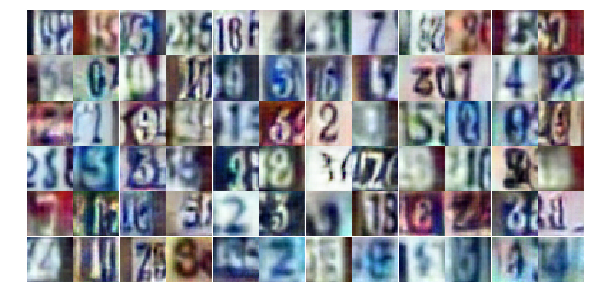

Epoch 25/25... Discriminator Loss: 1.2358... Generator Loss: 0.8522
Epoch 25/25... Discriminator Loss: 1.1566... Generator Loss: 0.7976
Epoch 25/25... Discriminator Loss: 1.2195... Generator Loss: 0.8428
Epoch 25/25... Discriminator Loss: 1.1200... Generator Loss: 0.8741
Epoch 25/25... Discriminator Loss: 1.1843... Generator Loss: 0.8273
Epoch 25/25... Discriminator Loss: 1.2029... Generator Loss: 0.9838
Epoch 25/25... Discriminator Loss: 1.1668... Generator Loss: 0.8630
Epoch 25/25... Discriminator Loss: 1.1646... Generator Loss: 0.7908
Epoch 25/25... Discriminator Loss: 1.1795... Generator Loss: 0.8056
Epoch 25/25... Discriminator Loss: 1.0851... Generator Loss: 1.0593


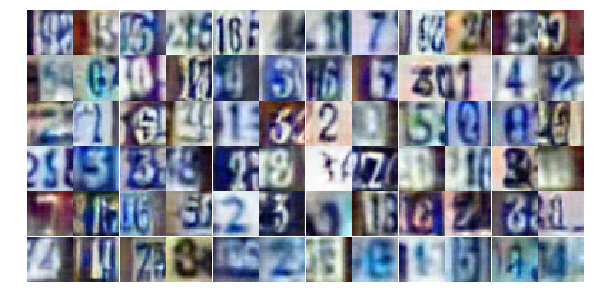

Epoch 25/25... Discriminator Loss: 1.1629... Generator Loss: 0.8286
Epoch 25/25... Discriminator Loss: 1.1480... Generator Loss: 0.8625
Epoch 25/25... Discriminator Loss: 1.2081... Generator Loss: 0.8358
Epoch 25/25... Discriminator Loss: 1.2274... Generator Loss: 0.9930
Epoch 25/25... Discriminator Loss: 1.1489... Generator Loss: 0.9311
Epoch 25/25... Discriminator Loss: 1.1623... Generator Loss: 0.8453
Epoch 25/25... Discriminator Loss: 1.1595... Generator Loss: 0.8430
Epoch 25/25... Discriminator Loss: 1.2486... Generator Loss: 0.7575
Epoch 25/25... Discriminator Loss: 1.2144... Generator Loss: 0.8989
Epoch 25/25... Discriminator Loss: 1.1971... Generator Loss: 0.8285


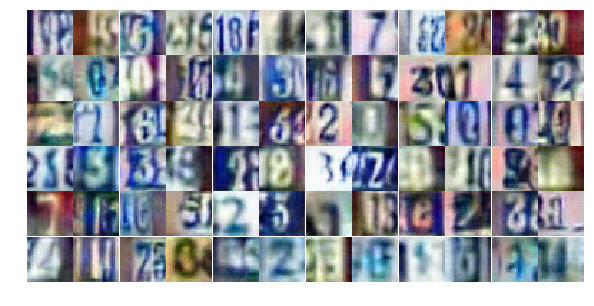

Epoch 25/25... Discriminator Loss: 1.1787... Generator Loss: 0.7725
Epoch 25/25... Discriminator Loss: 1.2292... Generator Loss: 0.7281


In [19]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

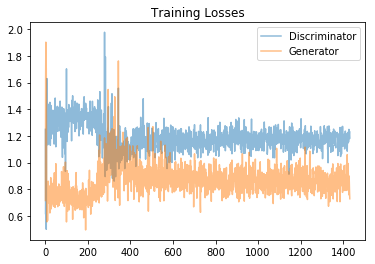

In [20]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

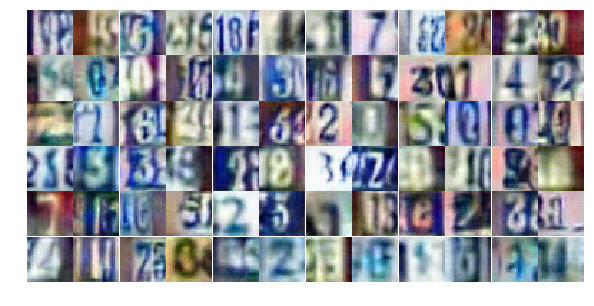

In [21]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))